# NLP Analysis of Disasters on Social Media

Youfei Zhang

*2019/01/01*

## 1 Executive Summary

The abundance of social media data has revolutionazed the way we approach big crisis such as earthquake and floods. On the personal level, people who are at the frontier of those events would take pictures or seek helps on social media. On the public level, government and international organization have been trying to utilize those social media data to make actionable decisions. For example, by analyzing tweets with searches of "earthquake", the government will be able to gain awareness of the emergencies and the urgent needs of people at different locations, and allocate resources accordingly. 

However, there still remains two main challenges when it comes to nalyzing those data: 

* Social media data are messy and contains underlying semantics that are hard to be understood. For instance, a tweet mentioned a disaster could be an emergency or could simply be a joke. 
* Supervised learning models need labeled data and it takes time to be trained. However, in the early hours of a disaster, such kind of labeled data are normally not available. 


## 2 Background




### 2.1 Objective

This project aims to anwer two questions:

- Given a tweet, can we accurately classify it into a real disaster event from the noise?  
- Is it possible to rapidly classify disaster events in a timely manner? 



### 2.2 Dataset Description

The dataset is from [CrisisNLP](http://crisisnlp.qcri.org/lrec2016/lrec2016.html). It contains crisis-related Twitter data about 9 disaster events such as floods, earthquake, typhoon. Each tweet is labeled into 1-8 informative classes by paid workers, with one class of "not related or irrelevant" class. I concatenated and cleaned the raw dataset in "NLP_data_preparation". The dataset at hand now (after concatenation) has 19,112 rows with 4 columns. 

The four disaster events of concerns are:
* Nepal Earthquake (2015)
* Cyclone PAM in Vanuau (2015)
* California Earthquake (2014)
* Typhoon Hagupit in Phillippines (2014)

There are no missing values in this dataset.

In [1]:
# load libaries

import pandas as pd
import numpy as np
import nltk
import re
import codecs

In [14]:
# inspect the raw data

raw = pd.read_csv("data/events.csv")
print(raw.shape)
raw.head()

(19112, 4)


,tweet_id,tweet_text,label,event
0,'591902695562170368',RT @PTI_News: Govt asks media houses to exerci...,other_useful_information,2015_nepal_eq
1,'591902695822331904',#money #news #top #b Magnitude-7.9 quake hits ...,infrastructure_and_utilities_damage,2015_nepal_eq
2,'591902695943843840',RT @ABCNews24: #NepalEarthquake update: The In...,injured_or_dead_people,2015_nepal_eq
3,'591902696371724288',RT @cnni: CNN obtains powerful images of baby ...,missing_trapped_or_found_people,2015_nepal_eq
4,'591902696375877632',My thoughts and prayers to everyone in Nepal.....,sympathy_and_emotional_support,2015_nepal_eq


In [16]:
# quickly look into the lable values

class_label = raw.label.value_counts().rename('num_class').reset_index()
class_label['Percent'] = (class_label.num_class/raw.shape[0])*100
pd.DataFrame(class_label)

,index,num_class,Percent
0,other_useful_information,5729,29.975931
1,donation_needs_or_offers_or_volunteering_services,2610,13.656342
2,injured_or_dead_people,2510,13.133110
3,not_related_or_irrelevant,2345,12.269778
4,sympathy_and_emotional_support,1969,10.302428
5,infrastructure_and_utilities_damage,1851,9.685015
6,caution_and_advice,1063,5.561951
7,displaced_people_and_evacuations,633,3.312055
8,missing_trapped_or_found_people,402,2.103391


,label,% of Count
other_useful_information,5729,29.975931
donation_needs_or_offers_or_volunteering_services,2610,13.656342
injured_or_dead_people,2510,13.133110
not_related_or_irrelevant,2345,12.269778
sympathy_and_emotional_support,1969,10.302428
infrastructure_and_utilities_damage,1851,9.685015
caution_and_advice,1063,5.561951
displaced_people_and_evacuations,633,3.312055
missing_trapped_or_found_people,402,2.103391


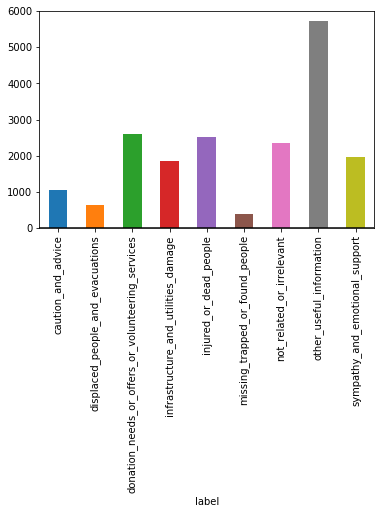

In [17]:
# define a function inspect the distribution of the data

%matplotlib inline
import matplotlib.pyplot as plt

def count_table(df, c):
        count = df[c].value_counts()
        count_percent = 100 * count / len(df)
        count_table = pd.concat([count, count_percent], axis=1)
        
        count_table.columns = [c, '% of Count']
        count_table.round(2)

        gb = df.groupby(df[c])
        targetEDA=gb[c].aggregate(len)
        
        plt.figure()
        targetEDA.plot(kind='bar', grid=False)
        plt.axhline(0, color='k')
        
        return count_table

count_table(raw, 'label')

As we can see from the plot, 'Not related or irrelevant' is the most frequent class. I am going to encode the labels into 1 and 0 later for binary classification purpose. 

,event,% of Count
2015_nepal_eq,3018,15.791126
2013_pakistan_eq,2013,10.532650
2014_pakistan_floods,2013,10.532650
2015_Cyclone_Pam,2013,10.532650
2014_California_Earthquake,2013,10.532650
2014_Hurricane_Odile_Mexico,2013,10.532650
2014_Philippines_Typhoon,2013,10.532650
2014_Chile_Earthquake,2013,10.532650
2014_india_floods,2003,10.480326


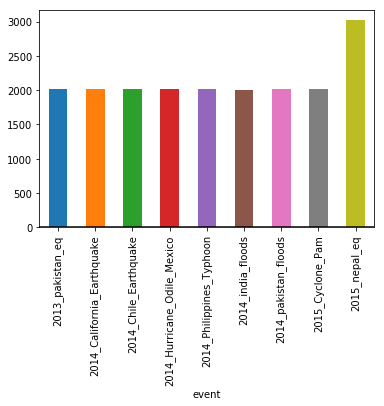

In [18]:
count_table(raw, 'event')

## 3 Data Preprocessing

The item columns contains the raw tweets posted by the users. It is easy to see there are lots of noise when it comes to tweets data. We need to clean and tokenize these tweets to abstract useful information.

There are several issues I need to consider later: 
- 140 charaters tweets normally doesn't provide much context information
- tweets can be ambiguous given people are using informal languages and slangs

Given those issues, I have in mind that I might need to use different processing/tokenizitoin methods to deal with tweets from the methods of dealing with traditional texts. 


### 3.1 Data Cleaning

The cleaning steps is as following: 

1. normalizing to utf-8 
2. lowercasing 
2. Digit -> DDD 
3. URLs -> httpAddress 
4. @username -> userID 
5. Remove special characters, keep ; . ! ? 
6. normalize elongation 

In [2]:
import re, os
import csv
import string 
import twokenize
from collections import defaultdict
import codecs
import unicodedata

In [22]:
# build a container to process the data 
# list works better here than dataframe 

columns = defaultdict(list) # each value in each column is appended to a list

with open("data/events.csv", newline='') as f:
    reader = csv.DictReader(f) # read rows into a dictionary format
    for row in reader: # read a row as {column1: value1, column2: value2,...}
        for (k,v) in row.items(): # go over each column name and value 
            columns[k.strip()].append(v) # append the value into the appropriate list based on column name k

# columns

In [38]:
# define a function to clean the item column 

def clean_text(lst):
    clean_tweet = []
    for tweet in lst:
        print ("[original]", tweet)

        # 1. normalizing utf8 formatting 
        tweet = tweet.encode("utf8").decode("utf8")
#         tweet = tweet.encode("ascii","ignore")
        tweet = tweet.strip(' \t\n\r')
    
        # 2. lowering case 
        tweet = re.sub(' +', ' ', tweet)
        tweet = tweet.lower()
        print ("[lowercase]", tweet)

        # 3. normalizing digits
        tweet_words = tweet.strip('\r').split(' ')
        for word in [word for word in tweet_words if word.isdigit()]:
            tweet = tweet.replace(word, "D" * len(word))
        print ("[digits]", tweet)
        
        # 4. normalizing urls
        tweet_words = tweet.strip('\r').split(' ')
        for word in [word for word in tweet_words if '/' in word or '.' in word and len(word) > 3]:
            tweet = tweet.replace(word, "urls")
        print ("[urls]", tweet)
        
        #5. username 
        tweet_words = tweet.strip('\r').split(' ')
        for word in [word for word in tweet_words if word[0] == '@' and len(word) > 1]:
            tweet = tweet.replace(word, "usrId")
        print ("[username]", tweet)
        
        # 6. special characters
        punc = '#@$%^&*()_+-={}[]:"|\'\~`<>/,'
        trans = str.maketrans(punc, ' '*len(punc))
        tweet = tweet.translate(trans)
        print ("[punctuation]", tweet)
        
        # 7. Normalizing +2 elongated char
        tweet = re.sub(r"(.)\1\1+",r'\1\1', tweet)
        print ("[elong]", tweet)
        
        # 8. fix \n char
        tweet = tweet.replace('\n', ' ')

        clean_tweet.append(tweet.strip())

    return clean_tweet



In [39]:
clean = clean_text(columns['tweet_text']);

[original] RT @PTI_News: Govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in Nepa‰Û_
[lowercase] rt @pti_news: govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in nepa‰û_
[digits] rt @pti_news: govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in nepa‰û_
[urls] rt @pti_news: govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in nepa‰û_
[username] rt usrId govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in nepa‰û_
[punctuation] rt usrId govt asks media houses to exercise restraint while speculating about possible aftershocks after the devastating quake in nepa‰û 
[elong] rt usrId govt asks media houses to exercise restraint while speculating about po

[digits] rt @arjunk26: my friend @rohanshrestha is heading into nepal to him his fellow people show ur support anyway u can http://t.co/yjxzpvmnke
[urls] rt @arjunk26: my friend @rohanshrestha is heading into nepal to him his fellow people show ur support anyway u can urls
[username] rt usrId my friend usrId is heading into nepal to him his fellow people show ur support anyway u can urls
[punctuation] rt usrId my friend usrId is heading into nepal to him his fellow people show ur support anyway u can urls
[elong] rt usrId my friend usrId is heading into nepal to him his fellow people show ur support anyway u can urls
[original] RT @ddlovato: AND please pray for Nepal... #PrayersForNepal ‡__F
[lowercase] rt @ddlovato: and please pray for nepal... #prayersfornepal ‡__f
[digits] rt @ddlovato: and please pray for nepal... #prayersfornepal ‡__f
[urls] rt @ddlovato: and please pray for urls #prayersfornepal ‡__f
[username] rt usrId and please pray for urls #prayersfornepal ‡__f
[punctuation]

[punctuation] rt timesnow  DDD people from maharashtra stranded in nepal are safe  maharashtra cm devendra fadnavis  pti 
[elong] rt timesnow  DD people from maharashtra stranded in nepal are safe  maharashtra cm devendra fadnavis  pti 
[original] India rescues 546 people from Nepal, death toll 1,800: After Nepal was struck by the worst earthquake in 80 ye... http://t.co/okSQeYyxZo
[lowercase] india rescues 546 people from nepal, death toll 1,800: after nepal was struck by the worst earthquake in 80 ye... http://t.co/oksqeyyxzo
[digits] india rescues DDD people from nepal, death toll 1,DD0: after nepal was struck by the worst earthquake in DD ye... http://t.co/oksqeyyxzo
[urls] india rescues DDD people from nepal, death toll 1,DD0: after nepal was struck by the worst earthquake in DD urls urls
[username] india rescues DDD people from nepal, death toll 1,DD0: after nepal was struck by the worst earthquake in DD urls urls
[punctuation] india rescues DDD people from nepal  death toll 1 DD

[punctuation] usrId is govt planning to send relief materials to nepal?appeal to all mumbai citizens to come forward for helping nepal  earthquake
[elong] usrId is govt planning to send relief materials to nepal?appeal to all mumbai citizens to come forward for helping nepal  earthquake
[original] Praying for the people of Nepal ‡__F‡_ÀC hoping they find their loved ones who are missing ‡_Á4
[lowercase] praying for the people of nepal ‡__f‡_àc hoping they find their loved ones who are missing ‡_á4
[digits] praying for the people of nepal ‡__f‡_àc hoping they find their loved ones who are missing ‡_á4
[urls] praying for the people of nepal ‡__f‡_àc hoping they find their loved ones who are missing ‡_á4
[username] praying for the people of nepal ‡__f‡_àc hoping they find their loved ones who are missing ‡_á4
[punctuation] praying for the people of nepal ‡  f‡ àc hoping they find their loved ones who are missing ‡ á4
[elong] praying for the people of nepal ‡  f‡ àc hoping they find their 

[lowercase] death toll from nepal earthquake rises to more than 4,700, with more than 9,000 injured. http://t.co/bzfk4zvzpq.
[digits] death toll from nepal earthquake rises to more than 4,700, with more than 9,000 injured. http://t.co/bzfk4zvzpq.
[urls] death toll from nepal earthquake rises to more than 4,700, with more than 9,000 urls urls
[username] death toll from nepal earthquake rises to more than 4,700, with more than 9,000 urls urls
[punctuation] death toll from nepal earthquake rises to more than 4 700  with more than 9 000 urls urls
[elong] death toll from nepal earthquake rises to more than 4 700  with more than 9 00 urls urls
[original] RT @worldvisioncan: Canadian gov't will match dollar-for-dollar for donations contributed to the #NepalEarthquake. Help now: http://t.co/fk‰Û_
[lowercase] rt @worldvisioncan: canadian gov't will match dollar-for-dollar for donations contributed to the #nepalearthquake. help now: http://t.co/fk‰û_
[digits] rt @worldvisioncan: canadian gov't w

[elong] rt usrId figure skater  kimyuna donates to help young victims of  nepalearthquake urls  prayfornepal urls
[original] RT @BBCBreaking: Woman pulled alive from #NepalEarthquake rubble after more than 5 days trapped alongside bodies in Kathmandu http://t.co/S‰Û_
[lowercase] rt @bbcbreaking: woman pulled alive from #nepalearthquake rubble after more than 5 days trapped alongside bodies in kathmandu http://t.co/s‰û_
[digits] rt @bbcbreaking: woman pulled alive from #nepalearthquake rubble after more than D days trapped alongside bodies in kathmandu http://t.co/s‰û_
[urls] rt @bbcbreaking: woman pulled alive from #nepalearthquake rubble after more than D days trapped alongside bodies in kathmandu urls
[username] rt usrId woman pulled alive from #nepalearthquake rubble after more than D days trapped alongside bodies in kathmandu urls
[punctuation] rt usrId woman pulled alive from  nepalearthquake rubble after more than D days trapped alongside bodies in kathmandu urls
[elong] rt usrId

[username] 'shaken to the core': the earthquake in nepal is sunday's top story, with the papers highlighting missing urls urls
[punctuation]  shaken to the core   the earthquake in nepal is sunday s top story  with the papers highlighting missing urls urls
[elong]  shaken to the core  the earthquake in nepal is sunday s top story  with the papers highlighting missing urls urls
[original] RT @leessangsgfc: Charity Drive for Nepal   https://t.co/VesTXeubNj http://t.co/fUu1YdZfxt
[lowercase] rt @leessangsgfc: charity drive for nepal https://t.co/vestxeubnj http://t.co/fuu1ydzfxt
[digits] rt @leessangsgfc: charity drive for nepal https://t.co/vestxeubnj http://t.co/fuu1ydzfxt
[urls] rt @leessangsgfc: charity drive for nepal urls urls
[username] rt usrId charity drive for nepal urls urls
[punctuation] rt usrId charity drive for nepal urls urls
[elong] rt usrId charity drive for nepal urls urls
[original] T-Mobile makes calling &amp; texting Nepal free, waives bills to aid earthquake relief 

[username] rt usrId mayor usrId is asking #chch residents to dig deep for urls urls time to return the urls urls
[punctuation] rt usrId mayor usrId is asking  chch residents to dig deep for urls urls time to return the urls urls
[elong] rt usrId mayor usrId is asking  chch residents to dig deep for urls urls time to return the urls urls
[original] RT @III_Research: Nepal Earthquake Losses Could Top $2 Billion; Little Insurance Coverage http://t.co/CPgqzbzFrI
[lowercase] rt @iii_research: nepal earthquake losses could top $2 billion; little insurance coverage http://t.co/cpgqzbzfri
[digits] rt @iii_research: nepal earthquake losses could top $2 billion; little insurance coverage http://t.co/cpgqzbzfri
[urls] rt @iii_research: nepal earthquake losses could top $2 billion; little insurance coverage urls
[username] rt usrId nepal earthquake losses could top $2 billion; little insurance coverage urls
[punctuation] rt usrId nepal earthquake losses could top  2 billion; little insurance cover

[lowercase] rt @cnni: breaking: death toll in #nepal after #earthquake stands at 597, spokesman for nepal's ministry of home affairs says. http://t.co/‰û_
[digits] rt @cnni: breaking: death toll in #nepal after #earthquake stands at 597, spokesman for nepal's ministry of home affairs says. http://t.co/‰û_
[urls] rt @cnni: breaking: death toll in #nepal after #earthquake stands at 597, spokesman for nepal's ministry of home affairs urls urls
[username] rt usrId breaking: death toll in #nepal after #earthquake stands at 597, spokesman for nepal's ministry of home affairs urls urls
[punctuation] rt usrId breaking  death toll in  nepal after  earthquake stands at 597  spokesman for nepal s ministry of home affairs urls urls
[elong] rt usrId breaking  death toll in  nepal after  earthquake stands at 597  spokesman for nepal s ministry of home affairs urls urls
[original] Death roll croses 2000 in nepal now #earthquake
[lowercase] death roll croses 2000 in nepal now #earthquake
[digits] deat

[urls] rt @fargo_charism: our thoughts are with nepal - many neighbors are originally from urls D easy ways to contribute to relief efforts: ht‰û_
[username] rt usrId our thoughts are with nepal - many neighbors are originally from urls D easy ways to contribute to relief efforts: ht‰û_
[punctuation] rt usrId our thoughts are with nepal   many neighbors are originally from urls D easy ways to contribute to relief efforts  ht‰û 
[elong] rt usrId our thoughts are with nepal  many neighbors are originally from urls D easy ways to contribute to relief efforts  ht‰û 
[original] RT @BBCR1: Across the @BBC today we're broadcasting a crisis appeal for Nepal #NepalQuake. You can make a donation online.  https://t.co/NL‰Û_
[lowercase] rt @bbcr1: across the @bbc today we're broadcasting a crisis appeal for nepal #nepalquake. you can make a donation online. https://t.co/nl‰û_
[digits] rt @bbcr1: across the @bbc today we're broadcasting a crisis appeal for nepal #nepalquake. you can make a donation

[original] Nepal Earthquake: She Was My Everything, Says a Distraught Father: As he watched Nepalese police rescuers fina... http://t.co/bJuJN6rZ0K
[lowercase] nepal earthquake: she was my everything, says a distraught father: as he watched nepalese police rescuers fina... http://t.co/bjujn6rz0k
[digits] nepal earthquake: she was my everything, says a distraught father: as he watched nepalese police rescuers fina... http://t.co/bjujn6rz0k
[urls] nepal earthquake: she was my everything, says a distraught father: as he watched nepalese police rescuers urls urls
[username] nepal earthquake: she was my everything, says a distraught father: as he watched nepalese police rescuers urls urls
[punctuation] nepal earthquake  she was my everything  says a distraught father  as he watched nepalese police rescuers urls urls
[elong] nepal earthquake  she was my everything  says a distraught father  as he watched nepalese police rescuers urls urls
[original] RT @BBCBreaking: 17 confirmed killed when 

[punctuation] rt usrId death toll from the  nepal earthquake continues to rise; massive relief efforts are under urls please rt. donate now urls
[elong] rt usrId death toll from the  nepal earthquake continues to rise; massive relief efforts are under urls please rt. donate now urls
[original] RT @gauravcsawant: Army sends back Nepali Gorkha soldiers to check on home &amp; help: Maj Gen Ranbir Singh, Addl Dir Gen Mil Ops http://t.co/7‰Û_
[lowercase] rt @gauravcsawant: army sends back nepali gorkha soldiers to check on home &amp; help: maj gen ranbir singh, addl dir gen mil ops http://t.co/7‰û_
[digits] rt @gauravcsawant: army sends back nepali gorkha soldiers to check on home &amp; help: maj gen ranbir singh, addl dir gen mil ops http://t.co/7‰û_
[urls] rt @gauravcsawant: army sends back nepali gorkha soldiers to check on home &amp; help: maj gen ranbir singh, addl dir gen mil ops urls
[username] rt usrId army sends back nepali gorkha soldiers to check on home &amp; help: maj gen ranbi

[digits] rt @mailonline: nation mourns as families hold mass cremations for victims of #nepalquake http://t.co/iyu852gvku http://t.co/nhljddzig6
[urls] rt @mailonline: nation mourns as families hold mass cremations for victims of #nepalquake urls urls
[username] rt usrId nation mourns as families hold mass cremations for victims of #nepalquake urls urls
[punctuation] rt usrId nation mourns as families hold mass cremations for victims of  nepalquake urls urls
[elong] rt usrId nation mourns as families hold mass cremations for victims of  nepalquake urls urls
[original] RT @ShiwaniNeupane: The sadness is sinking in. We have lost our temples, our history, the places we grew up. #NepalEarthquake
[lowercase] rt @shiwanineupane: the sadness is sinking in. we have lost our temples, our history, the places we grew up. #nepalearthquake
[digits] rt @shiwanineupane: the sadness is sinking in. we have lost our temples, our history, the places we grew up. #nepalearthquake
[urls] rt @shiwanineupane:

[urls] so sad that there are places destroyed because of natural disaster, and other places destroyed by its own people #prayfornepal #notbaltimore
[username] so sad that there are places destroyed because of natural disaster, and other places destroyed by its own people #prayfornepal #notbaltimore
[punctuation] so sad that there are places destroyed because of natural disaster  and other places destroyed by its own people  prayfornepal  notbaltimore
[elong] so sad that there are places destroyed because of natural disaster  and other places destroyed by its own people  prayfornepal  notbaltimore
[original] RT @Letterman: Help the survivors of the #NepalQuake by donating to the World Food Programme's emergency relief fund now. http://t.co/CTOZK‰Û_
[lowercase] rt @letterman: help the survivors of the #nepalquake by donating to the world food programme's emergency relief fund now. http://t.co/ctozk‰û_
[digits] rt @letterman: help the survivors of the #nepalquake by donating to the world 

[punctuation] update on the  nepalearthquake all of the children and staff at ama ghar are urls
[elong] update on the  nepalearthquake all of the children and staff at ama ghar are urls
[original] RT @7piliers: Helping Nepalis Abroad Aid Their Families at Home - Dispatch by @Rothna_Begum via @hrw  #NepalEarthquake  http://t.co/U4Z7GyS‰Û_
[lowercase] rt @7piliers: helping nepalis abroad aid their families at home - dispatch by @rothna_begum via @hrw #nepalearthquake http://t.co/u4z7gys‰û_
[digits] rt @7piliers: helping nepalis abroad aid their families at home - dispatch by @rothna_begum via @hrw #nepalearthquake http://t.co/u4z7gys‰û_
[urls] rt @7piliers: helping nepalis abroad aid their families at home - dispatch by @rothna_begum via @hrw #nepalearthquake urls
[username] rt usrId helping nepalis abroad aid their families at home - dispatch by usrId via usrId #nepalearthquake urls
[punctuation] rt usrId helping nepalis abroad aid their families at home   dispatch by usrId via usrId  n

[urls] rt @wfp: we are on the ground in #nepal responding to those affected by urls help us help them urls urls
[username] rt usrId we are on the ground in #nepal responding to those affected by urls help us help them urls urls
[punctuation] rt usrId we are on the ground in  nepal responding to those affected by urls help us help them urls urls
[elong] rt usrId we are on the ground in  nepal responding to those affected by urls help us help them urls urls
[original] There's been a 7.8 earthquake in Nepal. It's very bad. Prayers for them please.
[lowercase] there's been a 7.8 earthquake in nepal. it's very bad. prayers for them please.
[digits] there's been a 7.8 earthquake in nepal. it's very bad. prayers for them please.
[urls] there's been a 7.8 earthquake in urls it's very urls prayers for them urls
[username] there's been a 7.8 earthquake in urls it's very urls prayers for them urls
[punctuation] there s been a 7.8 earthquake in urls it s very urls prayers for them urls
[elong] the

[original] RT @SwearyLady: My backpacking cousin, last heard from on Wednesday as she headed to Kathmandu, has just phoned home. She's safe. Can't des‰Û_
[lowercase] rt @swearylady: my backpacking cousin, last heard from on wednesday as she headed to kathmandu, has just phoned home. she's safe. can't des‰û_
[digits] rt @swearylady: my backpacking cousin, last heard from on wednesday as she headed to kathmandu, has just phoned home. she's safe. can't des‰û_
[urls] rt @swearylady: my backpacking cousin, last heard from on wednesday as she headed to kathmandu, has just phoned urls she's urls can't des‰û_
[username] rt usrId my backpacking cousin, last heard from on wednesday as she headed to kathmandu, has just phoned urls she's urls can't des‰û_
[punctuation] rt usrId my backpacking cousin  last heard from on wednesday as she headed to kathmandu  has just phoned urls she s urls can t des‰û 
[elong] rt usrId my backpacking cousin  last heard from on wednesday as she headed to kathmandu  h

[username] pray for nepal #nepalearthquake ‡_ä5‰ïî‡__a urls
[punctuation] pray for nepal  nepalearthquake ‡ ä5‰ïî‡  a urls
[elong] pray for nepal  nepalearthquake ‡ ä5‰ïî‡  a urls
[original] RT @cgiarclimate: Our thoughts are with projects partners, colleagues &amp; the people of Nepal. We hope all are safe @PACSouthAsia @libirdnepa‰Û_
[lowercase] rt @cgiarclimate: our thoughts are with projects partners, colleagues &amp; the people of nepal. we hope all are safe @pacsouthasia @libirdnepa‰û_
[digits] rt @cgiarclimate: our thoughts are with projects partners, colleagues &amp; the people of nepal. we hope all are safe @pacsouthasia @libirdnepa‰û_
[urls] rt @cgiarclimate: our thoughts are with projects partners, colleagues &amp; the people of urls we hope all are safe @pacsouthasia @libirdnepa‰û_
[username] rt usrId our thoughts are with projects partners, colleagues &amp; the people of urls we hope all are safe usrId usrId
[punctuation] rt usrId our thoughts are with projects partners  c

[original] RT @ShujaRabbani: Top Google executive killed in Nepal quake, 100s of foreign tourists missing ‰ÛÓ RT News http://t.co/wHZYthGZI3 #Nepalquake‰Û_
[lowercase] rt @shujarabbani: top google executive killed in nepal quake, 100s of foreign tourists missing ‰ûó rt news http://t.co/whzythgzi3 #nepalquake‰û_
[digits] rt @shujarabbani: top google executive killed in nepal quake, 100s of foreign tourists missing ‰ûó rt news http://t.co/whzythgzi3 #nepalquake‰û_
[urls] rt @shujarabbani: top google executive killed in nepal quake, 100s of foreign tourists missing ‰ûó rt news urls #nepalquake‰û_
[username] rt usrId top google executive killed in nepal quake, 100s of foreign tourists missing ‰ûó rt news urls #nepalquake‰û_
[punctuation] rt usrId top google executive killed in nepal quake  100s of foreign tourists missing ‰ûó rt news urls  nepalquake‰û 
[elong] rt usrId top google executive killed in nepal quake  100s of foreign tourists missing ‰ûó rt news urls  nepalquake‰û 
[original] R

[urls] #pakistan #dunya quake aftershock of 6.7 magnitude hits nepal: usgs: kathmandu (afp) - a urls aftershock struck urls
[username] #pakistan #dunya quake aftershock of 6.7 magnitude hits nepal: usgs: kathmandu (afp) - a urls aftershock struck urls
[punctuation]  pakistan  dunya quake aftershock of 6.7 magnitude hits nepal  usgs  kathmandu  afp    a urls aftershock struck urls
[elong]  pakistan  dunya quake aftershock of 6.7 magnitude hits nepal  usgs  kathmandu  afp  a urls aftershock struck urls
[original] RT @UPGovt: Pictures of the camp set up to assist the Indians evacuated from Nepal. http://t.co/pbJU6KQpbR
[lowercase] rt @upgovt: pictures of the camp set up to assist the indians evacuated from nepal. http://t.co/pbju6kqpbr
[digits] rt @upgovt: pictures of the camp set up to assist the indians evacuated from nepal. http://t.co/pbju6kqpbr
[urls] rt @upgovt: pictures of the camp set up to assist the indians evacuated from urls urls
[username] rt usrId pictures of the camp set up

[lowercase] rt @meaindia: may kindly note: the helplines numbers in mea control room are for enquiries relating to indian nationals in nepal. (1/2)
[digits] rt @meaindia: may kindly note: the helplines numbers in mea control room are for enquiries relating to indian nationals in nepal. (1/2)
[urls] rt @meaindia: may kindly note: the helplines numbers in mea control room are for enquiries relating to indian nationals in urls urls
[username] rt usrId may kindly note: the helplines numbers in mea control room are for enquiries relating to indian nationals in urls urls
[punctuation] rt usrId may kindly note  the helplines numbers in mea control room are for enquiries relating to indian nationals in urls urls
[elong] rt usrId may kindly note  the helplines numbers in mea control room are for enquiries relating to indian nationals in urls urls
[original] RT @timesofindia: #NepalEarthquake Emergency numbers are +977 4200-250 and +977 4200-105.
[lowercase] rt @timesofindia: #nepalearthquake em

[punctuation] rt usrId climbers are stuck on mt. everest with no way down after nepal earthquake  urls urls
[elong] rt usrId climbers are stuck on mt. everest with no way down after nepal earthquake  urls urls
[original] RT @BreakingNews: Magnitude 6.7 earthquake hits east of Kathmandu, Nepal - USGS http://t.co/mAb0hqkni5
[lowercase] rt @breakingnews: magnitude 6.7 earthquake hits east of kathmandu, nepal - usgs http://t.co/mab0hqkni5
[digits] rt @breakingnews: magnitude 6.7 earthquake hits east of kathmandu, nepal - usgs http://t.co/mab0hqkni5
[urls] rt @breakingnews: magnitude 6.7 earthquake hits east of kathmandu, nepal - usgs urls
[username] rt usrId magnitude 6.7 earthquake hits east of kathmandu, nepal - usgs urls
[punctuation] rt usrId magnitude 6.7 earthquake hits east of kathmandu  nepal   usgs urls
[elong] rt usrId magnitude 6.7 earthquake hits east of kathmandu  nepal  usgs urls
[original] Daily Brief - Same-sex marriage in #US, protests in #Burundi, #Tibetans lost in #Nepal

[punctuation] rt usrId obliterated everest basecamp where at least DD people were buried alive by avalanche after nepal earthquake urls
[elong] rt usrId obliterated everest basecamp where at least DD people were buried alive by avalanche after nepal earthquake urls
[original] RT @UNICEFNZ: The #NepalEarthquake has devastated the region. The children of Nepal need your help urgently: http://t.co/XDrvYl6e9h http://‰Û_
[lowercase] rt @unicefnz: the #nepalearthquake has devastated the region. the children of nepal need your help urgently: http://t.co/xdrvyl6e9h http://‰û_
[digits] rt @unicefnz: the #nepalearthquake has devastated the region. the children of nepal need your help urgently: http://t.co/xdrvyl6e9h http://‰û_
[urls] rt @unicefnz: the #nepalearthquake has devastated the urls the children of nepal need your help urgently: urls urls
[username] rt usrId the #nepalearthquake has devastated the urls the children of nepal need your help urgently: urls urls
[punctuation] rt usrId the  

[elong]  nepalquakerelief  uberaid is arriving now urls
[original] Our Assessment-Team is still at Delhi Airport. The Flight to Kathmandu is delayed. Hope, we can start soon. #NepalQuakeRelief #NepalQuake
[lowercase] our assessment-team is still at delhi airport. the flight to kathmandu is delayed. hope, we can start soon. #nepalquakerelief #nepalquake
[digits] our assessment-team is still at delhi airport. the flight to kathmandu is delayed. hope, we can start soon. #nepalquakerelief #nepalquake
[urls] our assessment-team is still at delhi urls the flight to kathmandu is urls hope, we can start urls #nepalquakerelief #nepalquake
[username] our assessment-team is still at delhi urls the flight to kathmandu is urls hope, we can start urls #nepalquakerelief #nepalquake
[punctuation] our assessment team is still at delhi urls the flight to kathmandu is urls hope  we can start urls  nepalquakerelief  nepalquake
[elong] our assessment team is still at delhi urls the flight to kathmandu is u

[punctuation] rt usrId  nepalquake death toll tops 1 400  according to nepal s national emergency operation urls urls urls
[elong] rt usrId  nepalquake death toll tops 1 400  according to nepal s national emergency operation urls urls urls
[original] RT @UKEQ_Bulletin: One #aftershock at 02:59 NST struck within 10 miles of #Kathmandu ; further quakes could be up to M5 in same area http:/‰Û_
[lowercase] rt @ukeq_bulletin: one #aftershock at 02:59 nst struck within 10 miles of #kathmandu ; further quakes could be up to m5 in same area http:/‰û_
[digits] rt @ukeq_bulletin: one #aftershock at 02:59 nst struck within DD miles of #kathmandu ; further quakes could be up to m5 in same area http:/‰û_
[urls] rt @ukeq_bulletin: one #aftershock at 02:59 nst struck within DD miles of #kathmandu ; further quakes could be up to m5 in same area urls
[username] rt usrId one #aftershock at 02:59 nst struck within DD miles of #kathmandu ; further quakes could be up to m5 in same area urls
[punctuation] r

[username] rt usrId #nepalquake latest: nepalese dig for survivors as toll exceeds 2,200 urls
[punctuation] rt usrId  nepalquake latest  nepalese dig for survivors as toll exceeds 2 200 urls
[elong] rt usrId  nepalquake latest  nepalese dig for survivors as toll exceeds 2 200 urls
[original] 4000+ people dead from the earthquake in Nepal and we have people looting CVS in America.   Hello handbasket...wait, where are we going?
[lowercase] 4000+ people dead from the earthquake in nepal and we have people looting cvs in america. hello handbasket...wait, where are we going?
[digits] 4000+ people dead from the earthquake in nepal and we have people looting cvs in america. hello handbasket...wait, where are we going?
[urls] 4000+ people dead from the earthquake in nepal and we have people looting cvs in urls hello urls where are we going?
[username] 4000+ people dead from the earthquake in nepal and we have people looting cvs in urls hello urls where are we going?
[punctuation] 4000  people 

[punctuation] ‰ûï payussfr  remains a beautiful place and always protected them god  their country will rise from urls amiin ‡ àc  prayfornepal‰û
[elong] ‰ûï payussfr  remains a beautiful place and always protected them god  their country will rise from urls amiin ‡ àc  prayfornepal‰û
[original] RT @TimesNow: India has demonstrated its global leadership in recent weeks, 1st in Yemen &amp; now in Nepal. We're grateful: US Envoy http://t.‰Û_
[lowercase] rt @timesnow: india has demonstrated its global leadership in recent weeks, 1st in yemen &amp; now in nepal. we're grateful: us envoy http://t.‰û_
[digits] rt @timesnow: india has demonstrated its global leadership in recent weeks, 1st in yemen &amp; now in nepal. we're grateful: us envoy http://t.‰û_
[urls] rt @timesnow: india has demonstrated its global leadership in recent weeks, 1st in yemen &amp; now in urls we're grateful: us envoy urls
[username] rt usrId india has demonstrated its global leadership in recent weeks, 1st in yemen 

[punctuation] rt usrId  nepalquake my family is stucked in tato paani in nepal name is aditya bhargava and sanjay bhargava mobi no  9779801122921
[elong] rt usrId  nepalquake my family is stucked in tato paani in nepal name is aditya bhargava and sanjay bhargava mobi no  9779801122921
[original] RT @KendalCalling: @riotjazz have some amazing prints for sale, including from Kendal Calling. All proceeds in aid of #Nepal https://t.co/L‰Û_
[lowercase] rt @kendalcalling: @riotjazz have some amazing prints for sale, including from kendal calling. all proceeds in aid of #nepal https://t.co/l‰û_
[digits] rt @kendalcalling: @riotjazz have some amazing prints for sale, including from kendal calling. all proceeds in aid of #nepal https://t.co/l‰û_
[urls] rt @kendalcalling: @riotjazz have some amazing prints for sale, including from kendal urls all proceeds in aid of #nepal urls
[username] rt usrId usrId have some amazing prints for sale, including from kendal urls all proceeds in aid of #nepal ur

[username] they were enroute to #kathmandu from #raxaul by a urls DD people were travelling in a urls they started at around 10am in the urls
[punctuation] they were enroute to  kathmandu from  raxaul by a urls DD people were travelling in a urls they started at around 10am in the urls
[elong] they were enroute to  kathmandu from  raxaul by a urls DD people were travelling in a urls they started at around 10am in the urls
[original] RT @arunmsk: An Indian in Nepal says Ramdev disappeared in the night without informing. That is his style. Ok. Did he escape in Salwar?
[lowercase] rt @arunmsk: an indian in nepal says ramdev disappeared in the night without informing. that is his style. ok. did he escape in salwar?
[digits] rt @arunmsk: an indian in nepal says ramdev disappeared in the night without informing. that is his style. ok. did he escape in salwar?
[urls] rt @arunmsk: an indian in nepal says ramdev disappeared in the night without urls that is his urls ok. did he escape in salwar?

[urls] urls -- 7.8 magnitude earthquake in nepal (india urls china) -- earthquake unrest obvious http:urlsurlst.courls78q4z6xmq4
[username] urls -- 7.8 magnitude earthquake in nepal (india urls china) -- earthquake unrest obvious http:urlsurlst.courls78q4z6xmq4
[punctuation] urls    7.8 magnitude earthquake in nepal  india urls china     earthquake unrest obvious http urlsurlst.courls78q4z6xmq4
[elong] urls  7.8 magnitude earthquake in nepal  india urls china  earthquake unrest obvious http urlsurlst.courls78q4z6xmq4
[original] Apple opened its first showroom in kathmandu nepal last march 2014 http://t.co/2xd125pqt3 #business #startups
[lowercase] apple opened its first showroom in kathmandu nepal last march 2014 http://t.co/2xd125pqt3 #business #startups
[digits] apple opened its first showroom in kathmandu nepal last march DDDD http://t.co/2xd125pqt3 #business #startups
[urls] apple opened its first showroom in kathmandu nepal last march DDDD urls #business #startups
[username] apple

[punctuation] rt usrId if you have a problem with india helping nepal for whatever reasons   you are a urls no actually the douche is still use‰û 
[elong] rt usrId if you have a problem with india helping nepal for whatever reasons  you are a urls no actually the douche is still use‰û 
[original] RT @thevirdas: We are at 10 Survival Kits for Nepal in just a few hrs :) My goal is 60. Let's get there soon! http://t.co/xJxEeRwoqZ http:/‰Û_
[lowercase] rt @thevirdas: we are at 10 survival kits for nepal in just a few hrs :) my goal is 60. let's get there soon! http://t.co/xjxeerwoqz http:/‰û_
[digits] rt @thevirdas: we are at DD survival kits for nepal in just a few hrs :) my goal is 60. let's get there soon! http://t.co/xjxeerwoqz http:/‰û_
[urls] rt @thevirdas: we are at DD survival kits for nepal in just a few hrs :) my goal is 60. let's get there soon! urls urls
[username] rt usrId we are at DD survival kits for nepal in just a few hrs :) my goal is 60. let's get there soon! urls urls


[digits] rt @neocofficial: helicopter mobilization detail(today): D for okhaldhunga; purpose: relief material distribution
[urls] rt @neocofficial: helicopter mobilization detail(today): D for okhaldhunga; purpose: relief material distribution
[username] rt usrId helicopter mobilization detail(today): D for okhaldhunga; purpose: relief material distribution
[punctuation] rt usrId helicopter mobilization detail today   D for okhaldhunga; purpose  relief material distribution
[elong] rt usrId helicopter mobilization detail today  D for okhaldhunga; purpose  relief material distribution
[original] 12 Things Indians Can Do To HelpåÊNepal http://t.co/Q0vW13KLJW
[lowercase] 12 things indians can do to helpåênepal http://t.co/q0vw13kljw
[digits] DD things indians can do to helpåênepal http://t.co/q0vw13kljw
[urls] DD things indians can do to helpåênepal urls
[username] DD things indians can do to helpåênepal urls
[punctuation] DD things indians can do to helpåênepal urls
[elong] DD things ind

[punctuation] rt usrId nepal fatalities are urls death toll staggering help is needed ask your government to contact the un in your coun‰û 
[elong] rt usrId nepal fatalities are urls death toll staggering help is needed ask your government to contact the un in your coun‰û 
[original] CRAZY I was just thinkin about going to Nepal and they have a massive earthquake...
[lowercase] crazy i was just thinkin about going to nepal and they have a massive earthquake...
[digits] crazy i was just thinkin about going to nepal and they have a massive earthquake...
[urls] crazy i was just thinkin about going to nepal and they have a massive urls
[username] crazy i was just thinkin about going to nepal and they have a massive urls
[punctuation] crazy i was just thinkin about going to nepal and they have a massive urls
[elong] crazy i was just thinkin about going to nepal and they have a massive urls
[original] Riot police battle to contain crowds trying to leave Kathmandu http://t.co/VrRwBMI62j #Civi

[username] boy rescued in kathmandu rubble, many villagers still stranded urls
[punctuation] boy rescued in kathmandu rubble  many villagers still stranded urls
[elong] boy rescued in kathmandu rubble  many villagers still stranded urls
[original] Rescuers in Nepal reach remote communities http://t.co/7KHockNASu
[lowercase] rescuers in nepal reach remote communities http://t.co/7khocknasu
[digits] rescuers in nepal reach remote communities http://t.co/7khocknasu
[urls] rescuers in nepal reach remote communities urls
[username] rescuers in nepal reach remote communities urls
[punctuation] rescuers in nepal reach remote communities urls
[elong] rescuers in nepal reach remote communities urls
[original] #ukip supporters probably in hiding after #NepalEarthquake Since basically they are voting for a party that wants to reduce foreign aid ‡_ãD
[lowercase] #ukip supporters probably in hiding after #nepalearthquake since basically they are voting for a party that wants to reduce foreign aid ‡

[punctuation] please pray and support the people of nepal urls  nepalearthquake  prayfornepal
[elong] please pray and support the people of nepal urls  nepalearthquake  prayfornepal
[original] Was eager to plan a holiday trip to Nepal earlier. Shocked to see the current state of the beautiful nation.Hopefully God will have mercy ‡__F‡_ÀB
[lowercase] was eager to plan a holiday trip to nepal earlier. shocked to see the current state of the beautiful nation.hopefully god will have mercy ‡__f‡_àb
[digits] was eager to plan a holiday trip to nepal earlier. shocked to see the current state of the beautiful nation.hopefully god will have mercy ‡__f‡_àb
[urls] was eager to plan a holiday trip to nepal urls shocked to see the current state of the beautiful urls god will have mercy ‡__f‡_àb
[username] was eager to plan a holiday trip to nepal urls shocked to see the current state of the beautiful urls god will have mercy ‡__f‡_àb
[punctuation] was eager to plan a holiday trip to nepal urls shoc

[elong] let s be strong to rebuild our identity ourselves urls  prayfornepal  nepalearthquake
[original] @78Southy Heard my friends Deepak and irshad  are in red cross camp in nepal, can you please help to locate them
[lowercase] @78southy heard my friends deepak and irshad are in red cross camp in nepal, can you please help to locate them
[digits] @78southy heard my friends deepak and irshad are in red cross camp in nepal, can you please help to locate them
[urls] @78southy heard my friends deepak and irshad are in red cross camp in nepal, can you please help to locate them
[username] usrId heard my friends deepak and irshad are in red cross camp in nepal, can you please help to locate them
[punctuation] usrId heard my friends deepak and irshad are in red cross camp in nepal  can you please help to locate them
[elong] usrId heard my friends deepak and irshad are in red cross camp in nepal  can you please help to locate them
[original] RT @Oikoumene: Please join us in #prayers for #Nep

[punctuation] rt usrId at 12 00pm local time  severe tropical cyclone pam was located about DDD km south of tanna and DD km urls urls
[elong] rt usrId at 12 00pm local time  severe tropical cyclone pam was located about DD km south of tanna and DD km urls urls
[original] Sam Smith - Lay Me Down (Red Nose Day 2015) ft. Jo... =&gt;&gt; http://t.co/ozXe5tEIdU  Timeline #Vanuatu ##xfactornz #‰Û_ http://t.co/ZO4FjKtdBi
[lowercase] sam smith - lay me down (red nose day 2015) ft. jo... =&gt;&gt; http://t.co/ozxe5teidu timeline #vanuatu ##xfactornz #‰û_ http://t.co/zo4fjktdbi
[digits] sam smith - lay me down (red nose day 2015) ft. jo... =&gt;&gt; http://t.co/ozxe5teidu timeline #vanuatu ##xfactornz #‰û_ http://t.co/zo4fjktdbi
[urls] sam smith - lay me down (red nose day 2015) ft. urls =&gt;&gt; urls timeline #vanuatu ##xfactornz #‰û_ urls
[username] sam smith - lay me down (red nose day 2015) ft. urls =&gt;&gt; urls timeline #vanuatu ##xfactornz #‰û_ urls
[punctuation] sam smith   lay me down

[elong] australian cyclone makes landfall  losses strength  sydney  reuters  a åêpowerful tropical cyclone was losing urls urls
[original] Cyclone Pam Leaves Trail of Destruction in Pacific's Vanuatu http://t.co/onIpscUcbH #international
[lowercase] cyclone pam leaves trail of destruction in pacific's vanuatu http://t.co/onipscucbh #international
[digits] cyclone pam leaves trail of destruction in pacific's vanuatu http://t.co/onipscucbh #international
[urls] cyclone pam leaves trail of destruction in pacific's vanuatu urls #international
[username] cyclone pam leaves trail of destruction in pacific's vanuatu urls #international
[punctuation] cyclone pam leaves trail of destruction in pacific s vanuatu urls  international
[elong] cyclone pam leaves trail of destruction in pacific s vanuatu urls  international
[original] RT @UNDP_Pacific: #Vanuatu Gov has demonstrated commitment to ensuring #TCPam response is coordinated &amp; well planned says our Rep #OsnatLub‰Û_
[lowercase] rt @undp_

[username] rt usrId in 2nd place at the f1 in schools uk national finals urls cyclone racing! #f1inschoolsuk #f1inschoolswf urls
[punctuation] rt usrId in 2nd place at the f1 in schools uk national finals urls cyclone racing!  f1inschoolsuk  f1inschoolswf urls
[elong] rt usrId in 2nd place at the f1 in schools uk national finals urls cyclone racing!  f1inschoolsuk  f1inschoolswf urls
[original] RT @SavetheChildren: About 500 schools in #Vanuatu were damaged during #CyclonePam, but today a handful of schools are‰Û_ https://t.co/RYspvB‰Û_
[lowercase] rt @savethechildren: about 500 schools in #vanuatu were damaged during #cyclonepam, but today a handful of schools are‰û_ https://t.co/ryspvb‰û_
[digits] rt @savethechildren: about DDD schools in #vanuatu were damaged during #cyclonepam, but today a handful of schools are‰û_ https://t.co/ryspvb‰û_
[urls] rt @savethechildren: about DDD schools in #vanuatu were damaged during #cyclonepam, but today a handful of schools are‰û_ urls
[username] r

[urls] donate to red cross to help urls urls
[username] donate to red cross to help urls urls
[punctuation] donate to red cross to help urls urls
[elong] donate to red cross to help urls urls
[original] RT @climatechange_a: Cyclone Pam: 24 confirmed dead as Vanuatu president blames climate change - The Guardian http://t.co/mwRUvbk8fJ #Clima‰Û_
[lowercase] rt @climatechange_a: cyclone pam: 24 confirmed dead as vanuatu president blames climate change - the guardian http://t.co/mwruvbk8fj #clima‰û_
[digits] rt @climatechange_a: cyclone pam: DD confirmed dead as vanuatu president blames climate change - the guardian http://t.co/mwruvbk8fj #clima‰û_
[urls] rt @climatechange_a: cyclone pam: DD confirmed dead as vanuatu president blames climate change - the guardian urls #clima‰û_
[username] rt usrId cyclone pam: DD confirmed dead as vanuatu president blames climate change - the guardian urls #clima‰û_
[punctuation] rt usrId cyclone pam  DD confirmed dead as vanuatu president blames climate c

[username] rt usrId on the island of tanna in urls after a cyclone last weekend, aid is slowly arriving urls urls
[punctuation] rt usrId on the island of tanna in urls after a cyclone last weekend  aid is slowly arriving urls urls
[elong] rt usrId on the island of tanna in urls after a cyclone last weekend  aid is slowly arriving urls urls
[original] As Cyclone Pam Devastates Vanuatu, Climate Experts Sound Alarm:  http://t.co/IsVgjQMcxH #world @commondreams
[lowercase] as cyclone pam devastates vanuatu, climate experts sound alarm: http://t.co/isvgjqmcxh #world @commondreams
[digits] as cyclone pam devastates vanuatu, climate experts sound alarm: http://t.co/isvgjqmcxh #world @commondreams
[urls] as cyclone pam devastates vanuatu, climate experts sound alarm: urls #world @commondreams
[username] as cyclone pam devastates vanuatu, climate experts sound alarm: urls #world usrId
[punctuation] as cyclone pam devastates vanuatu  climate experts sound alarm  urls  world usrId
[elong] as cycl

[urls] how to pronounce george tenet - it's greek week DD #vanuatu #rollingstones #euro urls
[username] how to pronounce george tenet - it's greek week DD #vanuatu #rollingstones #euro urls
[punctuation] how to pronounce george tenet   it s greek week DD  vanuatu  rollingstones  euro urls
[elong] how to pronounce george tenet  it s greek week DD  vanuatu  rollingstones  euro urls
[original] Liar MT"@billmckibben: AP: Vanuatu cyclone tragedy "driving home the risks of climate change" for the world's poor http://t.co/UbTWIgAKmY"
[lowercase] liar mt"@billmckibben: ap: vanuatu cyclone tragedy "driving home the risks of climate change" for the world's poor http://t.co/ubtwigakmy"
[digits] liar mt"@billmckibben: ap: vanuatu cyclone tragedy "driving home the risks of climate change" for the world's poor http://t.co/ubtwigakmy"
[urls] liar mt"@billmckibben: ap: vanuatu cyclone tragedy "driving home the risks of climate change" for the world's poor urls
[username] liar mt"@billmckibben: ap: van

[original] RT @FULLY_BADASS: @SleepyPenguin1 @iankatz1000 @simonjenkins4 Wonder how many AK47s supplied by MI6+CIA under Operation Cyclone are still b‰Û_
[lowercase] rt @fully_badass: @sleepypenguin1 @iankatz1000 @simonjenkins4 wonder how many ak47s supplied by mi6+cia under operation cyclone are still b‰û_
[digits] rt @fully_badass: @sleepypenguin1 @iankatz1000 @simonjenkins4 wonder how many ak47s supplied by mi6+cia under operation cyclone are still b‰û_
[urls] rt @fully_badass: @sleepypenguin1 @iankatz1000 @simonjenkins4 wonder how many ak47s supplied by mi6+cia under operation cyclone are still b‰û_
[username] rt usrId usrId usrId usrId wonder how many ak47s supplied by mi6+cia under operation cyclone are still b‰û_
[punctuation] rt usrId usrId usrId usrId wonder how many ak47s supplied by mi6 cia under operation cyclone are still b‰û 
[elong] rt usrId usrId usrId usrId wonder how many ak47s supplied by mi6 cia under operation cyclone are still b‰û 
[original] Looking forward to a 

[digits] rt @huffpostedu: here's how you can help the thousands of displaced victims of #cyclonepam http://t.co/1rbmdzqdmj
[urls] rt @huffpostedu: here's how you can help the thousands of displaced victims of #cyclonepam urls
[username] rt usrId here's how you can help the thousands of displaced victims of #cyclonepam urls
[punctuation] rt usrId here s how you can help the thousands of displaced victims of  cyclonepam urls
[elong] rt usrId here s how you can help the thousands of displaced victims of  cyclonepam urls
[original] Developed nations have sown the wind, Vanuatu has reaped the whirlwind | Andrew Simms #keepitintheground http://t.co/pDpsSRuOKH
[lowercase] developed nations have sown the wind, vanuatu has reaped the whirlwind | andrew simms #keepitintheground http://t.co/pdpssruokh
[digits] developed nations have sown the wind, vanuatu has reaped the whirlwind | andrew simms #keepitintheground http://t.co/pdpssruokh
[urls] developed nations have sown the wind, vanuatu has reap

[digits] rt @anthonyfarnell: great network of webcams from #vanuatu as #cyclonepam approaches. http://t.co/cxt36qji30 http://t.co/zua7nfl9fg
[urls] rt @anthonyfarnell: great network of webcams from #vanuatu as #cyclonepam urls urls urls
[username] rt usrId great network of webcams from #vanuatu as #cyclonepam urls urls urls
[punctuation] rt usrId great network of webcams from  vanuatu as  cyclonepam urls urls urls
[elong] rt usrId great network of webcams from  vanuatu as  cyclonepam urls urls urls
[original] RT @350: We got an overnight update from Vanuatu on Cyclone Pam #TCPam. Thanks Isso! http://t.co/WKDxVVckpy (pic @teoumagirl) http://t.co/U‰Û_
[lowercase] rt @350: we got an overnight update from vanuatu on cyclone pam #tcpam. thanks isso! http://t.co/wkdxvvckpy (pic @teoumagirl) http://t.co/u‰û_
[digits] rt @350: we got an overnight update from vanuatu on cyclone pam #tcpam. thanks isso! http://t.co/wkdxvvckpy (pic @teoumagirl) http://t.co/u‰û_
[urls] rt @350: we got an overnight

[elong] usrId dinner with pam s family
[original] @pammcf6 thank you pam ily
[lowercase] @pammcf6 thank you pam ily
[digits] @pammcf6 thank you pam ily
[urls] @pammcf6 thank you pam ily
[username] usrId thank you pam ily
[punctuation] usrId thank you pam ily
[elong] usrId thank you pam ily
[original] RT @SputnikInt: #UN Humanitarian Office Sends Assessment Team to Cyclone-Hit #Vanuatu http://t.co/lLWZJCLu7y http://t.co/mGMAaIvH9q
[lowercase] rt @sputnikint: #un humanitarian office sends assessment team to cyclone-hit #vanuatu http://t.co/llwzjclu7y http://t.co/mgmaaivh9q
[digits] rt @sputnikint: #un humanitarian office sends assessment team to cyclone-hit #vanuatu http://t.co/llwzjclu7y http://t.co/mgmaaivh9q
[urls] rt @sputnikint: #un humanitarian office sends assessment team to cyclone-hit #vanuatu urls urls
[username] rt usrId #un humanitarian office sends assessment team to cyclone-hit #vanuatu urls urls
[punctuation] rt usrId  un humanitarian office sends assessment team to cyclon

[elong] joints!  disco  superbreak  brazil  pele urls
[original] HLN:  Pam Grier on being with Richard Pryor https://t.co/UVHPolyXJZ
[lowercase] hln: pam grier on being with richard pryor https://t.co/uvhpolyxjz
[digits] hln: pam grier on being with richard pryor https://t.co/uvhpolyxjz
[urls] hln: pam grier on being with richard pryor urls
[username] hln: pam grier on being with richard pryor urls
[punctuation] hln  pam grier on being with richard pryor urls
[elong] hln  pam grier on being with richard pryor urls
[original] Great Barrier Reef reserves protected fish from cyclone http://t.co/SbezCDrvWy
[lowercase] great barrier reef reserves protected fish from cyclone http://t.co/sbezcdrvwy
[digits] great barrier reef reserves protected fish from cyclone http://t.co/sbezcdrvwy
[urls] great barrier reef reserves protected fish from cyclone urls
[username] great barrier reef reserves protected fish from cyclone urls
[punctuation] great barrier reef reserves protected fish from cyclone u

[original] @naturebox hey how do we make http://t.co/VzMev5Muxo a thing
[lowercase] @naturebox hey how do we make http://t.co/vzmev5muxo a thing
[digits] @naturebox hey how do we make http://t.co/vzmev5muxo a thing
[urls] @naturebox hey how do we make urls a thing
[username] usrId hey how do we make urls a thing
[punctuation] usrId hey how do we make urls a thing
[elong] usrId hey how do we make urls a thing
[original] Cyclone flattened the landscape in Vanuatu's outer islands (Arizona Daily Star) http://t.co/1LDA94XjLt #$3peryea‰Û_ http://t.co/WvR4NT4UY6
[lowercase] cyclone flattened the landscape in vanuatu's outer islands (arizona daily star) http://t.co/1lda94xjlt #$3peryea‰û_ http://t.co/wvr4nt4uy6
[digits] cyclone flattened the landscape in vanuatu's outer islands (arizona daily star) http://t.co/1lda94xjlt #$3peryea‰û_ http://t.co/wvr4nt4uy6
[urls] cyclone flattened the landscape in vanuatu's outer islands (arizona daily star) urls #$3peryea‰û_ urls
[username] cyclone flattened 

[urls] rt @kenringweather: earthquake risks for north island heighten with passing of urls urls the urls shake today in luganville, vanuatu‰û_
[username] rt usrId earthquake risks for north island heighten with passing of urls urls the urls shake today in luganville, vanuatu‰û_
[punctuation] rt usrId earthquake risks for north island heighten with passing of urls urls the urls shake today in luganville  vanuatu‰û 
[elong] rt usrId earthquake risks for north island heighten with passing of urls urls the urls shake today in luganville  vanuatu‰û 
[original] RT @johnspatricc: åÈ http://t.co/BDmElckU8J Vanuatu #Vanuatu Tropical Cyclone Pam: Australian officials locate five missing volunteers ‰Û_ htt‰Û_
[lowercase] rt @johnspatricc: åè http://t.co/bdmelcku8j vanuatu #vanuatu tropical cyclone pam: australian officials locate five missing volunteers ‰û_ htt‰û_
[digits] rt @johnspatricc: åè http://t.co/bdmelcku8j vanuatu #vanuatu tropical cyclone pam: australian officials locate five missing v

[username] cancel port maning urls #cyclonepam
[punctuation] cancel port maning urls  cyclonepam
[elong] cancel port maning urls  cyclonepam
[original] Vanuatu's climate minister inspects cyclone Pam damage http://t.co/yIzhroEMJW [Videos http://t.co/CHKI6iaoOc ] #video
[lowercase] vanuatu's climate minister inspects cyclone pam damage http://t.co/yizhroemjw [videos http://t.co/chki6iaooc ] #video
[digits] vanuatu's climate minister inspects cyclone pam damage http://t.co/yizhroemjw [videos http://t.co/chki6iaooc ] #video
[urls] vanuatu's climate minister inspects cyclone pam damage urls [videos urls ] #video
[username] vanuatu's climate minister inspects cyclone pam damage urls [videos urls ] #video
[punctuation] vanuatu s climate minister inspects cyclone pam damage urls  videos urls    video
[elong] vanuatu s climate minister inspects cyclone pam damage urls  videos urls  video
[original] RT @OxfamAustralia: OxfaminVanuatu Country Director @Colincvr is in Vanuatu, bracing the storms.

[urls] @hollyw900 good night pam sorry i missed you urls
[username] usrId good night pam sorry i missed you urls
[punctuation] usrId good night pam sorry i missed you urls
[elong] usrId good night pam sorry i missed you urls
[original] We updated https://t.co/UbnFvvwplw , some networks down still. To offer telecomms help: https://t.co/aA1LzbZvaa http://t.co/5ymixnHYTe
[lowercase] we updated https://t.co/ubnfvvwplw , some networks down still. to offer telecomms help: https://t.co/aa1lzbzvaa http://t.co/5ymixnhyte
[digits] we updated https://t.co/ubnfvvwplw , some networks down still. to offer telecomms help: https://t.co/aa1lzbzvaa http://t.co/5ymixnhyte
[urls] we updated urls , some networks down urls to offer telecomms help: urls urls
[username] we updated urls , some networks down urls to offer telecomms help: urls urls
[punctuation] we updated urls   some networks down urls to offer telecomms help  urls urls
[elong] we updated urls  some networks down urls to offer telecomms help  u

[digits] rt @nasahurricane: so pacific ocean *full update* rapidscat eyes ex-tropical cyclone pam's winds near chatham island a storm... http://t.‰û_
[urls] rt @nasahurricane: so pacific ocean *full update* rapidscat eyes ex-tropical cyclone pam's winds near chatham island a urls urls
[username] rt usrId so pacific ocean *full update* rapidscat eyes ex-tropical cyclone pam's winds near chatham island a urls urls
[punctuation] rt usrId so pacific ocean  full update  rapidscat eyes ex tropical cyclone pam s winds near chatham island a urls urls
[elong] rt usrId so pacific ocean  full update  rapidscat eyes ex tropical cyclone pam s winds near chatham island a urls urls
[original] Watch now, Cyclone (1978) Full Movie in HD at http://t.co/tBlsWVba5J #MyExIn5Words #movie #film #classic http://t.co/1UwP1Jsraj
[lowercase] watch now, cyclone (1978) full movie in hd at http://t.co/tblswvba5j #myexin5words #movie #film #classic http://t.co/1uwp1jsraj
[digits] watch now, cyclone (1978) full movie

[username] cyclone nathan moves away from coast as heavy rain continues
[punctuation] cyclone nathan moves away from coast as heavy rain continues
[elong] cyclone nathan moves away from coast as heavy rain continues
[original] After the story: What the cyclone did to Vanuatu http://t.co/0rXrEn573J
[lowercase] after the story: what the cyclone did to vanuatu http://t.co/0rxren573j
[digits] after the story: what the cyclone did to vanuatu http://t.co/0rxren573j
[urls] after the story: what the cyclone did to vanuatu urls
[username] after the story: what the cyclone did to vanuatu urls
[punctuation] after the story  what the cyclone did to vanuatu urls
[elong] after the story  what the cyclone did to vanuatu urls
[original] RT @VikaWaradi: Calling for volunteers here in Suva, Fiji - PLEASE contact @UNICEFPacific we need help packing emergency supplies to send t‰Û_
[lowercase] rt @vikawaradi: calling for volunteers here in suva, fiji - please contact @unicefpacific we need help packing eme

[original] RT @abcnewsPerth: Power and water finally restored in Carnarvon, 3 days after Tropical Cyclone Olwyn ripped through town http://t.co/lsvYQ5‰Û_
[lowercase] rt @abcnewsperth: power and water finally restored in carnarvon, 3 days after tropical cyclone olwyn ripped through town http://t.co/lsvyq5‰û_
[digits] rt @abcnewsperth: power and water finally restored in carnarvon, D days after tropical cyclone olwyn ripped through town http://t.co/lsvyq5‰û_
[urls] rt @abcnewsperth: power and water finally restored in carnarvon, D days after tropical cyclone olwyn ripped through town urls
[username] rt usrId power and water finally restored in carnarvon, D days after tropical cyclone olwyn ripped through town urls
[punctuation] rt usrId power and water finally restored in carnarvon  D days after tropical cyclone olwyn ripped through town urls
[elong] rt usrId power and water finally restored in carnarvon  D days after tropical cyclone olwyn ripped through town urls
[original] RT @johnspa

[punctuation] cyclone nathan could turn back to queensland coast  brisbane   urls
[elong] cyclone nathan could turn back to queensland coast  brisbane  urls
[original] RT @JuiceBox_20: Great day to be a Cyclone ‰Ï_‡__6
[lowercase] rt @juicebox_20: great day to be a cyclone ‰ï_‡__6
[digits] rt @juicebox_20: great day to be a cyclone ‰ï_‡__6
[urls] rt @juicebox_20: great day to be a cyclone ‰ï_‡__6
[username] rt usrId great day to be a cyclone ‰ï_‡__6
[punctuation] rt usrId great day to be a cyclone ‰ï ‡  6
[elong] rt usrId great day to be a cyclone ‰ï ‡  6
[original] RT @HumanityRoad: #Vanuatu President appeals for international help after Cyclone Pam http://t.co/WZbVC9AWg8 via http://t.co/UAo2d4PNuG #TC‰Û_
[lowercase] rt @humanityroad: #vanuatu president appeals for international help after cyclone pam http://t.co/wzbvc9awg8 via http://t.co/uao2d4pnug #tc‰û_
[digits] rt @humanityroad: #vanuatu president appeals for international help after cyclone pam http://t.co/wzbvc9awg8 via http://

[digits] now: the impact of cyclone pam on the island of vanuatu which has left thousands homeless http://t.co/dn88pzstxv http://t.co/kwbd3vidci
[urls] now: the impact of cyclone pam on the island of vanuatu which has left thousands homeless urls urls
[username] now: the impact of cyclone pam on the island of vanuatu which has left thousands homeless urls urls
[punctuation] now  the impact of cyclone pam on the island of vanuatu which has left thousands homeless urls urls
[elong] now  the impact of cyclone pam on the island of vanuatu which has left thousands homeless urls urls
[original] RT @NewsHour: PHOTOS: Isolated islands thrashed by Cyclone Pam pose challenge to relief efforts http://t.co/E4Hbk7HFm8 http://t.co/oKHxdpt6‰Û_
[lowercase] rt @newshour: photos: isolated islands thrashed by cyclone pam pose challenge to relief efforts http://t.co/e4hbk7hfm8 http://t.co/okhxdpt6‰û_
[digits] rt @newshour: photos: isolated islands thrashed by cyclone pam pose challenge to relief efforts h

[lowercase] 'worst in pacific history': cyclone pam rips through vanuatu: http://t.co/kmckgcozrh http://t.co/3mbyov0lpu
[digits] 'worst in pacific history': cyclone pam rips through vanuatu: http://t.co/kmckgcozrh http://t.co/3mbyov0lpu
[urls] 'worst in pacific history': cyclone pam rips through vanuatu: urls urls
[username] 'worst in pacific history': cyclone pam rips through vanuatu: urls urls
[punctuation]  worst in pacific history   cyclone pam rips through vanuatu  urls urls
[elong]  worst in pacific history  cyclone pam rips through vanuatu  urls urls
[original] RT @johnsondone: @sleepwilk @sammywilk OMG PAM YOU MET HIM. I'M SO HAPPY FOR U AIFJFMIFMFM OMG OMG AJGCDNVIJC YAS
[lowercase] rt @johnsondone: @sleepwilk @sammywilk omg pam you met him. i'm so happy for u aifjfmifmfm omg omg ajgcdnvijc yas
[digits] rt @johnsondone: @sleepwilk @sammywilk omg pam you met him. i'm so happy for u aifjfmifmfm omg omg ajgcdnvijc yas
[urls] rt @johnsondone: @sleepwilk @sammywilk omg pam you met 

[digits] travel to vanuatu (department of foreign affairs and trade - australian government) http://t.co/quchhfooer
[urls] travel to vanuatu (department of foreign affairs and trade - australian government) urls
[username] travel to vanuatu (department of foreign affairs and trade - australian government) urls
[punctuation] travel to vanuatu  department of foreign affairs and trade   australian government  urls
[elong] travel to vanuatu  department of foreign affairs and trade  australian government  urls
[original] Devastation and death after Vanuatu cyclone: http://t.co/0TAjWJWLXi via @ReutersTV
[lowercase] devastation and death after vanuatu cyclone: http://t.co/0tajwjwlxi via @reuterstv
[digits] devastation and death after vanuatu cyclone: http://t.co/0tajwjwlxi via @reuterstv
[urls] devastation and death after vanuatu cyclone: urls via @reuterstv
[username] devastation and death after vanuatu cyclone: urls via usrId
[punctuation] devastation and death after vanuatu cyclone  urls v

[lowercase] like martin do pam bitch get out!
[digits] like martin do pam bitch get out!
[urls] like martin do pam bitch get out!
[username] like martin do pam bitch get out!
[punctuation] like martin do pam bitch get out!
[elong] like martin do pam bitch get out!
[original] Relationship goal is jim and Pam the office season 5/6
[lowercase] relationship goal is jim and pam the office season 5/6
[digits] relationship goal is jim and pam the office season 5/6
[urls] relationship goal is jim and pam the office season urls
[username] relationship goal is jim and pam the office season urls
[punctuation] relationship goal is jim and pam the office season urls
[elong] relationship goal is jim and pam the office season urls
[original] Over 166,000 people affected on #Vanuatu and numbers continue to rise. UK FRA AUS NZ JAP militaries providing support http://t.co/iKMjJKVwIl
[lowercase] over 166,000 people affected on #vanuatu and numbers continue to rise. uk fra aus nz jap militaries providing 

[lowercase] rt @lgumasbatecity: cdrrm update: no reported casualties in #masbatecity #rubyph #masbate
[digits] rt @lgumasbatecity: cdrrm update: no reported casualties in #masbatecity #rubyph #masbate
[urls] rt @lgumasbatecity: cdrrm update: no reported casualties in #masbatecity #rubyph #masbate
[username] rt usrId cdrrm update: no reported casualties in #masbatecity #rubyph #masbate
[punctuation] rt usrId cdrrm update  no reported casualties in  masbatecity  rubyph  masbate
[elong] rt usrId cdrrm update  no reported casualties in  masbatecity  rubyph  masbate
[original] RT @iammarlonramos: Correction: Catbalogan City, Samar province #RubyPH http://t.co/gYZfsHlZvC
[lowercase] rt @iammarlonramos: correction: catbalogan city, samar province #rubyph http://t.co/gyzfshlzvc
[digits] rt @iammarlonramos: correction: catbalogan city, samar province #rubyph http://t.co/gyzfshlzvc
[urls] rt @iammarlonramos: correction: catbalogan city, samar province #rubyph urls
[username] rt usrId correction:

[original] #WalangPasok | Work in govt offices in NCR, Regions IV-A, IV-B suspended; courts in 3 regions closed, too http://t.co/tRXKfyPj3L
[lowercase] #walangpasok | work in govt offices in ncr, regions iv-a, iv-b suspended; courts in 3 regions closed, too http://t.co/trxkfypj3l
[digits] #walangpasok | work in govt offices in ncr, regions iv-a, iv-b suspended; courts in D regions closed, too http://t.co/trxkfypjDl
[urls] #walangpasok | work in govt offices in ncr, regions iv-a, iv-b suspended; courts in D regions closed, too urls
[username] #walangpasok | work in govt offices in ncr, regions iv-a, iv-b suspended; courts in D regions closed, too urls
[punctuation]  walangpasok   work in govt offices in ncr  regions iv a  iv b suspended; courts in D regions closed  too urls
[elong]  walangpasok  work in govt offices in ncr  regions iv a  iv b suspended; courts in D regions closed  too urls
[original] RT @BreaknNews: cnnbrk: At least 21 died in Philippines from Tropical Storm Hagupit, sa

[username] "with DDD total brgys affected by typhoon #rubyph, we recorded some 13,794 total of families affected; urls urls
[punctuation]  with DDD total brgys affected by typhoon  rubyph  we recorded some 13 794 total of families affected; urls urls
[elong]  with DD total brgys affected by typhoon  rubyph  we recorded some 13 794 total of families affected; urls urls
[original] thank you, #Hagupit, for delaying the semester. I HOPE YOU'RE HAPPY WITH YOURSELF.
[lowercase] thank you, #hagupit, for delaying the semester. i hope you're happy with yourself.
[digits] thank you, #hagupit, for delaying the semester. i hope you're happy with yourself.
[urls] thank you, #hagupit, for delaying the urls i hope you're happy with urls
[username] thank you, #hagupit, for delaying the urls i hope you're happy with urls
[punctuation] thank you   hagupit  for delaying the urls i hope you re happy with urls
[elong] thank you  hagupit  for delaying the urls i hope you re happy with urls
[original] #CoolJ

[punctuation] rt usrId urls strong winds pummeling calbayog again  9hours after the we thought the worst was urls  rubyph urls
[elong] rt usrId urls strong winds pummeling calbayog again  9hours after the we thought the worst was urls  rubyph urls
[original] Philippines downgrades Hagupit to depression: Philippine weather bureau downgrades Hagupit to 'tropical depres... http://t.co/oa11hi6QZq
[lowercase] philippines downgrades hagupit to depression: philippine weather bureau downgrades hagupit to 'tropical depres... http://t.co/oa11hi6qzq
[digits] philippines downgrades hagupit to depression: philippine weather bureau downgrades hagupit to 'tropical depres... http://t.co/oa11hi6qzq
[urls] philippines downgrades hagupit to depression: philippine weather bureau downgrades hagupit to 'tropical urls urls
[username] philippines downgrades hagupit to depression: philippine weather bureau downgrades hagupit to 'tropical urls urls
[punctuation] philippines downgrades hagupit to depression  phi

[username] rt usrId #rubyph: areas under state of calamity, december 5, DDDD urls
[punctuation] rt usrId  rubyph  areas under state of calamity  december 5  DDDD urls
[elong] rt usrId  rubyph  areas under state of calamity  december 5  DD urls
[original] RT @DZMMTeleRadyo: #walangpasok Makati, ALL LEVELS, public &amp; private, bukas (Dec. 9) | via @MakatiInfo #RubyPH
[lowercase] rt @dzmmteleradyo: #walangpasok makati, all levels, public &amp; private, bukas (dec. 9) | via @makatiinfo #rubyph
[digits] rt @dzmmteleradyo: #walangpasok makati, all levels, public &amp; private, bukas (dec. 9) | via @makatiinfo #rubyph
[urls] rt @dzmmteleradyo: #walangpasok makati, all levels, public &amp; private, bukas urls 9) | via @makatiinfo #rubyph
[username] rt usrId #walangpasok makati, all levels, public &amp; private, bukas urls 9) | via usrId #rubyph
[punctuation] rt usrId  walangpasok makati  all levels  public  amp; private  bukas urls 9    via usrId  rubyph
[elong] rt usrId  walangpasok makati 

[username] rt usrId save this emergency hotlines to your phone just in urls stay safe, everyone! #rubyph urls
[punctuation] rt usrId save this emergency hotlines to your phone just in urls stay safe  everyone!  rubyph urls
[elong] rt usrId save this emergency hotlines to your phone just in urls stay safe  everyone!  rubyph urls
[original] RT @RozelleBreedt: Hey, @CityPowerJhb , your website is experiencing load shedding... #fml #Eskom #nopower #noschedule #linksareuseless
[lowercase] rt @rozellebreedt: hey, @citypowerjhb , your website is experiencing load shedding... #fml #eskom #nopower #noschedule #linksareuseless
[digits] rt @rozellebreedt: hey, @citypowerjhb , your website is experiencing load shedding... #fml #eskom #nopower #noschedule #linksareuseless
[urls] rt @rozellebreedt: hey, @citypowerjhb , your website is experiencing load urls #fml #eskom #nopower #noschedule #linksareuseless
[username] rt usrId hey, usrId , your website is experiencing load urls #fml #eskom #nopower #

[original] RT @atomaraullo: Power just went out in Calbayog, Samar. Wind steady at around 20kph with gusts #RubyPH #Hagupit
[lowercase] rt @atomaraullo: power just went out in calbayog, samar. wind steady at around 20kph with gusts #rubyph #hagupit
[digits] rt @atomaraullo: power just went out in calbayog, samar. wind steady at around 20kph with gusts #rubyph #hagupit
[urls] rt @atomaraullo: power just went out in calbayog, urls wind steady at around 20kph with gusts #rubyph #hagupit
[username] rt usrId power just went out in calbayog, urls wind steady at around 20kph with gusts #rubyph #hagupit
[punctuation] rt usrId power just went out in calbayog  urls wind steady at around 20kph with gusts  rubyph  hagupit
[elong] rt usrId power just went out in calbayog  urls wind steady at around 20kph with gusts  rubyph  hagupit
[original] I guess our house in Leyte is really designed for bitchy typhoons like #RubyPH
[lowercase] i guess our house in leyte is really designed for bitchy typhoons l

[lowercase] i hear you #rubyph and i could feel you!
[digits] i hear you #rubyph and i could feel you!
[urls] i hear you #rubyph and i could feel you!
[username] i hear you #rubyph and i could feel you!
[punctuation] i hear you  rubyph and i could feel you!
[elong] i hear you  rubyph and i could feel you!
[original] RT @feunrmfOFFICIAL: Classes are still suspended tomorrow, Tuesday, December 09, 2014. Stay safe and dry, NRMF. #walangpasok #RubyPH
[lowercase] rt @feunrmfofficial: classes are still suspended tomorrow, tuesday, december 09, 2014. stay safe and dry, nrmf. #walangpasok #rubyph
[digits] rt @feunrmfofficial: classes are still suspended tomorrow, tuesday, december 09, 2014. stay safe and dry, nrmf. #walangpasok #rubyph
[urls] rt @feunrmfofficial: classes are still suspended tomorrow, tuesday, december 09, urls stay safe and dry, urls #walangpasok #rubyph
[username] rt usrId classes are still suspended tomorrow, tuesday, december 09, urls stay safe and dry, urls #walangpasok #r

[digits] rt @phyzia99: earn 4$ and more for you have singup on the site http://t.co/4wdcxlrdca #asktroye #nevssd #eatenalive #rubyph #mtvstars â€¦
[urls] rt @phyzia99: earn 4$ and more for you have singup on the site urls #asktroye #nevssd #eatenalive #rubyph #mtvstars â€¦
[username] rt usrId earn 4$ and more for you have singup on the site urls #asktroye #nevssd #eatenalive #rubyph #mtvstars â€¦
[punctuation] rt usrId earn 4  and more for you have singup on the site urls  asktroye  nevssd  eatenalive  rubyph  mtvstars â€¦
[elong] rt usrId earn 4  and more for you have singup on the site urls  asktroye  nevssd  eatenalive  rubyph  mtvstars â€¦
[original] RT @faizaoulahsen: The price tag on climate change is high. Thousands on the run for #TyphoonHagupit #Philippines http://t.co/JVI5vgMlyI htâ€¦
[lowercase] rt @faizaoulahsen: the price tag on climate change is high. thousands on the run for #typhoonhagupit #philippines http://t.co/jvi5vgmlyi htâ€¦
[digits] rt @faizaoulahsen: the price t

[original] RT @TheWorldPost: Death toll from Philippines typhoon climbs to 21 http://t.co/s7U6tyee5B
[lowercase] rt @theworldpost: death toll from philippines typhoon climbs to 21 http://t.co/s7u6tyee5b
[digits] rt @theworldpost: death toll from philippines typhoon climbs to DD http://t.co/s7u6tyee5b
[urls] rt @theworldpost: death toll from philippines typhoon climbs to DD urls
[username] rt usrId death toll from philippines typhoon climbs to DD urls
[punctuation] rt usrId death toll from philippines typhoon climbs to DD urls
[elong] rt usrId death toll from philippines typhoon climbs to DD urls
[original] "@ABSCBNNews: 'Ruby' moves faster; Signal No. 2 in Manila by Monday http://t.co/6yLuCYgRf6 I via @dost_pagasa" - Keep safe everyone #RubyPH
[lowercase] "@abscbnnews: 'ruby' moves faster; signal no. 2 in manila by monday http://t.co/6ylucygrf6 i via @dost_pagasa" - keep safe everyone #rubyph
[digits] "@abscbnnews: 'ruby' moves faster; signal no. D in manila by monday http://t.co/6yluc

[punctuation] rt usrId violent  typhoon  hagupit bearing down on the philippines  major impacts expected this urls jayw urls
[elong] rt usrId violent  typhoon  hagupit bearing down on the philippines  major impacts expected this urls jayw urls
[original] RT @KHOU: Super #typhoon will impact 30 million in the #Philippines and could cause catastrophic damage  http://t.co/PYirmFSBXS http://t.coâ€¦
[lowercase] rt @khou: super #typhoon will impact 30 million in the #philippines and could cause catastrophic damage http://t.co/pyirmfsbxs http://t.coâ€¦
[digits] rt @khou: super #typhoon will impact DD million in the #philippines and could cause catastrophic damage http://t.co/pyirmfsbxs http://t.coâ€¦
[urls] rt @khou: super #typhoon will impact DD million in the #philippines and could cause catastrophic damage urls urls
[username] rt usrId super #typhoon will impact DD million in the #philippines and could cause catastrophic damage urls urls
[punctuation] rt usrId super  typhoon will impact DD

[punctuation]  new y. urls eua  death toll from typhoon hagupit rises in philippines  the number killed by urls urls vã­a urls
[elong]  new y. urls eua  death toll from typhoon hagupit rises in philippines  the number killed by urls urls vã­a urls
[original] RT @thirdyglino: "Except for overflow of Loom River at Pamatayan, no significant adverse event in Borongan." - Go Borongan update #RubyPH
[lowercase] rt @thirdyglino: "except for overflow of loom river at pamatayan, no significant adverse event in borongan." - go borongan update #rubyph
[digits] rt @thirdyglino: "except for overflow of loom river at pamatayan, no significant adverse event in borongan." - go borongan update #rubyph
[urls] rt @thirdyglino: "except for overflow of loom river at pamatayan, no significant adverse event in urls - go borongan update #rubyph
[username] rt usrId "except for overflow of loom river at pamatayan, no significant adverse event in urls - go borongan update #rubyph
[punctuation] rt usrId  except f

[elong] sibuyan island mayor appeals for relief goods urls  rubyph
[original] â€œ@TyphoonNews: Philippines Begins Cleanup After Typhoon Hagupit - http://t.co/gGxlbGRK7r http://t.co/9my6QZx6ZD #Typhoonâ€ We survived â¤ï¸â¤ï¸â¤ï¸
[lowercase] â€œ@typhoonnews: philippines begins cleanup after typhoon hagupit - http://t.co/ggxlbgrk7r http://t.co/9my6qzx6zd #typhoonâ€ we survived â¤ï¸â¤ï¸â¤ï¸
[digits] â€œ@typhoonnews: philippines begins cleanup after typhoon hagupit - http://t.co/ggxlbgrk7r http://t.co/9my6qzx6zd #typhoonâ€ we survived â¤ï¸â¤ï¸â¤ï¸
[urls] â€œ@typhoonnews: philippines begins cleanup after typhoon hagupit - urls urls #typhoonâ€ we survived â¤ï¸â¤ï¸â¤ï¸
[username] â€œ@typhoonnews: philippines begins cleanup after typhoon hagupit - urls urls #typhoonâ€ we survived â¤ï¸â¤ï¸â¤ï¸
[punctuation] â€œ typhoonnews  philippines begins cleanup after typhoon hagupit   urls urls  typhoonâ€ we survived â¤ï¸â¤ï¸â¤ï¸
[elong] â€œ typhoonnews  philippine

[elong] the weather is just absolutely fine but it s windy  rubyph  hagupit  nature urls
[original] RT @WVAsia: We're preparing to distribute more water, hygiene kits in #Tacloban this afternoon, helping #TyphoonHagupit affected http://t.câ€¦
[lowercase] rt @wvasia: we're preparing to distribute more water, hygiene kits in #tacloban this afternoon, helping #typhoonhagupit affected http://t.câ€¦
[digits] rt @wvasia: we're preparing to distribute more water, hygiene kits in #tacloban this afternoon, helping #typhoonhagupit affected http://t.câ€¦
[urls] rt @wvasia: we're preparing to distribute more water, hygiene kits in #tacloban this afternoon, helping #typhoonhagupit affected urls
[username] rt usrId we're preparing to distribute more water, hygiene kits in #tacloban this afternoon, helping #typhoonhagupit affected urls
[punctuation] rt usrId we re preparing to distribute more water  hygiene kits in  tacloban this afternoon  helping  typhoonhagupit affected urls
[elong] rt usrId we re

[lowercase] rt @johnmroson: lanslide reported along highway in san julian, eastern samar, but road is passable -- police | #rubyph @banderainquirer
[digits] rt @johnmroson: lanslide reported along highway in san julian, eastern samar, but road is passable -- police | #rubyph @banderainquirer
[urls] rt @johnmroson: lanslide reported along highway in san julian, eastern samar, but road is passable -- police | #rubyph @banderainquirer
[username] rt usrId lanslide reported along highway in san julian, eastern samar, but road is passable -- police | #rubyph usrId
[punctuation] rt usrId lanslide reported along highway in san julian  eastern samar  but road is passable    police    rubyph usrId
[elong] rt usrId lanslide reported along highway in san julian  eastern samar  but road is passable  police  rubyph usrId
[original] RT @PhilippineStar: PAGASA: #RubyPH / #Hagupit has a maximum sustained winds of 120 kph near the center &amp; gustiness of up to 150 kph.
[lowercase] rt @philippinestar: 

[lowercase] rt @biliranisland: #hagupit #rubyph breaking: internet service provider, smart communication already shutdown its 3g and 4g signal... httpâ€¦
[digits] rt @biliranisland: #hagupit #rubyph breaking: internet service provider, smart communication already shutdown its 3g and 4g signal... httpâ€¦
[urls] rt @biliranisland: #hagupit #rubyph breaking: internet service provider, smart communication already shutdown its 3g and 4g urls httpâ€¦
[username] rt usrId #hagupit #rubyph breaking: internet service provider, smart communication already shutdown its 3g and 4g urls httpâ€¦
[punctuation] rt usrId  hagupit  rubyph breaking  internet service provider  smart communication already shutdown its 3g and 4g urls httpâ€¦
[elong] rt usrId  hagupit  rubyph breaking  internet service provider  smart communication already shutdown its 3g and 4g urls httpâ€¦
[original] Still no sign of #Hagupit in Manila, very hot and humid though. Thinking of the families affected in #Tacloban and other areas

[urls] rt @georiskmapping: hagupit urls ruby is about to jump off to the bicol region passing by sorsogon, on to legazpi, perfunctorily urls htâ€¦
[username] rt usrId hagupit urls ruby is about to jump off to the bicol region passing by sorsogon, on to legazpi, perfunctorily urls htâ€¦
[punctuation] rt usrId hagupit urls ruby is about to jump off to the bicol region passing by sorsogon  on to legazpi  perfunctorily urls htâ€¦
[elong] rt usrId hagupit urls ruby is about to jump off to the bicol region passing by sorsogon  on to legazpi  perfunctorily urls htâ€¦
[original] â€œ@News5AKSYON: SILG Mar Roxas: #RubyPH will make a landfall by 10-11pm in Dolores, Eastern Samar #AksyonSaHagupit |via @mia__reyesâ€
[lowercase] â€œ@news5aksyon: silg mar roxas: #rubyph will make a landfall by 10-11pm in dolores, eastern samar #aksyonsahagupit |via @mia__reyesâ€
[digits] â€œ@news5aksyon: silg mar roxas: #rubyph will make a landfall by 10-11pm in dolores, eastern samar #aksyonsahagupit |via @mia__re

[original] RT @gmanews: More than 200 families evacuated in Muntinlupa City due to #RubyPH. | via @hadjirieta http://t.co/Ab47ky2ONP
[lowercase] rt @gmanews: more than 200 families evacuated in muntinlupa city due to #rubyph. | via @hadjirieta http://t.co/ab47ky2onp
[digits] rt @gmanews: more than DDD families evacuated in muntinlupa city due to #rubyph. | via @hadjirieta http://t.co/ab47ky2onp
[urls] rt @gmanews: more than DDD families evacuated in muntinlupa city due to urls | via @hadjirieta urls
[username] rt usrId more than DDD families evacuated in muntinlupa city due to urls | via usrId urls
[punctuation] rt usrId more than DDD families evacuated in muntinlupa city due to urls   via usrId urls
[elong] rt usrId more than DD families evacuated in muntinlupa city due to urls  via usrId urls
[original] Hagupit Barreling Through the Philippines, Killing 24 - http://t.co/uVhaa35Ujd http://t.co/pKWPvPp8Bg #Typhoon
[lowercase] hagupit barreling through the philippines, killing 24 - http

[original] RT @IvanCabreraTV: On current track Legazpi could experience brunt of storm surge from Super Typhoon #Hagupit #RubyPH http://t.co/qnU7PHfyxj
[lowercase] rt @ivancabreratv: on current track legazpi could experience brunt of storm surge from super typhoon #hagupit #rubyph http://t.co/qnu7phfyxj
[digits] rt @ivancabreratv: on current track legazpi could experience brunt of storm surge from super typhoon #hagupit #rubyph http://t.co/qnu7phfyxj
[urls] rt @ivancabreratv: on current track legazpi could experience brunt of storm surge from super typhoon #hagupit #rubyph urls
[username] rt usrId on current track legazpi could experience brunt of storm surge from super typhoon #hagupit #rubyph urls
[punctuation] rt usrId on current track legazpi could experience brunt of storm surge from super typhoon  hagupit  rubyph urls
[elong] rt usrId on current track legazpi could experience brunt of storm surge from super typhoon  hagupit  rubyph urls
[original] RT @UNICEF: BLOG: zero casualtie

[punctuation] stay safe don t loss hope guys just pray god can save you  rubyph
[elong] stay safe don t loss hope guys just pray god can save you  rubyph
[original] RT @cblaguardia: We survived! Rain and winds still strong this morning in #Tacloban but so far everyone hopes worse is over &amp; #Hagupit is oâ€¦
[lowercase] rt @cblaguardia: we survived! rain and winds still strong this morning in #tacloban but so far everyone hopes worse is over &amp; #hagupit is oâ€¦
[digits] rt @cblaguardia: we survived! rain and winds still strong this morning in #tacloban but so far everyone hopes worse is over &amp; #hagupit is oâ€¦
[urls] rt @cblaguardia: we survived! rain and winds still strong this morning in #tacloban but so far everyone hopes worse is over &amp; #hagupit is oâ€¦
[username] rt usrId we survived! rain and winds still strong this morning in #tacloban but so far everyone hopes worse is over &amp; #hagupit is oâ€¦
[punctuation] rt usrId we survived! rain and winds still strong this 

[digits] rt @wfp_asia: .@wfp_philippines staff have been deployed to areas projected to be affected by typhoon #hagupit #rubyph http://t.co/5aqukjbeâ€¦
[urls] rt @wfp_asia: urls staff have been deployed to areas projected to be affected by typhoon #hagupit #rubyph urls
[username] rt usrId urls staff have been deployed to areas projected to be affected by typhoon #hagupit #rubyph urls
[punctuation] rt usrId urls staff have been deployed to areas projected to be affected by typhoon  hagupit  rubyph urls
[elong] rt usrId urls staff have been deployed to areas projected to be affected by typhoon  hagupit  rubyph urls
[original] RT @govph: CALL FOR VOLUNTEERS: Repacking of #ReliefPH goods at the DSWD NROC in Pasay City. http://t.co/4cJXgVEkKE #RubyPH http://t.co/Yjhâ€¦
[lowercase] rt @govph: call for volunteers: repacking of #reliefph goods at the dswd nroc in pasay city. http://t.co/4cjxgvekke #rubyph http://t.co/yjhâ€¦
[digits] rt @govph: call for volunteers: repacking of #reliefph goods 

[digits] rt @jsimrock: thinking of all those dealing with the #aftermath of the #earthquake in #california.
[urls] rt @jsimrock: thinking of all those dealing with the #aftermath of the #earthquake in urls
[username] rt usrId thinking of all those dealing with the #aftermath of the #earthquake in urls
[punctuation] rt usrId thinking of all those dealing with the  aftermath of the  earthquake in urls
[elong] rt usrId thinking of all those dealing with the  aftermath of the  earthquake in urls
[original] RT @RT_com: Economic losses from California earthquake could top $1 billion http://t.co/yAtwKZgCBA
[lowercase] rt @rt_com: economic losses from california earthquake could top $1 billion http://t.co/yatwkzgcba
[digits] rt @rt_com: economic losses from california earthquake could top $1 billion http://t.co/yatwkzgcba
[urls] rt @rt_com: economic losses from california earthquake could top $1 billion urls
[username] rt usrId economic losses from california earthquake could top $1 billion ur

[original] RT @bigmac: Here's a recent example of health &amp; digital at work: How the Napa earthquake affected Bay area sleepers! https://t.co/6aVYSlEGQâ€¦
[lowercase] rt @bigmac: here's a recent example of health &amp; digital at work: how the napa earthquake affected bay area sleepers! https://t.co/6avyslegqâ€¦
[digits] rt @bigmac: here's a recent example of health &amp; digital at work: how the napa earthquake affected bay area sleepers! https://t.co/6avyslegqâ€¦
[urls] rt @bigmac: here's a recent example of health &amp; digital at work: how the napa earthquake affected bay area sleepers! urls
[username] rt usrId here's a recent example of health &amp; digital at work: how the napa earthquake affected bay area sleepers! urls
[punctuation] rt usrId here s a recent example of health  amp; digital at work  how the napa earthquake affected bay area sleepers! urls
[elong] rt usrId here s a recent example of health  amp; digital at work  how the napa earthquake affected bay area sleeper

[username] mexico expresses solidarity to california after quake urls #en
[punctuation] mexico expresses solidarity to california after quake urls  en
[elong] mexico expresses solidarity to california after quake urls  en
[original] RT @Jawbone: Here's how the Napa earthquake affected Bay Area sleepers. https://t.co/VHPepUVkXY http://t.co/hYSMku79MO
[lowercase] rt @jawbone: here's how the napa earthquake affected bay area sleepers. https://t.co/vhpepuvkxy http://t.co/hysmku79mo
[digits] rt @jawbone: here's how the napa earthquake affected bay area sleepers. https://t.co/vhpepuvkxy http://t.co/hysmku79mo
[urls] rt @jawbone: here's how the napa earthquake affected bay area urls urls urls
[username] rt usrId here's how the napa earthquake affected bay area urls urls urls
[punctuation] rt usrId here s how the napa earthquake affected bay area urls urls urls
[elong] rt usrId here s how the napa earthquake affected bay area urls urls urls
[original] Why The Earthquake Near San Francisco Is J

[lowercase] jawbone up data shows how many woke up during the napa earthquake http://t.co/jqp3zs5spw the 6.0-magnitude earthquake that struck the ...
[digits] jawbone up data shows how many woke up during the napa earthquake http://t.co/jqp3zs5spw the 6.0-magnitude earthquake that struck the ...
[urls] jawbone up data shows how many woke up during the napa earthquake urls the urls earthquake that struck the ...
[username] jawbone up data shows how many woke up during the napa earthquake urls the urls earthquake that struck the ...
[punctuation] jawbone up data shows how many woke up during the napa earthquake urls the urls earthquake that struck the ...
[elong] jawbone up data shows how many woke up during the napa earthquake urls the urls earthquake that struck the ..
[original] After the Napa earthquake, should California consider a warning system? http://t.co/TqwGdcv7oh via @YiannCh http://t.co/DQHWhJHIOC
[lowercase] after the napa earthquake, should california consider a warning sy

[punctuation] biggest quakes by magnitude in california  california  where a quake and fire devastated the city of san urls urls
[elong] biggest quakes by magnitude in california  california  where a quake and fire devastated the city of san urls urls
[original] RT @local24austin: I talked to a geologist about what a 6.0 magnitude quake like the one in Northern California would be like in the Mid-Soâ€¦
[lowercase] rt @local24austin: i talked to a geologist about what a 6.0 magnitude quake like the one in northern california would be like in the mid-soâ€¦
[digits] rt @local24austin: i talked to a geologist about what a 6.0 magnitude quake like the one in northern california would be like in the mid-soâ€¦
[urls] rt @local24austin: i talked to a geologist about what a 6.0 magnitude quake like the one in northern california would be like in the mid-soâ€¦
[username] rt usrId i talked to a geologist about what a 6.0 magnitude quake like the one in northern california would be like in the mid

[urls] rt @bgittleson: this photo is very urls #napa #earthquake urls
[username] rt usrId this photo is very urls #napa #earthquake urls
[punctuation] rt usrId this photo is very urls  napa  earthquake urls
[elong] rt usrId this photo is very urls  napa  earthquake urls
[original] RT @NBCNews: Bird's-Eye View: #NapaQuake damage as seen from drone above http://t.co/ghQrH0eTh0 http://t.co/I7pMZBmKE1
[lowercase] rt @nbcnews: bird's-eye view: #napaquake damage as seen from drone above http://t.co/ghqrh0eth0 http://t.co/i7pmzbmke1
[digits] rt @nbcnews: bird's-eye view: #napaquake damage as seen from drone above http://t.co/ghqrh0eth0 http://t.co/i7pmzbmke1
[urls] rt @nbcnews: bird's-eye view: #napaquake damage as seen from drone above urls urls
[username] rt usrId bird's-eye view: #napaquake damage as seen from drone above urls urls
[punctuation] rt usrId bird s eye view   napaquake damage as seen from drone above urls urls
[elong] rt usrId bird s eye view  napaquake damage as seen from dro

[urls] rt @la_herald: napa valley earthquake causes a billion dollars in damage and thousands without power: los urls urls
[username] rt usrId napa valley earthquake causes a billion dollars in damage and thousands without power: los urls urls
[punctuation] rt usrId napa valley earthquake causes a billion dollars in damage and thousands without power  los urls urls
[elong] rt usrId napa valley earthquake causes a billion dollars in damage and thousands without power  los urls urls
[original] Semi huge earthquake in Northern California , small earthquake in Southern California ...hmm
[lowercase] semi huge earthquake in northern california , small earthquake in southern california ...hmm
[digits] semi huge earthquake in northern california , small earthquake in southern california ...hmm
[urls] semi huge earthquake in northern california , small earthquake in southern california urls
[username] semi huge earthquake in northern california , small earthquake in southern california urls
[pu

[username] check this out scores of aftershocks from napa earthquake felt, more on the way - los urls urls #online #twitter
[punctuation] check this out scores of aftershocks from napa earthquake felt  more on the way   los urls urls  online  twitter
[elong] check this out scores of aftershocks from napa earthquake felt  more on the way  los urls urls  online  twitter
[original] RT @GLOBALPOLITICAL: Why The Earthquake Near San Francisco Is Just The Start Of The Shaking In California  Michael Snyder  If you... http:/â€¦
[lowercase] rt @globalpolitical: why the earthquake near san francisco is just the start of the shaking in california michael snyder if you... http:/â€¦
[digits] rt @globalpolitical: why the earthquake near san francisco is just the start of the shaking in california michael snyder if you... http:/â€¦
[urls] rt @globalpolitical: why the earthquake near san francisco is just the start of the shaking in california michael snyder if urls urls
[username] rt usrId why the ear

[elong]   olle jeffry  jawbone looks at up data to see how many were woken up by the napa earthquake  jawbone has shown one of .. usrId
[original] (#Yeremiito21) Boy Hurt in California Quake: 'I Should Be Dead': Boy badly hurt by bricks in Ca... http://t.co/adCnMLoytH (#Yeremiito21)
[lowercase] (#yeremiito21) boy hurt in california quake: 'i should be dead': boy badly hurt by bricks in ca... http://t.co/adcnmloyth (#yeremiito21)
[digits] (#yeremiito21) boy hurt in california quake: 'i should be dead': boy badly hurt by bricks in ca... http://t.co/adcnmloyth (#yeremiito21)
[urls] (#yeremiito21) boy hurt in california quake: 'i should be dead': boy badly hurt by bricks in urls urls (#yeremiito21)
[username] (#yeremiito21) boy hurt in california quake: 'i should be dead': boy badly hurt by bricks in urls urls (#yeremiito21)
[punctuation]   yeremiito21  boy hurt in california quake   i should be dead   boy badly hurt by bricks in urls urls   yeremiito21 
[elong]   yeremiito21  boy hurt in 

[digits] over DD injured in 6.0 #bayarea #earthquake #california #DDhurt #glv http://t.co/a0gpzajjk1
[urls] over DD injured in 6.0 #bayarea #earthquake #california #DDhurt #glv urls
[username] over DD injured in 6.0 #bayarea #earthquake #california #DDhurt #glv urls
[punctuation] over DD injured in 6.0  bayarea  earthquake  california  DDhurt  glv urls
[elong] over DD injured in 6.0  bayarea  earthquake  california  DDhurt  glv urls
[original] California begins quake clear-up: Workers assess damage and begin to clear up after a 6.0 magnitude quake hits... http://t.co/xyhhHC8yt8
[lowercase] california begins quake clear-up: workers assess damage and begin to clear up after a 6.0 magnitude quake hits... http://t.co/xyhhhc8yt8
[digits] california begins quake clear-up: workers assess damage and begin to clear up after a 6.0 magnitude quake hits... http://t.co/xyhhhc8yt8
[urls] california begins quake clear-up: workers assess damage and begin to clear up after a 6.0 magnitude quake urls ur

[digits] â€œ@animalnewyork: california #earthquake creates opportunity for skaters in #napa. (photo: via @vickydnguyen) http://t.co/kfcjmatigbâ€ ill
[urls] â€œ@animalnewyork: california #earthquake creates opportunity for skaters in urls (photo: via @vickydnguyen) urls ill
[username] â€œ@animalnewyork: california #earthquake creates opportunity for skaters in urls (photo: via usrId urls ill
[punctuation] â€œ animalnewyork  california  earthquake creates opportunity for skaters in urls  photo  via usrId urls ill
[elong] â€œ animalnewyork  california  earthquake creates opportunity for skaters in urls  photo  via usrId urls ill
[original] #Quake rocks #California wine country, dozens injured http://t.co/kNuQ9Giylr
[lowercase] #quake rocks #california wine country, dozens injured http://t.co/knuq9giylr
[digits] #quake rocks #california wine country, dozens injured http://t.co/knuq9giylr
[urls] #quake rocks #california wine country, dozens injured urls
[username] #quake rocks #california 

[digits] strong 6.0 #california #earthquake surprises as it hits #napa #vineyards #retailers #businesses #homes http://t.co/cow9tiqlls $tvix #vix
[urls] strong 6.0 #california #earthquake surprises as it hits #napa #vineyards #retailers #businesses #homes urls $tvix #vix
[username] strong 6.0 #california #earthquake surprises as it hits #napa #vineyards #retailers #businesses #homes urls $tvix #vix
[punctuation] strong 6.0  california  earthquake surprises as it hits  napa  vineyards  retailers  businesses  homes urls  tvix  vix
[elong] strong 6.0  california  earthquake surprises as it hits  napa  vineyards  retailers  businesses  homes urls  tvix  vix
[original] @R2Pindex --&gt; #Quake M 1.0 - 3km NNW of The Geysers, California: Time2014-08-28 20:37:15 UTC2014-08-... http://t.co/3dLldEs6hn #Warning!
[lowercase] @r2pindex --&gt; #quake m 1.0 - 3km nnw of the geysers, california: time2014-08-28 20:37:15 utc2014-08-... http://t.co/3dlldes6hn #warning!
[digits] @r2pindex --&gt; #quake m 

[lowercase] #usaheadlines northern california quake: no way to know when next one will hit http://t.co/bdd66qspfe
[digits] #usaheadlines northern california quake: no way to know when next one will hit http://t.co/bdd66qspfe
[urls] #usaheadlines northern california quake: no way to know when next one will hit urls
[username] #usaheadlines northern california quake: no way to know when next one will hit urls
[punctuation]  usaheadlines northern california quake  no way to know when next one will hit urls
[elong]  usaheadlines northern california quake  no way to know when next one will hit urls
[original] RT @LetsDoCoke: â€œ@JuicyJaaae: Drop like an earthquake!â€ @california
[lowercase] rt @letsdocoke: â€œ@juicyjaaae: drop like an earthquake!â€ @california
[digits] rt @letsdocoke: â€œ@juicyjaaae: drop like an earthquake!â€ @california
[urls] rt @letsdocoke: â€œ@juicyjaaae: drop like an earthquake!â€ @california
[username] rt usrId â€œ@juicyjaaae: drop like an earthquake!â€ usrId
[p

[username] rt usrId this photo is very urls #napa #earthquake urls
[punctuation] rt usrId this photo is very urls  napa  earthquake urls
[elong] rt usrId this photo is very urls  napa  earthquake urls
[original] San Francisco Bay Area assessing damage after large quake - CBS News http://t.co/3lI5DLNvKm
[lowercase] san francisco bay area assessing damage after large quake - cbs news http://t.co/3li5dlnvkm
[digits] san francisco bay area assessing damage after large quake - cbs news http://t.co/3li5dlnvkm
[urls] san francisco bay area assessing damage after large quake - cbs news urls
[username] san francisco bay area assessing damage after large quake - cbs news urls
[punctuation] san francisco bay area assessing damage after large quake   cbs news urls
[elong] san francisco bay area assessing damage after large quake  cbs news urls
[original] State of Emergency Declared After CaliforniaÂ Earthquake http://t.co/tEn9zzL71U
[lowercase] state of emergency declared after californiaâ earthqu

[lowercase] hospital: more than 200 treated since napa earthquake: http://t.co/lvc2ptl51x
[digits] hospital: more than DDD treated since napa earthquake: http://t.co/lvc2ptl51x
[urls] hospital: more than DDD treated since napa earthquake: urls
[username] hospital: more than DDD treated since napa earthquake: urls
[punctuation] hospital  more than DDD treated since napa earthquake  urls
[elong] hospital  more than DD treated since napa earthquake  urls
[original] N. California Cleaning Up After Strongest Quake in 25 Years - WLS-TV: WLS-TVN. California Cleaning Up After St...  http://t.co/Yag1LNvhkq
[lowercase] n. california cleaning up after strongest quake in 25 years - wls-tv: wls-tvn. california cleaning up after st... http://t.co/yag1lnvhkq
[digits] n. california cleaning up after strongest quake in DD years - wls-tv: wls-tvn. california cleaning up after st... http://t.co/yag1lnvhkq
[urls] n. california cleaning up after strongest quake in DD years - wls-tv: urls california cleanin

[punctuation] rt usrId â¦ urls DDD â¦ napa earthquake of DDDD â¦ yesterday s early morning earthquake in napa valley was detected by â€¦
[elong] rt usrId â¦ urls DD â¦ napa earthquake of DD â¦ yesterday s early morning earthquake in napa valley was detected by â€¦
[original] Earthquake Damage to Popular Napa, California, Tourist Destination http://t.co/crPOTQan1M [Sale http://t.co/pdFAPT9xa6 ] #video
[lowercase] earthquake damage to popular napa, california, tourist destination http://t.co/crpotqan1m [sale http://t.co/pdfapt9xa6 ] #video
[digits] earthquake damage to popular napa, california, tourist destination http://t.co/crpotqan1m [sale http://t.co/pdfapt9xa6 ] #video
[urls] earthquake damage to popular napa, california, tourist destination urls [sale urls ] #video
[username] earthquake damage to popular napa, california, tourist destination urls [sale urls ] #video
[punctuation] earthquake damage to popular napa  california  tourist destination urls  sale urls    video
[elong] ear

[lowercase] napa mops up wine and tallies its losses after quake: the napa valley quake wreaked havoc with california wine... http://t.co/0czd5nr7cn
[digits] napa mops up wine and tallies its losses after quake: the napa valley quake wreaked havoc with california wine... http://t.co/0czd5nr7cn
[urls] napa mops up wine and tallies its losses after quake: the napa valley quake wreaked havoc with california urls urls
[username] napa mops up wine and tallies its losses after quake: the napa valley quake wreaked havoc with california urls urls
[punctuation] napa mops up wine and tallies its losses after quake  the napa valley quake wreaked havoc with california urls urls
[elong] napa mops up wine and tallies its losses after quake  the napa valley quake wreaked havoc with california urls urls
[original] RT @News24lHOT: USA Â» NEWS Â» http://t.co/xpLtvj8OPs HOT NEWS 102 earthquake Dozens injured, 6 critically, after strong earthquake in Califoâ€¦
[lowercase] rt @news24lhot: usa â» news â» ht

[username] strong earthquake shakes bay area in california: the urls earthquake was the largest to shake the urls urls
[punctuation] strong earthquake shakes bay area in california  the urls earthquake was the largest to shake the urls urls
[elong] strong earthquake shakes bay area in california  the urls earthquake was the largest to shake the urls urls
[original] Volunteers flock to Napa to lend quake victims a helping hand #jobs #news #career #jobsila # http://t.co/8xZnjeusL4
[lowercase] volunteers flock to napa to lend quake victims a helping hand #jobs #news #career #jobsila # http://t.co/8xznjeusl4
[digits] volunteers flock to napa to lend quake victims a helping hand #jobs #news #career #jobsila # http://t.co/8xznjeusl4
[urls] volunteers flock to napa to lend quake victims a helping hand #jobs #news #career #jobsila # urls
[username] volunteers flock to napa to lend quake victims a helping hand #jobs #news #career #jobsila # urls
[punctuation] volunteers flock to napa to lend qu

[punctuation] rt usrId breaking  reports indicate 6.0 napa earthquake caused by john maynard keynes rolling over in his grave after what s beeâ€¦
[elong] rt usrId breaking  reports indicate 6.0 napa earthquake caused by john maynard keynes rolling over in his grave after what s beeâ€¦
[original] #breakingnews Small Winemakers Assess Napa Quake Damage: Small independent vintners who stored wine barrels in... http://t.co/h31Oiv89rv
[lowercase] #breakingnews small winemakers assess napa quake damage: small independent vintners who stored wine barrels in... http://t.co/h31oiv89rv
[digits] #breakingnews small winemakers assess napa quake damage: small independent vintners who stored wine barrels in... http://t.co/h31oiv89rv
[urls] #breakingnews small winemakers assess napa quake damage: small independent vintners who stored wine barrels urls urls
[username] #breakingnews small winemakers assess napa quake damage: small independent vintners who stored wine barrels urls urls
[punctuation]  br

[original] RT @tyleronemo: Â¦ http://t.co/ySN6zjFlMs 15 Â¦ Northern California earthquake is the strongest in 25 years  #EarthquakeToday Â¦ (CNN) -- The â€¦
[lowercase] rt @tyleronemo: â¦ http://t.co/ysn6zjflms 15 â¦ northern california earthquake is the strongest in 25 years #earthquaketoday â¦ (cnn) -- the â€¦
[digits] rt @tyleronemo: â¦ http://t.co/ysn6zjflms DD â¦ northern california earthquake is the strongest in DD years #earthquaketoday â¦ (cnn) -- the â€¦
[urls] rt @tyleronemo: â¦ urls DD â¦ northern california earthquake is the strongest in DD years #earthquaketoday â¦ (cnn) -- the â€¦
[username] rt usrId â¦ urls DD â¦ northern california earthquake is the strongest in DD years #earthquaketoday â¦ (cnn) -- the â€¦
[punctuation] rt usrId â¦ urls DD â¦ northern california earthquake is the strongest in DD years  earthquaketoday â¦  cnn     the â€¦
[elong] rt usrId â¦ urls DD â¦ northern california earthquake is the strongest in DD years  earthquaketoday â¦  cnn  the â€¦
[origina

[punctuation] our thoughts go out to those who have lost wine due to the  napaquake urls
[elong] our thoughts go out to those who have lost wine due to the  napaquake urls
[original] RT @vickydnguyen: Meadowbrook Lane in Napa-- skaters finding upside to quake damage. Photo from #nbcbayarea photog Jeremy Carroll http://t.â€¦
[lowercase] rt @vickydnguyen: meadowbrook lane in napa-- skaters finding upside to quake damage. photo from #nbcbayarea photog jeremy carroll http://t.â€¦
[digits] rt @vickydnguyen: meadowbrook lane in napa-- skaters finding upside to quake damage. photo from #nbcbayarea photog jeremy carroll http://t.â€¦
[urls] rt @vickydnguyen: meadowbrook lane in napa-- skaters finding upside to quake urls photo from #nbcbayarea photog jeremy carroll urls
[username] rt usrId meadowbrook lane in napa-- skaters finding upside to quake urls photo from #nbcbayarea photog jeremy carroll urls
[punctuation] rt usrId meadowbrook lane in napa   skaters finding upside to quake urls photo f

[punctuation] rt usrId  napawineguy notes on the napa earthquake urls  napa
[elong] rt usrId  napawineguy notes on the napa earthquake urls  napa
[original] #USAHeadlines Northern California Quake: No Way to Know When Next One Will Hit http://t.co/AZsnBuQhJ9
[lowercase] #usaheadlines northern california quake: no way to know when next one will hit http://t.co/azsnbuqhj9
[digits] #usaheadlines northern california quake: no way to know when next one will hit http://t.co/azsnbuqhj9
[urls] #usaheadlines northern california quake: no way to know when next one will hit urls
[username] #usaheadlines northern california quake: no way to know when next one will hit urls
[punctuation]  usaheadlines northern california quake  no way to know when next one will hit urls
[elong]  usaheadlines northern california quake  no way to know when next one will hit urls
[original] Explosions and damage...At 11pm @6abc hear from local people who just landed at PHL from the quake zone in California.
[lowercase

[urls] quake in california's wine country injures dozens
[username] quake in california's wine country injures dozens
[punctuation] quake in california s wine country injures dozens
[elong] quake in california s wine country injures dozens
[original] RT @heyyouapp: Â¦ http://t.co/RE2kP30Ulx 914 Â¦ Bay Area earthquake damages Napa County Airport  #Earthquake Â¦ Clean-up is still underway in â€¦
[lowercase] rt @heyyouapp: â¦ http://t.co/re2kp30ulx 914 â¦ bay area earthquake damages napa county airport #earthquake â¦ clean-up is still underway in â€¦
[digits] rt @heyyouapp: â¦ http://t.co/re2kp30ulx DDD â¦ bay area earthquake damages napa county airport #earthquake â¦ clean-up is still underway in â€¦
[urls] rt @heyyouapp: â¦ urls DDD â¦ bay area earthquake damages napa county airport #earthquake â¦ clean-up is still underway in â€¦
[username] rt usrId â¦ urls DDD â¦ bay area earthquake damages napa county airport #earthquake â¦ clean-up is still underway in â€¦
[punctuation] rt usrId â¦ 

[elong]  pakarmy soldiers distributing relief goods among  earthquake victims  bravo  salute2pakarmy !! urls
[original] RT @OfficialMqm: Pic8: Prayers held for Pakka Qila #HyderabadMassacre at Lal Qila Ground 90 #Karachi #Pakistan http://t.co/gebczrY2Wu
[lowercase] rt @officialmqm: pic8: prayers held for pakka qila #hyderabadmassacre at lal qila ground 90 #karachi #pakistan http://t.co/gebczry2wu
[digits] rt @officialmqm: pic8: prayers held for pakka qila #hyderabadmassacre at lal qila ground DD #karachi #pakistan http://t.co/gebczry2wu
[urls] rt @officialmqm: pic8: prayers held for pakka qila #hyderabadmassacre at lal qila ground DD #karachi #pakistan urls
[username] rt usrId pic8: prayers held for pakka qila #hyderabadmassacre at lal qila ground DD #karachi #pakistan urls
[punctuation] rt usrId pic8  prayers held for pakka qila  hyderabadmassacre at lal qila ground DD  karachi  pakistan urls
[elong] rt usrId pic8  prayers held for pakka qila  hyderabadmassacre at lal qila ground DD  

[digits] brother and his friend just ran down the stairs #earthquake #stfu
[urls] brother and his friend just ran down the stairs #earthquake #stfu
[username] brother and his friend just ran down the stairs #earthquake #stfu
[punctuation] brother and his friend just ran down the stairs  earthquake  stfu
[elong] brother and his friend just ran down the stairs  earthquake  stfu
[original] RT @espinosaangela: Magnitude 6.6 47km S of Acari, Peru #earthquake http://t.co/MNztCSr35a
[lowercase] rt @espinosaangela: magnitude 6.6 47km s of acari, peru #earthquake http://t.co/mnztcsr35a
[digits] rt @espinosaangela: magnitude 6.6 47km s of acari, peru #earthquake http://t.co/mnztcsr35a
[urls] rt @espinosaangela: magnitude 6.6 47km s of acari, peru #earthquake urls
[username] rt usrId magnitude 6.6 47km s of acari, peru #earthquake urls
[punctuation] rt usrId magnitude 6.6 47km s of acari  peru  earthquake urls
[elong] rt usrId magnitude 6.6 47km s of acari  peru  earthquake urls
[original] RT @re

[username] rt usrId #satellite images of the damages #earthquake #balochistan #awaran urls and #gajar urls #uâ€¦
[punctuation] rt usrId  satellite images of the damages  earthquake  balochistan  awaran urls and  gajar urls  uâ€¦
[elong] rt usrId  satellite images of the damages  earthquake  balochistan  awaran urls and  gajar urls  uâ€¦
[original] RT @muiz: Aerial photo of a 40ft high new [is]land that erupted out of the ocean following an earthquake in #Pakistan | http://t.co/2F4XW3Uâ€¦
[lowercase] rt @muiz: aerial photo of a 40ft high new [is]land that erupted out of the ocean following an earthquake in #pakistan | http://t.co/2f4xw3uâ€¦
[digits] rt @muiz: aerial photo of a 40ft high new [is]land that erupted out of the ocean following an earthquake in #pakistan | http://t.co/2f4xw3uâ€¦
[urls] rt @muiz: aerial photo of a 40ft high new [is]land that erupted out of the ocean following an earthquake in #pakistan | urls
[username] rt usrId aerial photo of a 40ft high new [is]land that er

[urls] 5.0 magnitude urls D km from curanilahue, bio-bio, urls
[username] 5.0 magnitude urls D km from curanilahue, bio-bio, urls
[punctuation] 5.0 magnitude urls D km from curanilahue  bio bio  urls
[elong] 5.0 magnitude urls D km from curanilahue  bio bio  urls
[original] Mud volcano creates weird island after Pakistan #earthquake, @LamontEarth's John Armbruster explains via @NBCNews: http://t.co/kKzTlFPZAa
[lowercase] mud volcano creates weird island after pakistan #earthquake, @lamontearth's john armbruster explains via @nbcnews: http://t.co/kkztlfpzaa
[digits] mud volcano creates weird island after pakistan #earthquake, @lamontearth's john armbruster explains via @nbcnews: http://t.co/kkztlfpzaa
[urls] mud volcano creates weird island after pakistan #earthquake, @lamontearth's john armbruster explains via @nbcnews: urls
[username] mud volcano creates weird island after pakistan #earthquake, usrId john armbruster explains via usrId urls
[punctuation] mud volcano creates weird islan

[lowercase] rt @kkfpk: #mqm sends relief goods worth millions of rupees to quake-affected people of #balochistan #kkf #pakistan http://t.co/5hrdg86wv5
[digits] rt @kkfpk: #mqm sends relief goods worth millions of rupees to quake-affected people of #balochistan #kkf #pakistan http://t.co/5hrdg86wv5
[urls] rt @kkfpk: #mqm sends relief goods worth millions of rupees to quake-affected people of #balochistan #kkf #pakistan urls
[username] rt usrId #mqm sends relief goods worth millions of rupees to quake-affected people of #balochistan #kkf #pakistan urls
[punctuation] rt usrId  mqm sends relief goods worth millions of rupees to quake affected people of  balochistan  kkf  pakistan urls
[elong] rt usrId  mqm sends relief goods worth millions of rupees to quake affected people of  balochistan  kkf  pakistan urls
[original] Despite security concerns rescue &amp; relief operation continue in d #earthquake affected areas of Mashkay Awaran &amp; Khuzdar by #Pakistan Army
[lowercase] despite secur

[elong] rt usrId update  devastating  pakistan quake kills DD urls
[original] M4.7 - 105km ESE of Hachijo-jima, Japan  2013-09-27 14:51:36 JST  http://t.co/sKQ8mN49CR #earthquake #sismo #jishin http://t.co/GkNjKPowEI
[lowercase] m4.7 - 105km ese of hachijo-jima, japan 2013-09-27 14:51:36 jst http://t.co/skq8mn49cr #earthquake #sismo #jishin http://t.co/gknjkpowei
[digits] m4.7 - 105km ese of hachijo-jima, japan 2013-09-27 14:51:36 jst http://t.co/skq8mn49cr #earthquake #sismo #jishin http://t.co/gknjkpowei
[urls] urls - 105km ese of hachijo-jima, japan 2013-09-27 14:51:36 jst urls #earthquake #sismo #jishin urls
[username] urls - 105km ese of hachijo-jima, japan 2013-09-27 14:51:36 jst urls #earthquake #sismo #jishin urls
[punctuation] urls   105km ese of hachijo jima  japan 2013 09 27 14 51 36 jst urls  earthquake  sismo  jishin urls
[elong] urls  105km ese of hachijo jima  japan 2013 09 27 14 51 36 jst urls  earthquake  sismo  jishin urls
[original] RT @allaboutmqm: Video: #MQM Sends

[urls] usgs reports a urls #earthquake 1km wnw of orinda, california on urls @ 13:53:35 utc urls #quake
[username] usgs reports a urls #earthquake 1km wnw of orinda, california on urls @ 13:53:35 utc urls #quake
[punctuation] usgs reports a urls  earthquake 1km wnw of orinda  california on urls   13 53 35 utc urls  quake
[elong] usgs reports a urls  earthquake 1km wnw of orinda  california on urls  13 53 35 utc urls  quake
[original] 182 ? Death toll ? I thought182 blink RT @FoxNews: Death toll in #Pakistan earthquake rises to 182 http://t.co/tSI7wKGSVZ
[lowercase] 182 ? death toll ? i thought182 blink rt @foxnews: death toll in #pakistan earthquake rises to 182 http://t.co/tsi7wkgsvz
[digits] DDD ? death toll ? i thoughtDDD blink rt @foxnews: death toll in #pakistan earthquake rises to DDD http://t.co/tsi7wkgsvz
[urls] DDD ? death toll ? i thoughtDDD blink rt @foxnews: death toll in #pakistan earthquake rises to DDD urls
[username] DDD ? death toll ? i thoughtDDD blink rt usrId death 

[urls] #earthquake of m 4.8 - 110km s of ust'-kamchatsk staryy, russia urls
[username] #earthquake of m 4.8 - 110km s of ust'-kamchatsk staryy, russia urls
[punctuation]  earthquake of m 4.8   110km s of ust  kamchatsk staryy  russia urls
[elong]  earthquake of m 4.8  110km s of ust  kamchatsk staryy  russia urls
[original] Pakistani Rescuers Search for Survivors From Deadly Quake As Death Toll Rises to 348 http://t.co/9ohN8FGWkW #Balochistan #Pakistan
[lowercase] pakistani rescuers search for survivors from deadly quake as death toll rises to 348 http://t.co/9ohn8fgwkw #balochistan #pakistan
[digits] pakistani rescuers search for survivors from deadly quake as death toll rises to DDD http://t.co/9ohn8fgwkw #balochistan #pakistan
[urls] pakistani rescuers search for survivors from deadly quake as death toll rises to DDD urls #balochistan #pakistan
[username] pakistani rescuers search for survivors from deadly quake as death toll rises to DDD urls #balochistan #pakistan
[punctuation] pa

[lowercase] #ppp's sadiq umrani: all political parties should rise above their political differences and serve the #earthquake affected people
[digits] #ppp's sadiq umrani: all political parties should rise above their political differences and serve the #earthquake affected people
[urls] #ppp's sadiq umrani: all political parties should rise above their political differences and serve the #earthquake affected people
[username] #ppp's sadiq umrani: all political parties should rise above their political differences and serve the #earthquake affected people
[punctuation]  ppp s sadiq umrani  all political parties should rise above their political differences and serve the  earthquake affected people
[elong]  pp s sadiq umrani  all political parties should rise above their political differences and serve the  earthquake affected people
[original] #UrduNEWS|#Iran's support for #Pakistan #Earthquake-Iran wants serious talks with #G5+1|#SaharTV|#Ø®Ø¨Ø±ÛŒÚº #Urdu... http://t.co/K9KyNXhWc0
[l

[original] ã€#USGS #alertã€‘ M 2.4, Northern California: September 27, 2013 09:04:40 GMT http://t.co/jtXsCRTp16 #earthquake #tsunami #prayfromjapan
[lowercase] ã€#usgs #alertã€‘ m 2.4, northern california: september 27, 2013 09:04:40 gmt http://t.co/jtxscrtp16 #earthquake #tsunami #prayfromjapan
[digits] ã€#usgs #alertã€‘ m 2.4, northern california: september 27, DDDD 09:04:40 gmt http://t.co/jtxscrtp16 #earthquake #tsunami #prayfromjapan
[urls] ã€#usgs #alertã€‘ m urls northern california: september 27, DDDD 09:04:40 gmt urls #earthquake #tsunami #prayfromjapan
[username] ã€#usgs #alertã€‘ m urls northern california: september 27, DDDD 09:04:40 gmt urls #earthquake #tsunami #prayfromjapan
[punctuation] ã€ usgs  alertã€‘ m urls northern california  september 27  DDDD 09 04 40 gmt urls  earthquake  tsunami  prayfromjapan
[elong] ã€ usgs  alertã€‘ m urls northern california  september 27  DD 09 04 40 gmt urls  earthquake  tsunami  prayfromjapan
[original] RT @NewPakistan2020: Brea

[username] rt usrId bbc urdu claim baloch militant group helping the #earthquake victims,but did not mention where these people got resourcesâ€¦
[punctuation] rt usrId bbc urdu claim baloch militant group helping the  earthquake victims but did not mention where these people got resourcesâ€¦
[elong] rt usrId bbc urdu claim baloch militant group helping the  earthquake victims but did not mention where these people got resourcesâ€¦
[original] ã€#USGS #Breakingã€‘ M 1.0, 4km WNW of Cobb, California http://t.co/fv98RuxFhQ #PastHour #1 #earthquake #tsunami #prayfromjapan
[lowercase] ã€#usgs #breakingã€‘ m 1.0, 4km wnw of cobb, california http://t.co/fv98ruxfhq #pasthour #1 #earthquake #tsunami #prayfromjapan
[digits] ã€#usgs #breakingã€‘ m 1.0, 4km wnw of cobb, california http://t.co/fv98ruxfhq #pasthour #1 #earthquake #tsunami #prayfromjapan
[urls] ã€#usgs #breakingã€‘ m urls 4km wnw of cobb, california urls #pasthour #1 #earthquake #tsunami #prayfromjapan
[username] ã€#usgs #breakin

[elong] rt usrId rip in little one! body of a  child killed in  peshawarchurchblast was recovered today during cleaning  acc to bbc urls â€¦
[original] RT @FoxNews: New massive earthquake rocks southwest #Pakistan http://t.co/QhOvQcq0jz
[lowercase] rt @foxnews: new massive earthquake rocks southwest #pakistan http://t.co/qhovqcq0jz
[digits] rt @foxnews: new massive earthquake rocks southwest #pakistan http://t.co/qhovqcq0jz
[urls] rt @foxnews: new massive earthquake rocks southwest #pakistan urls
[username] rt usrId new massive earthquake rocks southwest #pakistan urls
[punctuation] rt usrId new massive earthquake rocks southwest  pakistan urls
[elong] rt usrId new massive earthquake rocks southwest  pakistan urls
[original] New #Earthquake #Pasthour M 2.8, Northern California http://t.co/QU4rQJphHB
[lowercase] new #earthquake #pasthour m 2.8, northern california http://t.co/qu4rqjphhb
[digits] new #earthquake #pasthour m 2.8, northern california http://t.co/qu4rqjphhb
[urls] new #eart

[lowercase] bla terrorists attempting to hamper rescue &amp; relief ops of pakistan army/fc by shooting at relief workers &amp; #earthquake victims. #awaran
[digits] bla terrorists attempting to hamper rescue &amp; relief ops of pakistan army/fc by shooting at relief workers &amp; #earthquake victims. #awaran
[urls] bla terrorists attempting to hamper rescue &amp; relief ops of pakistan urls by shooting at relief workers &amp; #earthquake urls #awaran
[username] bla terrorists attempting to hamper rescue &amp; relief ops of pakistan urls by shooting at relief workers &amp; #earthquake urls #awaran
[punctuation] bla terrorists attempting to hamper rescue  amp; relief ops of pakistan urls by shooting at relief workers  amp;  earthquake urls  awaran
[elong] bla terrorists attempting to hamper rescue  amp; relief ops of pakistan urls by shooting at relief workers  amp;  earthquake urls  awaran
[original] RT @H_Pagano: Listen to #MSFâ€™s @chris_lockyear on @PRI on difficulties of getting ai

[lowercase] usgs reports a m1.7 #earthquake 13km w of progreso, mexico on 9/27/13 @ 21:50:56 utc http://t.co/j3gyjdo1so #quake
[digits] usgs reports a m1.7 #earthquake 13km w of progreso, mexico on 9/27/13 @ 21:50:56 utc http://t.co/j3gyjdo1so #quake
[urls] usgs reports a urls #earthquake 13km w of progreso, mexico on urls @ 21:50:56 utc urls #quake
[username] usgs reports a urls #earthquake 13km w of progreso, mexico on urls @ 21:50:56 utc urls #quake
[punctuation] usgs reports a urls  earthquake 13km w of progreso  mexico on urls   21 50 56 utc urls  quake
[elong] usgs reports a urls  earthquake 13km w of progreso  mexico on urls  21 50 56 utc urls  quake
[original] RT @adnanology: #Earthquake  : help and support your brothers in need , #Pakistan
[lowercase] rt @adnanology: #earthquake : help and support your brothers in need , #pakistan
[digits] rt @adnanology: #earthquake : help and support your brothers in need , #pakistan
[urls] rt @adnanology: #earthquake : help and support your

[username] rt usrId #mqm introduced service in politics of #pakistan and its charity wing #kkf always in front line to help needy urls â€¦
[punctuation] rt usrId  mqm introduced service in politics of  pakistan and its charity wing  kkf always in front line to help needy urls â€¦
[elong] rt usrId  mqm introduced service in politics of  pakistan and its charity wing  kkf always in front line to help needy urls â€¦
[original] RT @AyishaBaloch: Army as usual the first ones to reach for rescue operations here in #Balochistan. #earthquake
[lowercase] rt @ayishabaloch: army as usual the first ones to reach for rescue operations here in #balochistan. #earthquake
[digits] rt @ayishabaloch: army as usual the first ones to reach for rescue operations here in #balochistan. #earthquake
[urls] rt @ayishabaloch: army as usual the first ones to reach for rescue operations here in urls #earthquake
[username] rt usrId army as usual the first ones to reach for rescue operations here in urls #earthquake


[urls] a white man's collateral damage is a brown man's holocaust #redindians #africa #india #iraq #afghanistan #syria #pakistan #libya
[username] a white man's collateral damage is a brown man's holocaust #redindians #africa #india #iraq #afghanistan #syria #pakistan #libya
[punctuation] a white man s collateral damage is a brown man s holocaust  redindians  africa  india  iraq  afghanistan  syria  pakistan  libya
[elong] a white man s collateral damage is a brown man s holocaust  redindians  africa  india  iraq  afghanistan  syria  pakistan  libya
[original] A new Island arises after Earthquake #earthquake #ubAlert http://t.co/4hwOu4Nx1P
[lowercase] a new island arises after earthquake #earthquake #ubalert http://t.co/4hwou4nx1p
[digits] a new island arises after earthquake #earthquake #ubalert http://t.co/4hwou4nx1p
[urls] a new island arises after earthquake #earthquake #ubalert urls
[username] a new island arises after earthquake #earthquake #ubalert urls
[punctuation] a new islan

[username] rt usrId cm #balochistan confirms DD killed in #awaran during saturdayâ€™s #earthquake urls
[punctuation] rt usrId cm  balochistan confirms DD killed in  awaran during saturdayâ€™s  earthquake urls
[elong] rt usrId cm  balochistan confirms DD killed in  awaran during saturdayâ€™s  earthquake urls
[original] #Pakistan earthquake: Hundreds dead in #Balochistan http://t.co/TS7Wa2Vy9g #Nepal Needs To Focus Preventive Measures Before It Is Too Late.
[lowercase] #pakistan earthquake: hundreds dead in #balochistan http://t.co/ts7wa2vy9g #nepal needs to focus preventive measures before it is too late.
[digits] #pakistan earthquake: hundreds dead in #balochistan http://t.co/ts7wa2vy9g #nepal needs to focus preventive measures before it is too late.
[urls] #pakistan earthquake: hundreds dead in #balochistan urls #nepal needs to focus preventive measures before it is too urls
[username] #pakistan earthquake: hundreds dead in #balochistan urls #nepal needs to focus preventive measures b

[elong] usgs reports a urls  earthquake 38km e of cantwell  alaska on urls  2 53 21 utc urls  quake
[original] RT @MansoorGeoNews: #Earthquake death toll reaches 355
[lowercase] rt @mansoorgeonews: #earthquake death toll reaches 355
[digits] rt @mansoorgeonews: #earthquake death toll reaches DDD
[urls] rt @mansoorgeonews: #earthquake death toll reaches DDD
[username] rt usrId #earthquake death toll reaches DDD
[punctuation] rt usrId  earthquake death toll reaches DDD
[elong] rt usrId  earthquake death toll reaches DD
[original] #earthquake: M 1.3, Southern California http://t.co/W3vp0Lf7fO
[lowercase] #earthquake: m 1.3, southern california http://t.co/w3vp0lf7fo
[digits] #earthquake: m 1.3, southern california http://t.co/w3vp0lf7fo
[urls] #earthquake: m urls southern california urls
[username] #earthquake: m urls southern california urls
[punctuation]  earthquake  m urls southern california urls
[elong]  earthquake  m urls southern california urls
[original] "It was not an aftershock

[urls] rt @zh_baluch: all "baloch political parties" &amp; all "baloch armed group" appeal to international'orgs to help the victims of earthquake in â€¦
[username] rt usrId all "baloch political parties" &amp; all "baloch armed group" appeal to international'orgs to help the victims of earthquake in â€¦
[punctuation] rt usrId all  baloch political parties   amp; all  baloch armed group  appeal to international orgs to help the victims of earthquake in â€¦
[elong] rt usrId all  baloch political parties  amp; all  baloch armed group  appeal to international orgs to help the victims of earthquake in â€¦
[original] 1.6 magnitude #earthquake. 3 km from Avocado Heights, CA, United States.http://t.co/TgPuS8mHJN
[lowercase] 1.6 magnitude #earthquake. 3 km from avocado heights, ca, united states.http://t.co/tgpus8mhjn
[digits] 1.6 magnitude #earthquake. D km from avocado heights, ca, united states.http://t.co/tgpus8mhjn
[urls] 1.6 magnitude urls D km from avocado heights, ca, united urls
[user

[lowercase] #earthquake risk model coming for canada, no #flood model yet http://t.co/7nuquvlq60 via @cdnunderwriter
[digits] #earthquake risk model coming for canada, no #flood model yet http://t.co/7nuquvlq60 via @cdnunderwriter
[urls] #earthquake risk model coming for canada, no #flood model yet urls via @cdnunderwriter
[username] #earthquake risk model coming for canada, no #flood model yet urls via usrId
[punctuation]  earthquake risk model coming for canada  no  flood model yet urls via usrId
[elong]  earthquake risk model coming for canada  no  flood model yet urls via usrId
[original] RT @realsyedasarwat: May ALLAH give them strength who's family/relatives dead in #earthquake my prayers r with them! ðŸ˜”
[lowercase] rt @realsyedasarwat: may allah give them strength who's family/relatives dead in #earthquake my prayers r with them! ðÿ˜”
[digits] rt @realsyedasarwat: may allah give them strength who's family/relatives dead in #earthquake my prayers r with them! ðÿ˜”
[urls] rt @re

[username] #india flood fury in north india: dozens killed, lakhs affected: heavy monsoon rains have created flood havoc urls urls
[punctuation]  india flood fury in north india  dozens killed  lakhs affected  heavy monsoon rains have created flood havoc urls urls
[elong]  india flood fury in north india  dozens killed  lakhs affected  heavy monsoon rains have created flood havoc urls urls
[original] http://t.co/XJejnlC1gv Monsoon kills hundreds in India, Nepal: Dozens of people have been killed in flooding in nort...  #finance #uk #usa
[lowercase] http://t.co/xjejnlc1gv monsoon kills hundreds in india, nepal: dozens of people have been killed in flooding in nort... #finance #uk #usa
[digits] http://t.co/xjejnlc1gv monsoon kills hundreds in india, nepal: dozens of people have been killed in flooding in nort... #finance #uk #usa
[urls] urls monsoon kills hundreds in india, nepal: dozens of people have been killed in flooding in urls #finance #uk #usa
[username] urls monsoon kills hundre

[lowercase] bbc news uk many dead in nepal and india floods: at least 160 people are reported to have been killed in flood... http://t.co/kvluz8e3hy
[digits] bbc news uk many dead in nepal and india floods: at least DDD people are reported to have been killed in flood... http://t.co/kvluz8e3hy
[urls] bbc news uk many dead in nepal and india floods: at least DDD people are reported to have been killed in urls urls
[username] bbc news uk many dead in nepal and india floods: at least DDD people are reported to have been killed in urls urls
[punctuation] bbc news uk many dead in nepal and india floods  at least DDD people are reported to have been killed in urls urls
[elong] bbc news uk many dead in nepal and india floods  at least DD people are reported to have been killed in urls urls
[original] Hundreds dead as monsoon hits India, Nepal http://t.co/iTjlBeVBqC http://t.co/8F2zjKI63f #india #asia
[lowercase] hundreds dead as monsoon hits india, nepal http://t.co/itjlbevbqc http://t.co/8f2

[username] many dead in nepal and india floods: at least DDD people are reported to have been killed ... urls #follow #followback
[punctuation] many dead in nepal and india floods  at least DDD people are reported to have been killed ... urls  follow  followback
[elong] many dead in nepal and india floods  at least DD people are reported to have been killed .. urls  follow  followback
[original] RT @ukfloodtweets: Monsoon floods hit Uttar Pradesh, 1500 villages under water - Yahoo Finance UK: Indian ExpressMonsoon floods h... http:/‰Û_
[lowercase] rt @ukfloodtweets: monsoon floods hit uttar pradesh, 1500 villages under water - yahoo finance uk: indian expressmonsoon floods h... http:/‰û_
[digits] rt @ukfloodtweets: monsoon floods hit uttar pradesh, DDDD villages under water - yahoo finance uk: indian expressmonsoon floods h... http:/‰û_
[urls] rt @ukfloodtweets: monsoon floods hit uttar pradesh, DDDD villages under water - yahoo finance uk: indian expressmonsoon floods urls urls
[usern

[username] see the terror of this lethal plant all over india and nepal that has even killed urls #deltadigit
[punctuation] see the terror of this lethal plant all over india and nepal that has even killed urls  deltadigit
[elong] see the terror of this lethal plant all over india and nepal that has even killed urls  deltadigit
[original] Flood Fury in North India: Dozens Killed, Lakhs Affected http://t.co/eBRmGfSmeN #india
[lowercase] flood fury in north india: dozens killed, lakhs affected http://t.co/ebrmgfsmen #india
[digits] flood fury in north india: dozens killed, lakhs affected http://t.co/ebrmgfsmen #india
[urls] flood fury in north india: dozens killed, lakhs affected urls #india
[username] flood fury in north india: dozens killed, lakhs affected urls #india
[punctuation] flood fury in north india  dozens killed  lakhs affected urls  india
[elong] flood fury in north india  dozens killed  lakhs affected urls  india
[original] #Nepal | Death toll hits 200 in India, Nepal flood

[punctuation] rt usrId odisha flood toll mounts to DD  water level reduces  death toll due to floods in odisha climbed to DD and urls urls
[elong] rt usrId odisha flood toll mounts to DD  water level reduces  death toll due to floods in odisha climbed to DD and urls urls
[original] #OpenFollow Many dead in Nepal and India floods: At least 160 people are reported to have been... http://t.co/hiFHzsMwQh #TeamFollowBack
[lowercase] #openfollow many dead in nepal and india floods: at least 160 people are reported to have been... http://t.co/hifhzsmwqh #teamfollowback
[digits] #openfollow many dead in nepal and india floods: at least DDD people are reported to have been... http://t.co/hifhzsmwqh #teamfollowback
[urls] #openfollow many dead in nepal and india floods: at least DDD people are reported to have urls urls #teamfollowback
[username] #openfollow many dead in nepal and india floods: at least DDD people are reported to have urls urls #teamfollowback
[punctuation]  openfollow many dead

[punctuation] monsoon floods hit uttar pradesh  DDD villages underwater  monsoon urls urls
[elong] monsoon floods hit uttar pradesh  DD villages underwater  monsoon urls urls
[original] P Raghavan's blog: Flood havoc in the north and east: Why is India Meteorological Department (IMD) still ineffective? http://t.co/EJ9TxlMABN
[lowercase] p raghavan's blog: flood havoc in the north and east: why is india meteorological department (imd) still ineffective? http://t.co/ej9txlmabn
[digits] p raghavan's blog: flood havoc in the north and east: why is india meteorological department (imd) still ineffective? http://t.co/ej9txlmabn
[urls] p raghavan's blog: flood havoc in the north and east: why is india meteorological department (imd) still ineffective? urls
[username] p raghavan's blog: flood havoc in the north and east: why is india meteorological department (imd) still ineffective? urls
[punctuation] p raghavan s blog  flood havoc in the north and east  why is india meteorological department

[original] Hundreds Dead as Monsoon Brings Chaos to Northern India, Nepal http://t.co/5q4UIifsDV
[lowercase] hundreds dead as monsoon brings chaos to northern india, nepal http://t.co/5q4uiifsdv
[digits] hundreds dead as monsoon brings chaos to northern india, nepal http://t.co/5q4uiifsdv
[urls] hundreds dead as monsoon brings chaos to northern india, nepal urls
[username] hundreds dead as monsoon brings chaos to northern india, nepal urls
[punctuation] hundreds dead as monsoon brings chaos to northern india  nepal urls
[elong] hundreds dead as monsoon brings chaos to northern india  nepal urls
[original] @frederick_x5 Monsoon kills hundreds in India, Nepal: Dozens of people have been killed in flooding in northern and eas...  @frederick_x5
[lowercase] @frederick_x5 monsoon kills hundreds in india, nepal: dozens of people have been killed in flooding in northern and eas... @frederick_x5
[digits] @frederick_x5 monsoon kills hundreds in india, nepal: dozens of people have been killed in 

[lowercase] rt @sisirpanigrahy1: #odisha:the critically injured villager admitted to mkcgmch in berhampur city @newindianxpress.
[digits] rt @sisirpanigrahy1: #odisha:the critically injured villager admitted to mkcgmch in berhampur city @newindianxpress.
[urls] rt @sisirpanigrahy1: #odisha:the critically injured villager admitted to mkcgmch in berhampur city urls
[username] rt usrId #odisha:the critically injured villager admitted to mkcgmch in berhampur city urls
[punctuation] rt usrId  odisha the critically injured villager admitted to mkcgmch in berhampur city urls
[elong] rt usrId  odisha the critically injured villager admitted to mkcgmch in berhampur city urls
[original] @ashu3page @IndiaToday Wait, abhi lot of theories wl cm in market. Ppl wr bored wth BJP, der supporters wr helping in Bihar flood etc etc
[lowercase] @ashu3page @indiatoday wait, abhi lot of theories wl cm in market. ppl wr bored wth bjp, der supporters wr helping in bihar flood etc etc
[digits] @ashu3page @india

[digits] top news many dead in nepal and india floods http://t.co/fntiuqbo77
[urls] top news many dead in nepal and india floods urls
[username] top news many dead in nepal and india floods urls
[punctuation] top news many dead in nepal and india floods urls
[elong] top news many dead in nepal and india floods urls
[original] Dozens of people have been killed in flooding in northern and eastern India, while the dea smartsensors.me http://t.co/mSyDqeBPzT
[lowercase] dozens of people have been killed in flooding in northern and eastern india, while the dea smartsensors.me http://t.co/msydqebpzt
[digits] dozens of people have been killed in flooding in northern and eastern india, while the dea smartsensors.me http://t.co/msydqebpzt
[urls] dozens of people have been killed in flooding in northern and eastern india, while the dea urls urls
[username] dozens of people have been killed in flooding in northern and eastern india, while the dea urls urls
[punctuation] dozens of people have been 

[username] "scores killed in flooding in nepal and india" via nyt urls #socialmarketing #ff #entrepreneurs #followfriday urls
[punctuation]  scores killed in flooding in nepal and india  via nyt urls  socialmarketing  ff  entrepreneurs  followfriday urls
[elong]  scores killed in flooding in nepal and india  via nyt urls  socialmarketing  ff  entrepreneurs  followfriday urls
[original] Odisha floods kill 45, leave 300000 villagers marooned ‰ÛÒ Reuters India: By Jatindra Dash Tue A... http://t.co/iadGYXNcwf #Charity #India
[lowercase] odisha floods kill 45, leave 300000 villagers marooned ‰ûò reuters india: by jatindra dash tue a... http://t.co/iadgyxncwf #charity #india
[digits] odisha floods kill 45, leave DDDDDD villagers marooned ‰ûò reuters india: by jatindra dash tue a... http://t.co/iadgyxncwf #charity #india
[urls] odisha floods kill 45, leave DDDDDD villagers marooned ‰ûò reuters india: by jatindra dash tue urls urls #charity #india
[username] odisha floods kill 45, leave DDDDD

[username] monsoon floods in nepal and india cause DDD deaths
[punctuation] monsoon floods in nepal and india cause DDD deaths
[elong] monsoon floods in nepal and india cause DD deaths
[original] @RanaAyyub @IndianExpress a flood of fictions, hope its not done with tax-payers amounts somehow
[lowercase] @ranaayyub @indianexpress a flood of fictions, hope its not done with tax-payers amounts somehow
[digits] @ranaayyub @indianexpress a flood of fictions, hope its not done with tax-payers amounts somehow
[urls] @ranaayyub @indianexpress a flood of fictions, hope its not done with tax-payers amounts somehow
[username] usrId usrId a flood of fictions, hope its not done with tax-payers amounts somehow
[punctuation] usrId usrId a flood of fictions  hope its not done with tax payers amounts somehow
[elong] usrId usrId a flood of fictions  hope its not done with tax payers amounts somehow
[original] Thanks to huge corruption in UP,Bihar by politicians/babus  many bridges are still on paper. #f

[elong]  coppednews deadly monsoon hits india  nepal urls
[original] RT @indiainpix: Ambiguous advice, 4890m up, by a Himank road through Bara-lacha Pass, #Himachal Pradesh (Pic: Sankara Subramanian) http://t‰Û_
[lowercase] rt @indiainpix: ambiguous advice, 4890m up, by a himank road through bara-lacha pass, #himachal pradesh (pic: sankara subramanian) http://t‰û_
[digits] rt @indiainpix: ambiguous advice, 4890m up, by a himank road through bara-lacha pass, #himachal pradesh (pic: sankara subramanian) http://t‰û_
[urls] rt @indiainpix: ambiguous advice, 4890m up, by a himank road through bara-lacha pass, #himachal pradesh (pic: sankara subramanian) urls
[username] rt usrId ambiguous advice, 4890m up, by a himank road through bara-lacha pass, #himachal pradesh (pic: sankara subramanian) urls
[punctuation] rt usrId ambiguous advice  4890m up  by a himank road through bara lacha pass   himachal pradesh  pic  sankara subramanian  urls
[elong] rt usrId ambiguous advice  4890m up  by a himan

[urls] DDD dead as floods wash away homes in nepal, india: katmandu, nepal ‰ûó authorities in nepal and urls urls #detroitnews
[username] DDD dead as floods wash away homes in nepal, india: katmandu, nepal ‰ûó authorities in nepal and urls urls #detroitnews
[punctuation] DDD dead as floods wash away homes in nepal  india  katmandu  nepal ‰ûó authorities in nepal and urls urls  detroitnews
[elong] DD dead as floods wash away homes in nepal  india  katmandu  nepal ‰ûó authorities in nepal and urls urls  detroitnews
[original] Many dead in Nepal and India floods. Thinking of my friends there  http://t.co/WpfMBlYGBR
[lowercase] many dead in nepal and india floods. thinking of my friends there http://t.co/wpfmblygbr
[digits] many dead in nepal and india floods. thinking of my friends there http://t.co/wpfmblygbr
[urls] many dead in nepal and india urls thinking of my friends there urls
[username] many dead in nepal and india urls thinking of my friends there urls
[punctuation] many dead in 

[punctuation] atleast DDD killed in india and nepal floods urls urls  india  asia
[elong] atleast DD killed in india and nepal floods urls urls  india  asia
[original] Flood like situation in Jaipur - Oneindia #Jaipur http://t.co/TQGrBHeicu
[lowercase] flood like situation in jaipur - oneindia #jaipur http://t.co/tqgrbheicu
[digits] flood like situation in jaipur - oneindia #jaipur http://t.co/tqgrbheicu
[urls] flood like situation in jaipur - oneindia #jaipur urls
[username] flood like situation in jaipur - oneindia #jaipur urls
[punctuation] flood like situation in jaipur   oneindia  jaipur urls
[elong] flood like situation in jaipur  oneindia  jaipur urls
[original] RT @Indianajoe113: @NWSIWX A nice rainfall this morning. Minor flooding in the Fairfield neighborhood. http://t.co/nuSejMT7zG
[lowercase] rt @indianajoe113: @nwsiwx a nice rainfall this morning. minor flooding in the fairfield neighborhood. http://t.co/nusejmt7zg
[digits] rt @indianajoe113: @nwsiwx a nice rainfall this m

[username] new: hundreds dead as monsoon hits india, nepal urls #follow
[punctuation] new  hundreds dead as monsoon hits india  nepal urls  follow
[elong] new  hundreds dead as monsoon hits india  nepal urls  follow
[original] PHOTO: The flooding in northeast India stretches for as far as the eye can see. http://t.co/FhfKrFO1H1
[lowercase] photo: the flooding in northeast india stretches for as far as the eye can see. http://t.co/fhfkrfo1h1
[digits] photo: the flooding in northeast india stretches for as far as the eye can see. http://t.co/fhfkrfo1h1
[urls] photo: the flooding in northeast india stretches for as far as the eye can urls urls
[username] photo: the flooding in northeast india stretches for as far as the eye can urls urls
[punctuation] photo  the flooding in northeast india stretches for as far as the eye can urls urls
[elong] photo  the flooding in northeast india stretches for as far as the eye can urls urls
[original] RT @SheaGoodpaster: Rain has stopped but watch out f

[digits] nepal flood-landslide kills 62, india announces rs D crore relief assistance ‰ûò economic timesåê#world http://t.co/6gt4oDjzzp
[urls] nepal flood-landslide kills 62, india announces rs D crore relief assistance ‰ûò economic timesåê#world urls
[username] nepal flood-landslide kills 62, india announces rs D crore relief assistance ‰ûò economic timesåê#world urls
[punctuation] nepal flood landslide kills 62  india announces rs D crore relief assistance ‰ûò economic timesåê world urls
[elong] nepal flood landslide kills 62  india announces rs D crore relief assistance ‰ûò economic timesåê world urls
[original] Bihar 21 of a family killed as train hits auto http://t.co/88vhWNYhca #IndiaNews
[lowercase] bihar 21 of a family killed as train hits auto http://t.co/88vhwnyhca #indianews
[digits] bihar DD of a family killed as train hits auto http://t.co/88vhwnyhca #indianews
[urls] bihar DD of a family killed as train hits auto urls #indianews
[username] bihar DD of a family killed as t

[lowercase] if you want to fly,give up everything that weighs you down. buddha http://t.co/fttcfnwpkf
[digits] if you want to fly,give up everything that weighs you down. buddha http://t.co/fttcfnwpkf
[urls] if you want to fly,give up everything that weighs you urls buddha urls
[username] if you want to fly,give up everything that weighs you urls buddha urls
[punctuation] if you want to fly give up everything that weighs you urls buddha urls
[elong] if you want to fly give up everything that weighs you urls buddha urls
[original] @luxisdying me too I'm going to Montreal and I don't know what I'm bringing with me. My body hadn't been well either. Something's up
[lowercase] @luxisdying me too i'm going to montreal and i don't know what i'm bringing with me. my body hadn't been well either. something's up
[digits] @luxisdying me too i'm going to montreal and i don't know what i'm bringing with me. my body hadn't been well either. something's up
[urls] @luxisdying me too i'm going to montr

[lowercase] chinese banks step up property lending http://t.co/ndxkp6wazo
[digits] chinese banks step up property lending http://t.co/ndxkp6wazo
[urls] chinese banks step up property lending urls
[username] chinese banks step up property lending urls
[punctuation] chinese banks step up property lending urls
[elong] chinese banks step up property lending urls
[original] RT @CrawfordChrisV: Well, the Chicago trip ended up being a pretty big disaster, but NoMi Kitchen was pretty good as some of you mentioned.
[lowercase] rt @crawfordchrisv: well, the chicago trip ended up being a pretty big disaster, but nomi kitchen was pretty good as some of you mentioned.
[digits] rt @crawfordchrisv: well, the chicago trip ended up being a pretty big disaster, but nomi kitchen was pretty good as some of you mentioned.
[urls] rt @crawfordchrisv: well, the chicago trip ended up being a pretty big disaster, but nomi kitchen was pretty good as some of you urls
[username] rt usrId well, the chicago trip end

[digits] #mattdedicationday literally haut search this up and rt everything you see so we can get this trending _ùõç_ùõç
[urls] #mattdedicationday literally haut search this up and rt everything you see so we can get this trending _ùõç_ùõç
[username] #mattdedicationday literally haut search this up and rt everything you see so we can get this trending _ùõç_ùõç
[punctuation]  mattdedicationday literally haut search this up and rt everything you see so we can get this trending  ùõç ùõç
[elong]  mattdedicationday literally haut search this up and rt everything you see so we can get this trending  ùõç ùõç
[original] @ShelleyFielden Just registered for Park Run Bradford if you are up for a run on 13 September?
[lowercase] @shelleyfielden just registered for park run bradford if you are up for a run on 13 september?
[digits] @shelleyfielden just registered for park run bradford if you are up for a run on DD september?
[urls] @shelleyfielden just registered for park run bradford if you are up

[lowercase] ‰ûï@eyy_itssam: apes got me fucked up already shit‰û smfh _ù÷ó
[digits] ‰ûï@eyy_itssam: apes got me fucked up already shit‰û smfh _ù÷ó
[urls] ‰ûï@eyy_itssam: apes got me fucked up already shit‰û smfh _ù÷ó
[username] ‰ûï@eyy_itssam: apes got me fucked up already shit‰û smfh _ù÷ó
[punctuation] ‰ûï eyy itssam  apes got me fucked up already shit‰û smfh  ù÷ó
[elong] ‰ûï eyy itssam  apes got me fucked up already shit‰û smfh  ù÷ó
[original] Stand up for those whom cant stand up for themselves.... #JusticeForAaron  #StopMonsters, #AllForOne, #ONE, #LoveThyNeighbor
[lowercase] stand up for those whom cant stand up for themselves.... #justiceforaaron #stopmonsters, #allforone, #one, #lovethyneighbor
[digits] stand up for those whom cant stand up for themselves.... #justiceforaaron #stopmonsters, #allforone, #one, #lovethyneighbor
[urls] stand up for those whom cant stand up for urls #justiceforaaron #stopmonsters, #allforone, #one, #lovethyneighbor
[username] stand up for those

[original] RT @EcoWarrior1980: Human factor speeds up glacier melting #ClimateAction http://t.co/krIuXnll29
[lowercase] rt @ecowarrior1980: human factor speeds up glacier melting #climateaction http://t.co/kriuxnll29
[digits] rt @ecowarrior1980: human factor speeds up glacier melting #climateaction http://t.co/kriuxnll29
[urls] rt @ecowarrior1980: human factor speeds up glacier melting #climateaction urls
[username] rt usrId human factor speeds up glacier melting #climateaction urls
[punctuation] rt usrId human factor speeds up glacier melting  climateaction urls
[elong] rt usrId human factor speeds up glacier melting  climateaction urls
[original] @Sayy_rozayy Lol! Nigga be laying there knocked out and here she go " Bae.... Wake up... * gets on top * .... SMH
[lowercase] @sayy_rozayy lol! nigga be laying there knocked out and here she go " bae.... wake up... * gets on top * .... smh
[digits] @sayy_rozayy lol! nigga be laying there knocked out and here she go " bae.... wake up... * get

[elong] rt usrId category D hurricane hits cabo san lucas urls D0 00 tourists are urls DD shelters set up.  hurricaneodile  liâ€¦
[original] RT @BrewsOnBroad: When @SammyHagar cancels his Birthday Bash in Cabo because of Odile you know the damage must be horrific! Please... http:â€¦
[lowercase] rt @brewsonbroad: when @sammyhagar cancels his birthday bash in cabo because of odile you know the damage must be horrific! please... http:â€¦
[digits] rt @brewsonbroad: when @sammyhagar cancels his birthday bash in cabo because of odile you know the damage must be horrific! please... http:â€¦
[urls] rt @brewsonbroad: when @sammyhagar cancels his birthday bash in cabo because of odile you know the damage must be horrific! urls http:â€¦
[username] rt usrId when usrId cancels his birthday bash in cabo because of odile you know the damage must be horrific! urls http:â€¦
[punctuation] rt usrId when usrId cancels his birthday bash in cabo because of odile you know the damage must be horrific! urls ht

[original] [ #Luiis_3x ] A Path of Hurricane Odile's Destruction, Seen Through Instagram: Hurricane Odile c... http://t.co/FRz2INPlBG [ #Luiis_3x ]
[lowercase] [ #luiis_3x ] a path of hurricane odile's destruction, seen through instagram: hurricane odile c... http://t.co/frz2inplbg [ #luiis_3x ]
[digits] [ #luiis_3x ] a path of hurricane odile's destruction, seen through instagram: hurricane odile c... http://t.co/frz2inplbg [ #luiis_3x ]
[urls] [ #luiis_3x ] a path of hurricane odile's destruction, seen through instagram: hurricane odile urls urls [ #luiis_3x ]
[username] [ #luiis_3x ] a path of hurricane odile's destruction, seen through instagram: hurricane odile urls urls [ #luiis_3x ]
[punctuation]    luiis 3x   a path of hurricane odile s destruction  seen through instagram  hurricane odile urls urls    luiis 3x  
[elong]   luiis 3x  a path of hurricane odile s destruction  seen through instagram  hurricane odile urls urls  luiis 3x  
[original] RT @RodrigoEBR: Main hospital in L

[urls] rt @cbs7news: cabo san lucus took a direct hit from odile this morning! cat D storm! major damage reported in cabo and la urls urls
[username] rt usrId cabo san lucus took a direct hit from odile this morning! cat D storm! major damage reported in cabo and la urls urls
[punctuation] rt usrId cabo san lucus took a direct hit from odile this morning! cat D storm! major damage reported in cabo and la urls urls
[elong] rt usrId cabo san lucus took a direct hit from odile this morning! cat D storm! major damage reported in cabo and la urls urls
[original] My prep for the hurticane! Yes we are flying there right now !!! :/ #hurricaneodile #odile #cabosanlucas #loscabo... http://t.co/D6cfJawwxQ
[lowercase] my prep for the hurticane! yes we are flying there right now !!! :/ #hurricaneodile #odile #cabosanlucas #loscabo... http://t.co/d6cfjawwxq
[digits] my prep for the hurticane! yes we are flying there right now !!! :/ #hurricaneodile #odile #cabosanlucas #loscabo... http://t.co/d6cfja

[lowercase] a path of hurricane odile's destruction, seen through instagram http://t.co/qjfjrwr00n
[digits] a path of hurricane odile's destruction, seen through instagram http://t.co/qjfjrwr00n
[urls] a path of hurricane odile's destruction, seen through instagram urls
[username] a path of hurricane odile's destruction, seen through instagram urls
[punctuation] a path of hurricane odile s destruction  seen through instagram urls
[elong] a path of hurricane odile s destruction  seen through instagram urls
[original] My mother was seriously injured during #odile. At Amerimed CSL hospital. Rachel Faye Rogers-Andrade. Lost contact. Need help reaching her.
[lowercase] my mother was seriously injured during #odile. at amerimed csl hospital. rachel faye rogers-andrade. lost contact. need help reaching her.
[digits] my mother was seriously injured during #odile. at amerimed csl hospital. rachel faye rogers-andrade. lost contact. need help reaching her.
[urls] my mother was seriously injured d

[digits] rt @princeoj84: DDDD in the air, lots ofdestruction #hurricaneodile #sjd http://t.co/5vvvi0wbit
[urls] rt @princeoj84: DDDD in the air, lots ofdestruction #hurricaneodile #sjd urls
[username] rt usrId DDDD in the air, lots ofdestruction #hurricaneodile #sjd urls
[punctuation] rt usrId DDDD in the air  lots ofdestruction  hurricaneodile  sjd urls
[elong] rt usrId DD in the air  lots ofdestruction  hurricaneodile  sjd urls
[original] Residents, Tourists Sent to Shelters as Hurricane Odile Makes Landfall â€“ ABCÂ News http://t.co/XiUCzPb3EI
[lowercase] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news http://t.co/xiuczpb3ei
[digits] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news http://t.co/xiuczpb3ei
[urls] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[username] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[punctuation

[lowercase] rt @riskmarketnews: peru's deadly earthquake, $224m odile cost for mexican insurers: rmn for monday http://t.co/k132yad6sg #insurance #reinâ€¦
[digits] rt @riskmarketnews: peru's deadly earthquake, $224m odile cost for mexican insurers: rmn for monday http://t.co/k132yad6sg #insurance #reinâ€¦
[urls] rt @riskmarketnews: peru's deadly earthquake, $224m odile cost for mexican insurers: rmn for monday urls #insurance #reinâ€¦
[username] rt usrId peru's deadly earthquake, $224m odile cost for mexican insurers: rmn for monday urls #insurance #reinâ€¦
[punctuation] rt usrId peru s deadly earthquake   224m odile cost for mexican insurers  rmn for monday urls  insurance  reinâ€¦
[elong] rt usrId peru s deadly earthquake  224m odile cost for mexican insurers  rmn for monday urls  insurance  reinâ€¦
[original] RT @4cast4you: More #Odile damage photos coming out of the Cabo San Lucas area, via @Aldolr - http://t.co/VJQLz4Q2sS
[lowercase] rt @4cast4you: more #odile damage photos coming

[original] A Path of #Hurricane Odile's Destruction, Seen Through Instagram: Hurricane Odile cameâ€¦ http://t.co/4BQP5PLlWo
[lowercase] a path of #hurricane odile's destruction, seen through instagram: hurricane odile cameâ€¦ http://t.co/4bqp5pllwo
[digits] a path of #hurricane odile's destruction, seen through instagram: hurricane odile cameâ€¦ http://t.co/4bqp5pllwo
[urls] a path of #hurricane odile's destruction, seen through instagram: hurricane odile cameâ€¦ urls
[username] a path of #hurricane odile's destruction, seen through instagram: hurricane odile cameâ€¦ urls
[punctuation] a path of  hurricane odile s destruction  seen through instagram  hurricane odile cameâ€¦ urls
[elong] a path of  hurricane odile s destruction  seen through instagram  hurricane odile cameâ€¦ urls
[original] RT @NWSElPaso: Hey Borderland, prep for #RAIN this week!  Hurricane Odile will help us get real wet. Psbl flooding too. #nmwx #txwx http://â€¦
[lowercase] rt @nwselpaso: hey borderland, prep for #ra

[urls] rt @airnewsalerts: #mexico :#hurricaneodile damages baja california urls
[username] rt usrId #mexico :#hurricaneodile damages baja california urls
[punctuation] rt usrId  mexico   hurricaneodile damages baja california urls
[elong] rt usrId  mexico  hurricaneodile damages baja california urls
[original] Please help the orphanage in #LaPazBCS rebuild after #HurricaneODILE - every dollar helps https://t.co/Ewhq42lgBo
[lowercase] please help the orphanage in #lapazbcs rebuild after #hurricaneodile - every dollar helps https://t.co/ewhq42lgbo
[digits] please help the orphanage in #lapazbcs rebuild after #hurricaneodile - every dollar helps https://t.co/ewhq42lgbo
[urls] please help the orphanage in #lapazbcs rebuild after #hurricaneodile - every dollar helps urls
[username] please help the orphanage in #lapazbcs rebuild after #hurricaneodile - every dollar helps urls
[punctuation] please help the orphanage in  lapazbcs rebuild after  hurricaneodile   every dollar helps urls
[elong] 

[original] Residents, Tourists Sent to Shelters as Hurricane Odile Makes Landfall â€“ ABCÂ News http://t.co/H4NPhLOCS2
[lowercase] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news http://t.co/h4nphlocs2
[digits] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news http://t.co/h4nphlocs2
[urls] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[username] residents, tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[punctuation] residents  tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[elong] residents  tourists sent to shelters as hurricane odile makes landfall â€“ abcâ news urls
[original] We would like to express our heartfelt gratitude to the community that is coming together to help those affected by #HurricaneODILE
[lowercase] we would like to express our heartfelt gratitude to the community that is coming together

[punctuation] a path of hurricane odile s destruction  seen through instagram  hurricane odile came ashore over cabo san lucas on sunday night as urls
[elong] a path of hurricane odile s destruction  seen through instagram  hurricane odile came ashore over cabo san lucas on sunday night as urls
[original] To get the number for the State Departmentâ€™s Overseas Citizen Services, you can find it on my website or here on Twitter. #HurricaneODILE
[lowercase] to get the number for the state departmentâ€™s overseas citizen services, you can find it on my website or here on twitter. #hurricaneodile
[digits] to get the number for the state departmentâ€™s overseas citizen services, you can find it on my website or here on twitter. #hurricaneodile
[urls] to get the number for the state departmentâ€™s overseas citizen services, you can find it on my website or here on urls #hurricaneodile
[username] to get the number for the state departmentâ€™s overseas citizen services, you can find it on my we

[original] We hope that everyone is safe after the disaster of #odile in #Cabo. Time to rebuild. Our prayers are with you.
[lowercase] we hope that everyone is safe after the disaster of #odile in #cabo. time to rebuild. our prayers are with you.
[digits] we hope that everyone is safe after the disaster of #odile in #cabo. time to rebuild. our prayers are with you.
[urls] we hope that everyone is safe after the disaster of #odile in urls time to urls our prayers are with urls
[username] we hope that everyone is safe after the disaster of #odile in urls time to urls our prayers are with urls
[punctuation] we hope that everyone is safe after the disaster of  odile in urls time to urls our prayers are with urls
[elong] we hope that everyone is safe after the disaster of  odile in urls time to urls our prayers are with urls
[original] RT @lianalog: @latimes Wounded sister told by @RiuHoteles SantaFe to leave cuz they "can't help anymore." NO help/guidance/medic/food. #Hurâ€¦
[lowercase] rt

[original] @AbbieCBS8 @CBS8 you've got to be kidding. I hope she's talking abt aid for poor local Cabo families homeless now after #Odile
[lowercase] @abbiecbs8 @cbs8 you've got to be kidding. i hope she's talking abt aid for poor local cabo families homeless now after #odile
[digits] @abbiecbs8 @cbs8 you've got to be kidding. i hope she's talking abt aid for poor local cabo families homeless now after #odile
[urls] @abbiecbs8 @cbs8 you've got to be urls i hope she's talking abt aid for poor local cabo families homeless now after #odile
[username] usrId usrId you've got to be urls i hope she's talking abt aid for poor local cabo families homeless now after #odile
[punctuation] usrId usrId you ve got to be urls i hope she s talking abt aid for poor local cabo families homeless now after  odile
[elong] usrId usrId you ve got to be urls i hope she s talking abt aid for poor local cabo families homeless now after  odile
[original] RT @Lunchboxhero45: Hurricane Odile.. Please spread the wor

[original] RT @samshamNWS: Awful damage from Hurricane #Odile in Baja California http://t.co/g0FYrcQyqG
[lowercase] rt @samshamnws: awful damage from hurricane #odile in baja california http://t.co/g0fyrcqyqg
[digits] rt @samshamnws: awful damage from hurricane #odile in baja california http://t.co/g0fyrcqyqg
[urls] rt @samshamnws: awful damage from hurricane #odile in baja california urls
[username] rt usrId awful damage from hurricane #odile in baja california urls
[punctuation] rt usrId awful damage from hurricane  odile in baja california urls
[elong] rt usrId awful damage from hurricane  odile in baja california urls
[original] A Path of Hurricane Odile's Destruction, Seen Through Instagram: Hurricane Odile came ashore over Cabo San Luc... http://t.co/cpHXj5xsxX
[lowercase] a path of hurricane odile's destruction, seen through instagram: hurricane odile came ashore over cabo san luc... http://t.co/cphxj5xsxx
[digits] a path of hurricane odile's destruction, seen through instagram:

[username] â€œ@ariweather: mt damage from hurricane urls collapses,door urls urls
[punctuation] â€œ ariweather  mt damage from hurricane urls collapses door urls urls
[elong] â€œ ariweather  mt damage from hurricane urls collapses door urls urls
[original] RT @FCOtravel: #Mexico:  Latest info on Hurricane Odile affecting Baja California Peninsula. Follow advice of local authorities http://t.coâ€¦
[lowercase] rt @fcotravel: #mexico: latest info on hurricane odile affecting baja california peninsula. follow advice of local authorities http://t.coâ€¦
[digits] rt @fcotravel: #mexico: latest info on hurricane odile affecting baja california peninsula. follow advice of local authorities http://t.coâ€¦
[urls] rt @fcotravel: #mexico: latest info on hurricane odile affecting baja california urls follow advice of local authorities urls
[username] rt usrId #mexico: latest info on hurricane odile affecting baja california urls follow advice of local authorities urls
[punctuation] rt usrId  mexico 

[elong] hurricane odile to bring life threatening conditions to baja california  thesurvivalplaceblog urls
[original] #Follow for local #Odile info: @KimQuintero @ArizonaWeather @ChrisDunnCBS5 @ErinSaidItWould @CassandraJFOX5 @AZweatherchick @JorgeTWeather
[lowercase] #follow for local #odile info: @kimquintero @arizonaweather @chrisdunncbs5 @erinsaiditwould @cassandrajfox5 @azweatherchick @jorgetweather
[digits] #follow for local #odile info: @kimquintero @arizonaweather @chrisdunncbs5 @erinsaiditwould @cassandrajfox5 @azweatherchick @jorgetweather
[urls] #follow for local #odile info: @kimquintero @arizonaweather @chrisdunncbs5 @erinsaiditwould @cassandrajfox5 @azweatherchick @jorgetweather
[username] #follow for local #odile info: usrId usrId usrId usrId usrId usrId usrId
[punctuation]  follow for local  odile info  usrId usrId usrId usrId usrId usrId usrId
[elong]  follow for local  odile info  usrId usrId usrId usrId usrId usrId usrId
[original] RT @samshamNWS: Awful damage from H

[elong] a path of hurricane odileâ€™s destruction  seen throughâ instagram urls
[original] Hurricane Odile Slams Mexico's Baja California: Hurricane Odile causes extensive damage to homes, hotels, businesses in Baja California
[lowercase] hurricane odile slams mexico's baja california: hurricane odile causes extensive damage to homes, hotels, businesses in baja california
[digits] hurricane odile slams mexico's baja california: hurricane odile causes extensive damage to homes, hotels, businesses in baja california
[urls] hurricane odile slams mexico's baja california: hurricane odile causes extensive damage to homes, hotels, businesses in baja california
[username] hurricane odile slams mexico's baja california: hurricane odile causes extensive damage to homes, hotels, businesses in baja california
[punctuation] hurricane odile slams mexico s baja california  hurricane odile causes extensive damage to homes  hotels  businesses in baja california
[elong] hurricane odile slams mexico s b

[username] hurricane odile causes major damage in baja, mexico affecting travel to the region | scuba diving urls via usrId
[punctuation] hurricane odile causes major damage in baja  mexico affecting travel to the region   scuba diving urls via usrId
[elong] hurricane odile causes major damage in baja  mexico affecting travel to the region  scuba diving urls via usrId
[original] RT @jschecker9: #Odile is on its way! Follow @kgun9 weather team of @ErinSaidItWould and @AprilMadisonWX for up to minute forecasts: http:/â€¦
[lowercase] rt @jschecker9: #odile is on its way! follow @kgun9 weather team of @erinsaiditwould and @aprilmadisonwx for up to minute forecasts: http:/â€¦
[digits] rt @jschecker9: #odile is on its way! follow @kgun9 weather team of @erinsaiditwould and @aprilmadisonwx for up to minute forecasts: http:/â€¦
[urls] rt @jschecker9: #odile is on its way! follow @kgun9 weather team of @erinsaiditwould and @aprilmadisonwx for up to minute forecasts: urls
[username] rt usrId #od

[digits] rt @ap: hurricane odile causes "extensive" damage to homes, hotels and businesses in baja california http://t.co/tpw36bp6gv
[urls] rt @ap: hurricane odile causes "extensive" damage to homes, hotels and businesses in baja california urls
[username] rt usrId hurricane odile causes "extensive" damage to homes, hotels and businesses in baja california urls
[punctuation] rt usrId hurricane odile causes  extensive  damage to homes  hotels and businesses in baja california urls
[elong] rt usrId hurricane odile causes  extensive  damage to homes  hotels and businesses in baja california urls
[original] is anyone staying near or at #hotelelganzo in #sanjosedelcabo?  maybe secrets #secretspuertoloscabos? want to know damage to ganzo. #odile
[lowercase] is anyone staying near or at #hotelelganzo in #sanjosedelcabo? maybe secrets #secretspuertoloscabos? want to know damage to ganzo. #odile
[digits] is anyone staying near or at #hotelelganzo in #sanjosedelcabo? maybe secrets #secretspuerto

[elong] usrId no power food shelter  using rationed pwr still no help  D flights took off aft canceld flt DD  odile urls
[original] RT @RodrigoEBR: Main hospital in La Paz sustained heavy damage this early morning. No ER services, local radio says #Odile
[lowercase] rt @rodrigoebr: main hospital in la paz sustained heavy damage this early morning. no er services, local radio says #odile
[digits] rt @rodrigoebr: main hospital in la paz sustained heavy damage this early morning. no er services, local radio says #odile
[urls] rt @rodrigoebr: main hospital in la paz sustained heavy damage this early urls no er services, local radio says #odile
[username] rt usrId main hospital in la paz sustained heavy damage this early urls no er services, local radio says #odile
[punctuation] rt usrId main hospital in la paz sustained heavy damage this early urls no er services  local radio says  odile
[elong] rt usrId main hospital in la paz sustained heavy damage this early urls no er services  local r

[digits] rt @the_news_diva: hurricane odile damage in cabo san lucas, mexico, the morning after storm makes landfall - @landsendcharter http://t.co/â€¦
[urls] rt @the_news_diva: hurricane odile damage in cabo san lucas, mexico, the morning after storm makes landfall - @landsendcharter urls
[username] rt usrId hurricane odile damage in cabo san lucas, mexico, the morning after storm makes landfall - usrId urls
[punctuation] rt usrId hurricane odile damage in cabo san lucas  mexico  the morning after storm makes landfall   usrId urls
[elong] rt usrId hurricane odile damage in cabo san lucas  mexico  the morning after storm makes landfall  usrId urls
[original] RT @lisabriercliffe: A Path of Hurricane Odile's Destruction, Seen Through Instagram http://t.co/cLbBYBlF29
[lowercase] rt @lisabriercliffe: a path of hurricane odile's destruction, seen through instagram http://t.co/clbbyblf29
[digits] rt @lisabriercliffe: a path of hurricane odile's destruction, seen through instagram http://t.co

[urls] residents, tourists sent to shelters as hurricane odile makes landfall - abc news: abc newsresidents, urls urls
[username] residents, tourists sent to shelters as hurricane odile makes landfall - abc news: abc newsresidents, urls urls
[punctuation] residents  tourists sent to shelters as hurricane odile makes landfall   abc news  abc newsresidents  urls urls
[elong] residents  tourists sent to shelters as hurricane odile makes landfall  abc news  abc newsresidents  urls urls
[original] RT @dfwtower: Another look at hurricane damage at Cabo San Lucas #SJD. #airports http://t.co/kWnYj3oBxK
[lowercase] rt @dfwtower: another look at hurricane damage at cabo san lucas #sjd. #airports http://t.co/kwnyj3obxk
[digits] rt @dfwtower: another look at hurricane damage at cabo san lucas #sjd. #airports http://t.co/kwnyj3obxk
[urls] rt @dfwtower: another look at hurricane damage at cabo san lucas urls #airports urls
[username] rt usrId another look at hurricane damage at cabo san lucas urls #

[digits] prayers for cabo: hurricane odile roars through cabo san lucas http://t.co/y0wus1kxlj via @bloombergtv
[urls] prayers for cabo: hurricane odile roars through cabo san lucas urls via @bloombergtv
[username] prayers for cabo: hurricane odile roars through cabo san lucas urls via usrId
[punctuation] prayers for cabo  hurricane odile roars through cabo san lucas urls via usrId
[elong] prayers for cabo  hurricane odile roars through cabo san lucas urls via usrId
[original] RT @HyattDFWAirport: Help us Raise funds 4 those affected by Hurricane Odile. https://t.co/3gEXY92gCK
[lowercase] rt @hyattdfwairport: help us raise funds 4 those affected by hurricane odile. https://t.co/3gexy92gck
[digits] rt @hyattdfwairport: help us raise funds D those affected by hurricane odile. https://t.co/3gexy92gck
[urls] rt @hyattdfwairport: help us raise funds D those affected by hurricane urls urls
[username] rt usrId help us raise funds D those affected by hurricane urls urls
[punctuation] rt usrId 

[lowercase] #chileearthquake ppl of chile, learn from japan's experience. evacuate. even if nothing happens, better to be safe.
[digits] #chileearthquake ppl of chile, learn from japan's experience. evacuate. even if nothing happens, better to be safe.
[urls] #chileearthquake ppl of chile, learn from japan's urls urls even if nothing happens, better to be urls
[username] #chileearthquake ppl of chile, learn from japan's urls urls even if nothing happens, better to be urls
[punctuation]  chileearthquake ppl of chile  learn from japan s urls urls even if nothing happens  better to be urls
[elong]  chileearthquake ppl of chile  learn from japan s urls urls even if nothing happens  better to be urls
[original] Earthquake in Chile, rumbling volcano in Peru. What is happening in South America? #PrayForChile
[lowercase] earthquake in chile, rumbling volcano in peru. what is happening in south america? #prayforchile
[digits] earthquake in chile, rumbling volcano in peru. what is happening in s

[punctuation] rt usrId so many earthquakes happening lately! im terrified!  prayforchile
[elong] rt usrId so many earthquakes happening lately! im terrified!  prayforchile
[original] GET MORE FOLLOWERS? Click to http://t.co/B7EipwGngW  äìî#KitaIndonesiaBisa,#RemajaKereen,#TwittLand1stIndonesia,#46RibuPemenang,#PrayForChile
[lowercase] get more followers? click to http://t.co/b7eipwgngw äìî#kitaindonesiabisa,#remajakereen,#twittland1stindonesia,#46ribupemenang,#prayforchile
[digits] get more followers? click to http://t.co/b7eipwgngw äìî#kitaindonesiabisa,#remajakereen,#twittland1stindonesia,#46ribupemenang,#prayforchile
[urls] get more followers? click to urls äìî#kitaindonesiabisa,#remajakereen,#twittland1stindonesia,#46ribupemenang,#prayforchile
[username] get more followers? click to urls äìî#kitaindonesiabisa,#remajakereen,#twittland1stindonesia,#46ribupemenang,#prayforchile
[punctuation] get more followers? click to urls äìî kitaindonesiabisa  remajakereen  twittland1stindonesia  

[lowercase] rt @maestrouzyplus: you're already better off if you're reading this, so just take a minute and think about the people less unfortunate thaäó_
[digits] rt @maestrouzyplus: you're already better off if you're reading this, so just take a minute and think about the people less unfortunate thaäó_
[urls] rt @maestrouzyplus: you're already better off if you're reading this, so just take a minute and think about the people less unfortunate thaäó_
[username] rt usrId you're already better off if you're reading this, so just take a minute and think about the people less unfortunate thaäó_
[punctuation] rt usrId you re already better off if you re reading this  so just take a minute and think about the people less unfortunate thaäó 
[elong] rt usrId you re already better off if you re reading this  so just take a minute and think about the people less unfortunate thaäó 
[original] @tennewsqld Another powerful earthquake in Chile sends ppl reeling. man wins lotto. but says he wans to

[original] RT @HumanityRoad: via @biobio  professionals (doctors, nurses, technicians, etc..) are requested at Iquique hospital #Iquique #Chile #earthäó_
[lowercase] rt @humanityroad: via @biobio professionals (doctors, nurses, technicians, etc..) are requested at iquique hospital #iquique #chile #earthäó_
[digits] rt @humanityroad: via @biobio professionals (doctors, nurses, technicians, etc..) are requested at iquique hospital #iquique #chile #earthäó_
[urls] rt @humanityroad: via @biobio professionals (doctors, nurses, technicians, urls are requested at iquique hospital #iquique #chile #earthäó_
[username] rt usrId via usrId professionals (doctors, nurses, technicians, urls are requested at iquique hospital #iquique #chile #earthäó_
[punctuation] rt usrId via usrId professionals  doctors  nurses  technicians  urls are requested at iquique hospital  iquique  chile  earthäó 
[elong] rt usrId via usrId professionals  doctors  nurses  technicians  urls are requested at iquique hospital 

[digits] rt @iamberto_: earthquake sa chile? omg. :'(
[urls] rt @iamberto_: earthquake sa chile? urls :'(
[username] rt usrId earthquake sa chile? urls :'(
[punctuation] rt usrId earthquake sa chile? urls    
[elong] rt usrId earthquake sa chile? urls  
[original] @CharFoster6 Oooooo Char, when are you going to Ibiza?! Exciting! X
[lowercase] @charfoster6 oooooo char, when are you going to ibiza?! exciting! x
[digits] @charfoster6 oooooo char, when are you going to ibiza?! exciting! x
[urls] @charfoster6 oooooo char, when are you going to ibiza?! exciting! x
[username] usrId oooooo char, when are you going to ibiza?! exciting! x
[punctuation] usrId oooooo char  when are you going to ibiza?! exciting! x
[elong] usrId oo char  when are you going to ibiza?! exciting! x
[original] RT @XeZaR: Be sure to #PrayForChile if *you* want to feel better.
[lowercase] rt @xezar: be sure to #prayforchile if *you* want to feel better.
[digits] rt @xezar: be sure to #prayforchile if *you* want to feel b

[elong] rt usrId update  iquique governor  D dead and D injured following an 8.D earthquake so urls  chile  usrId
[original] RT @ShakingEarth: #Earthquake #Chile - 10 to 15 children missing - 80% of the fishing boats in La Caleta damaged due to the tsunami - http:äó_
[lowercase] rt @shakingearth: #earthquake #chile - 10 to 15 children missing - 80% of the fishing boats in la caleta damaged due to the tsunami - http:äó_
[digits] rt @shakingearth: #earthquake #chile - DD to DD children missing - 80% of the fishing boats in la caleta damaged due to the tsunami - http:äó_
[urls] rt @shakingearth: #earthquake #chile - DD to DD children missing - 80% of the fishing boats in la caleta damaged due to the tsunami - http:äó_
[username] rt usrId #earthquake #chile - DD to DD children missing - 80% of the fishing boats in la caleta damaged due to the tsunami - http:äó_
[punctuation] rt usrId  earthquake  chile   DD to DD children missing   80  of the fishing boats in la caleta damaged due to the t

[punctuation] rt usrId rt unicefusa unicef staff in  chile  amp;  peru r monitoring needs of urls thots r urls affected by d earthquake httäó 
[elong] rt usrId rt unicefusa unicef staff in  chile  amp;  peru r monitoring needs of urls thots r urls affected by d earthquake httäó 
[original] 8.2 Earthquake Rocks Northern Coast of Chile: Celebs Tweet Thoughts and Prayers -  The whole... http://t.co/B5zwactULz  #GeologicalSurvey
[lowercase] 8.2 earthquake rocks northern coast of chile: celebs tweet thoughts and prayers - the whole... http://t.co/b5zwactulz #geologicalsurvey
[digits] 8.2 earthquake rocks northern coast of chile: celebs tweet thoughts and prayers - the whole... http://t.co/b5zwactulz #geologicalsurvey
[urls] 8.2 earthquake rocks northern coast of chile: celebs tweet thoughts and prayers - the urls urls #geologicalsurvey
[username] 8.2 earthquake rocks northern coast of chile: celebs tweet thoughts and prayers - the urls urls #geologicalsurvey
[punctuation] 8.2 earthquake roc

[urls] celebration #adidas #thames #jamesbond #instagram #stripes #noteworthy #british #007 #remarkable #allin #london urls
[username] celebration #adidas #thames #jamesbond #instagram #stripes #noteworthy #british #007 #remarkable #allin #london urls
[punctuation] celebration  adidas  thames  jamesbond  instagram  stripes  noteworthy  british  007  remarkable  allin  london urls
[elong] celebration  adidas  thames  jamesbond  instagram  stripes  noteworthy  british  007  remarkable  allin  london urls
[original] My heart goes out to all the people living in Chile affected by a terrible earthquake and  in danger also for Tzunami.May God bless them all
[lowercase] my heart goes out to all the people living in chile affected by a terrible earthquake and in danger also for tzunami.may god bless them all
[digits] my heart goes out to all the people living in chile affected by a terrible earthquake and in danger also for tzunami.may god bless them all
[urls] my heart goes out to all the peo

[username] rt usrId #chile derails "#monsanto law" that would privatize seeds urls #gmos
[punctuation] rt usrId  chile derails   monsanto law  that would privatize seeds urls  gmos
[elong] rt usrId  chile derails  monsanto law  that would privatize seeds urls  gmos
[original] RT @theswearingnews: A massive fuck off earthquake has twatted Chile. It's caused a Tsunami warning. And not that shit Tinie Tempa type.
[lowercase] rt @theswearingnews: a massive fuck off earthquake has twatted chile. it's caused a tsunami warning. and not that shit tinie tempa type.
[digits] rt @theswearingnews: a massive fuck off earthquake has twatted chile. it's caused a tsunami warning. and not that shit tinie tempa type.
[urls] rt @theswearingnews: a massive fuck off earthquake has twatted urls it's caused a tsunami urls and not that shit tinie tempa urls
[username] rt usrId a massive fuck off earthquake has twatted urls it's caused a tsunami urls and not that shit tinie tempa urls
[punctuation] rt usrId a 

[username] rt usrId rt usrId #japan warns that a #tsunami could reach japanese coast early thursday morning, following massive #quake neaäó_
[punctuation] rt usrId rt usrId  japan warns that a  tsunami could reach japanese coast early thursday morning  following massive  quake neaäó 
[elong] rt usrId rt usrId  japan warns that a  tsunami could reach japanese coast early thursday morning  following massive  quake neaäó 
[original] RT @SEXY_Seunghyun: I don't even live in these countries but I STILL PRAY. #PrayForSouthKorea  #PrayForSinabung  #PrayForNigeria  #PrayForUäó_
[lowercase] rt @sexy_seunghyun: i don't even live in these countries but i still pray. #prayforsouthkorea #prayforsinabung #prayfornigeria #prayforuäó_
[digits] rt @sexy_seunghyun: i don't even live in these countries but i still pray. #prayforsouthkorea #prayforsinabung #prayfornigeria #prayforuäó_
[urls] rt @sexy_seunghyun: i don't even live in these countries but i still urls #prayforsouthkorea #prayforsinabung #pray

[urls] rt @chrisoccer4life: wow prayers for all those people in chile and thank god for no tsunami in ecuador peru colombia bolivia and chile _ôö©
[username] rt usrId wow prayers for all those people in chile and thank god for no tsunami in ecuador peru colombia bolivia and chile _ôö©
[punctuation] rt usrId wow prayers for all those people in chile and thank god for no tsunami in ecuador peru colombia bolivia and chile  ôö©
[elong] rt usrId wow prayers for all those people in chile and thank god for no tsunami in ecuador peru colombia bolivia and chile  ôö©
[original] @karis_fisher_1R Wow thank you very much, is what we need lots of support and good vibes! #PrayForChile
[lowercase] @karis_fisher_1r wow thank you very much, is what we need lots of support and good vibes! #prayforchile
[digits] @karis_fisher_1r wow thank you very much, is what we need lots of support and good vibes! #prayforchile
[urls] @karis_fisher_1r wow thank you very much, is what we need lots of support and good vi

[digits] earthquake - m 5.3, near coast of northern chile: 2014-04-07 14:03:44 -20.14 -70.85 DD km a http://t.co/rscr4d20cc
[urls] earthquake - m urls near coast of northern chile: 2014-04-07 14:03:44 urls urls DD km a urls
[username] earthquake - m urls near coast of northern chile: 2014-04-07 14:03:44 urls urls DD km a urls
[punctuation] earthquake   m urls near coast of northern chile  2014 04 07 14 03 44 urls urls DD km a urls
[elong] earthquake  m urls near coast of northern chile  2014 04 07 14 03 44 urls urls DD km a urls
[original] 4.7 earthquake, 69km W of Iquique, Chile. Apr 15 22:19 at epicenter (29m ago, depth 12km). http://t.co/XSTeoRusn5
[lowercase] 4.7 earthquake, 69km w of iquique, chile. apr 15 22:19 at epicenter (29m ago, depth 12km). http://t.co/xsteorusn5
[digits] 4.7 earthquake, 69km w of iquique, chile. apr DD 22:19 at epicenter (29m ago, depth 12km). http://t.co/xsteorusn5
[urls] 4.7 earthquake, 69km w of iquique, urls apr DD 22:19 at epicenter (29m ago, depth ur

[urls] rt @valuh_06: @bts_facts please send forces to the fans of chile who were affected by the earthquake thank you and i love you #armychile
[username] rt usrId usrId please send forces to the fans of chile who were affected by the earthquake thank you and i love you #armychile
[punctuation] rt usrId usrId please send forces to the fans of chile who were affected by the earthquake thank you and i love you  armychile
[elong] rt usrId usrId please send forces to the fans of chile who were affected by the earthquake thank you and i love you  armychile
[original] #PrayforSouthKorea #PrayforSinabung  #prayforNigeria #prayforUkraine #prayforChile http://t.co/m25NPLnYOP
[lowercase] #prayforsouthkorea #prayforsinabung #prayfornigeria #prayforukraine #prayforchile http://t.co/m25nplnyop
[digits] #prayforsouthkorea #prayforsinabung #prayfornigeria #prayforukraine #prayforchile http://t.co/m25nplnyop
[urls] #prayforsouthkorea #prayforsinabung #prayfornigeria #prayforukraine #prayforchile urls


[punctuation] rt usrId  prayforchile keep god in your thoughts and im sure you ll be more at peace with yourself and with the whole situation äó 
[elong] rt usrId  prayforchile keep god in your thoughts and im sure you ll be more at peace with yourself and with the whole situation äó 
[original] @nytimes a new earthquake 5,8richter at santiago chile
[lowercase] @nytimes a new earthquake 5,8richter at santiago chile
[digits] @nytimes a new earthquake 5,8richter at santiago chile
[urls] @nytimes a new earthquake 5,8richter at santiago chile
[username] usrId a new earthquake 5,8richter at santiago chile
[punctuation] usrId a new earthquake 5 8richter at santiago chile
[elong] usrId a new earthquake 5 8richter at santiago chile
[original] All my prayers are for chille..    #PrayForChile
[lowercase] all my prayers are for chille.. #prayforchile
[digits] all my prayers are for chille.. #prayforchile
[urls] all my prayers are for urls #prayforchile
[username] all my prayers are for urls #pray

[username] peeko-the-wingull: a massive 8.2 (upgraded number) earthquake struck chile an hour ago, please if urls urls
[punctuation] peeko the wingull  a massive 8.2  upgraded number  earthquake struck chile an hour ago  please if urls urls
[elong] peeko the wingull  a massive 8.2  upgraded number  earthquake struck chile an hour ago  please if urls urls
[original] RT @TheFLGent: Chile was recently hit with not one, but two powerful earthquakes back to back.  #PrayForChile
[lowercase] rt @theflgent: chile was recently hit with not one, but two powerful earthquakes back to back. #prayforchile
[digits] rt @theflgent: chile was recently hit with not one, but two powerful earthquakes back to back. #prayforchile
[urls] rt @theflgent: chile was recently hit with not one, but two powerful earthquakes back to urls #prayforchile
[username] rt usrId chile was recently hit with not one, but two powerful earthquakes back to urls #prayforchile
[punctuation] rt usrId chile was recently hit with not 

[urls] vendo show do bieber ! #justin #chile #believe urls
[username] vendo show do bieber ! #justin #chile #believe urls
[punctuation] vendo show do bieber !  justin  chile  believe urls
[elong] vendo show do bieber !  justin  chile  believe urls
[original] WARNING - Earthquake - 8.2 - 95km NW of Iquique, Chile - #Disater Alert http://t.co/V2EOfSXDSd
[lowercase] warning - earthquake - 8.2 - 95km nw of iquique, chile - #disater alert http://t.co/v2eofsxdsd
[digits] warning - earthquake - 8.2 - 95km nw of iquique, chile - #disater alert http://t.co/v2eofsxdsd
[urls] warning - earthquake - 8.2 - 95km nw of iquique, chile - #disater alert urls
[username] warning - earthquake - 8.2 - 95km nw of iquique, chile - #disater alert urls
[punctuation] warning   earthquake   8.2   95km nw of iquique  chile    disater alert urls
[elong] warning  earthquake  8.2  95km nw of iquique  chile  disater alert urls
[original] RT @stevenjgibbons: How do the teleseismic signals from the M=8.2 and the M=7.6 #

[original] Take care of Godäó»s creation.  But above all, take care of people in need. #PrayForChile
[lowercase] take care of godäó»s creation. but above all, take care of people in need. #prayforchile
[digits] take care of godäó»s creation. but above all, take care of people in need. #prayforchile
[urls] take care of godäó»s urls but above all, take care of people in urls #prayforchile
[username] take care of godäó»s urls but above all, take care of people in urls #prayforchile
[punctuation] take care of godäó»s urls but above all  take care of people in urls  prayforchile
[elong] take care of godäó»s urls but above all  take care of people in urls  prayforchile
[original] This Chart Explains Why Copper Prices Jumped After The Earthquake Off Of Chile - A massive 8.0 earthquake just... http://t.co/MQ4HNTJeZ2
[lowercase] this chart explains why copper prices jumped after the earthquake off of chile - a massive 8.0 earthquake just... http://t.co/mq4hntjez2
[digits] this chart explains wh

[lowercase] rt @cnnbrk: start of #chile #mine rescue could slip to thursday, official says. http://on.cnn.com/b5wosy
[digits] rt @cnnbrk: start of #chile #mine rescue could slip to thursday, official says. http://on.cnn.com/b5wosy
[urls] rt @cnnbrk: start of #chile #mine rescue could slip to thursday, official urls urls
[username] rt usrId start of #chile #mine rescue could slip to thursday, official urls urls
[punctuation] rt usrId start of  chile  mine rescue could slip to thursday  official urls urls
[elong] rt usrId start of  chile  mine rescue could slip to thursday  official urls urls
[original] #NatashaCann 8.2 earthquake rattles Chileäó»s mining hub, ports: World prices for copper jumped as... http://t.co/vqdlRy0IKN @natasha_cann
[lowercase] #natashacann 8.2 earthquake rattles chileäó»s mining hub, ports: world prices for copper jumped as... http://t.co/vqdlry0ikn @natasha_cann
[digits] #natashacann 8.2 earthquake rattles chileäó»s mining hub, ports: world prices for copper jum

[original] So this 8.2 earthquake in Chile can trigger a tsunami for Cali and we won't know until the waves are two hours away
[lowercase] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won't know until the waves are two hours away
[digits] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won't know until the waves are two hours away
[urls] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won't know until the waves are two hours away
[username] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won't know until the waves are two hours away
[punctuation] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won t know until the waves are two hours away
[elong] so this 8.2 earthquake in chile can trigger a tsunami for cali and we won t know until the waves are two hours away
[original] Another earthquake hit Iquique 7.4 D:
[lowercase] another earthquake hit iquique 7.4 d:
[digits] another 

[lowercase] wmal : where washington comes to talk - watch: at least five killed as an 8.2 magnitude quake and tsunami lash chile http://t.co/situozn0uk
[digits] wmal : where washington comes to talk - watch: at least five killed as an 8.2 magnitude quake and tsunami lash chile http://t.co/situozn0uk
[urls] wmal : where washington comes to talk - watch: at least five killed as an 8.2 magnitude quake and tsunami lash chile urls
[username] wmal : where washington comes to talk - watch: at least five killed as an 8.2 magnitude quake and tsunami lash chile urls
[punctuation] wmal   where washington comes to talk   watch  at least five killed as an 8.2 magnitude quake and tsunami lash chile urls
[elong] wmal  where washington comes to talk  watch  at least five killed as an 8.2 magnitude quake and tsunami lash chile urls
[original] @BabsVk hope you all OK, we jus seen reports ov big earthquake off chile coast...
[lowercase] @babsvk hope you all ok, we jus seen reports ov big earthquake off c

[lowercase] anglo american evacuate collahuasi copper mine in chile after yesterday's 8.2-magnitude earthquake #miningontop
[digits] anglo american evacuate collahuasi copper mine in chile after yesterday's 8.2-magnitude earthquake #miningontop
[urls] anglo american evacuate collahuasi copper mine in chile after yesterday's urls earthquake #miningontop
[username] anglo american evacuate collahuasi copper mine in chile after yesterday's urls earthquake #miningontop
[punctuation] anglo american evacuate collahuasi copper mine in chile after yesterday s urls earthquake  miningontop
[elong] anglo american evacuate collahuasi copper mine in chile after yesterday s urls earthquake  miningontop
[original] RT @JaDaTaT2: #PrayForChile I just believe the worlds falling apart... #GodBlessChile and it's #people à__F
[lowercase] rt @jadatat2: #prayforchile i just believe the worlds falling apart... #godblesschile and it's #people à__f
[digits] rt @jadatat2: #prayforchile i just believe the worlds f

[original] Chileäó»s Magnitude 8.2 Earthquake Kills 5, Causes Small Tsunami; Hawaii Evaluating Risk http://t.co/0AeyQbfnRB
[lowercase] chileäó»s magnitude 8.2 earthquake kills 5, causes small tsunami; hawaii evaluating risk http://t.co/0aeyqbfnrb
[digits] chileäó»s magnitude 8.2 earthquake kills 5, causes small tsunami; hawaii evaluating risk http://t.co/0aeyqbfnrb
[urls] chileäó»s magnitude 8.2 earthquake kills 5, causes small tsunami; hawaii evaluating risk urls
[username] chileäó»s magnitude 8.2 earthquake kills 5, causes small tsunami; hawaii evaluating risk urls
[punctuation] chileäó»s magnitude 8.2 earthquake kills 5  causes small tsunami; hawaii evaluating risk urls
[elong] chileäó»s magnitude 8.2 earthquake kills 5  causes small tsunami; hawaii evaluating risk urls
[original] RT @laughtopia: MT - "In prayer for #Chile and all affected by earthquakes. May all beings be safe." ~@SpiritualNurse http://t.co/4vlGEsNhv6
[lowercase] rt @laughtopia: mt - "in prayer for #chile and all a

[urls] rt @pakarmychief: look the way pak jawan is holding the old urls so much to learn! #pakarmy #flood #punjab #lahore #sialkot urls
[username] rt usrId look the way pak jawan is holding the old urls so much to learn! #pakarmy #flood #punjab #lahore #sialkot urls
[punctuation] rt usrId look the way pak jawan is holding the old urls so much to learn!  pakarmy  flood  punjab  lahore  sialkot urls
[elong] rt usrId look the way pak jawan is holding the old urls so much to learn!  pakarmy  flood  punjab  lahore  sialkot urls
[original] RT @MRVChennai: It is tears of Kashmir Pundits ; not floods in J &amp; K
[lowercase] rt @mrvchennai: it is tears of kashmir pundits ; not floods in j &amp; k
[digits] rt @mrvchennai: it is tears of kashmir pundits ; not floods in j &amp; k
[urls] rt @mrvchennai: it is tears of kashmir pundits ; not floods in j &amp; k
[username] rt usrId it is tears of kashmir pundits ; not floods in j &amp; k
[punctuation] rt usrId it is tears of kashmir pundits ; not flo

[punctuation] j k floods  un system stands ready to help india  pakistan  the un system stands ready to help governments in ... urls
[elong] j k floods  un system stands ready to help india  pakistan  the un system stands ready to help governments in .. urls
[original] Reuters : India and Pakistan leaders lower cudgels as floods ravage Kashmir http://t.co/ceM4vGqXWM
[lowercase] reuters : india and pakistan leaders lower cudgels as floods ravage kashmir http://t.co/cem4vgqxwm
[digits] reuters : india and pakistan leaders lower cudgels as floods ravage kashmir http://t.co/cem4vgqxwm
[urls] reuters : india and pakistan leaders lower cudgels as floods ravage kashmir urls
[username] reuters : india and pakistan leaders lower cudgels as floods ravage kashmir urls
[punctuation] reuters   india and pakistan leaders lower cudgels as floods ravage kashmir urls
[elong] reuters  india and pakistan leaders lower cudgels as floods ravage kashmir urls
[original] #Pakistan | Monsoon Floods Kill 300 In

[lowercase] latest : kashmir floods: hyderpora mosque a symbol of communal harmony - ibnlive: ibnlivekashmir f... http://t.co/o7dmza8bvd #indiannews
[digits] latest : kashmir floods: hyderpora mosque a symbol of communal harmony - ibnlive: ibnlivekashmir f... http://t.co/o7dmza8bvd #indiannews
[urls] latest : kashmir floods: hyderpora mosque a symbol of communal harmony - ibnlive: ibnlivekashmir urls urls #indiannews
[username] latest : kashmir floods: hyderpora mosque a symbol of communal harmony - ibnlive: ibnlivekashmir urls urls #indiannews
[punctuation] latest   kashmir floods  hyderpora mosque a symbol of communal harmony   ibnlive  ibnlivekashmir urls urls  indiannews
[elong] latest  kashmir floods  hyderpora mosque a symbol of communal harmony  ibnlive  ibnlivekashmir urls urls  indiannews
[original] RT @PIB_India: PM giving statement to media, after reviewing the situation of #flood affected areas in #Jammu &amp; #Kashmir. http://t.co/fMwyDâ€¦
[lowercase] rt @pib_india: pm giv

[username] rt usrId a relatively untold story of #kashmirfloods: along with army, volunteers are a big part of urls urls rt urls
[punctuation] rt usrId a relatively untold story of  kashmirfloods  along with army  volunteers are a big part of urls urls rt urls
[elong] rt usrId a relatively untold story of  kashmirfloods  along with army  volunteers are a big part of urls urls rt urls
[original] RT @kunalkohli: Frightening images of #kashmirflood water entering 2nd floor of houses.Recovery period will be long.Weâ€™re with you.
[lowercase] rt @kunalkohli: frightening images of #kashmirflood water entering 2nd floor of houses.recovery period will be long.weâ€™re with you.
[digits] rt @kunalkohli: frightening images of #kashmirflood water entering 2nd floor of houses.recovery period will be long.weâ€™re with you.
[urls] rt @kunalkohli: frightening images of #kashmirflood water entering 2nd floor of urls period will be urls with urls
[username] rt usrId frightening images of #kashmirflood w

[username] j-k floods: toll touches 200, rescue ops underway: jammu and kashmir is battling one of the worst floods in urls urls
[punctuation] j k floods  toll touches 200  rescue ops underway  jammu and kashmir is battling one of the worst floods in urls urls
[elong] j k floods  toll touches 200  rescue ops underway  jammu and kashmir is battling one of the worst floods in urls urls
[original] More relief material collected by Gujarat govt for flood-hit Jammu &amp; Kashmir state before its delivery from Ahmedabad
[lowercase] more relief material collected by gujarat govt for flood-hit jammu &amp; kashmir state before its delivery from ahmedabad
[digits] more relief material collected by gujarat govt for flood-hit jammu &amp; kashmir state before its delivery from ahmedabad
[urls] more relief material collected by gujarat govt for flood-hit jammu &amp; kashmir state before its delivery from ahmedabad
[username] more relief material collected by gujarat govt for flood-hit jammu &amp; ka

[digits] rt @sgurumurthy: jammu and kashmir floods: omar abdullah lashes out at rumours that vips are rescued first http://t.co/zhyzvssotg via @dna.â€¦
[urls] rt @sgurumurthy: jammu and kashmir floods: omar abdullah lashes out at rumours that vips are rescued first urls via urls
[username] rt usrId jammu and kashmir floods: omar abdullah lashes out at rumours that vips are rescued first urls via urls
[punctuation] rt usrId jammu and kashmir floods  omar abdullah lashes out at rumours that vips are rescued first urls via urls
[elong] rt usrId jammu and kashmir floods  omar abdullah lashes out at rumours that vips are rescued first urls via urls
[original] RT @dna: Floods unleash more misery in Jammu and Kashmir; death toll mounts to 160, Jayalalithaa announces Rs 5 crore assistance
[lowercase] rt @dna: floods unleash more misery in jammu and kashmir; death toll mounts to 160, jayalalithaa announces rs 5 crore assistance
[digits] rt @dna: floods unleash more misery in jammu and kashmir; 

[elong] rt usrId residents of  srinagar in kashmir flee to their rooftops as floods hit  kashmirfloods urls urls
[original] RT @Reuters: India and Pakistan leaders lower cudgels as floods ravage Kashmir http://t.co/3NMxTdOEvr
[lowercase] rt @reuters: india and pakistan leaders lower cudgels as floods ravage kashmir http://t.co/3nmxtdoevr
[digits] rt @reuters: india and pakistan leaders lower cudgels as floods ravage kashmir http://t.co/3nmxtdoevr
[urls] rt @reuters: india and pakistan leaders lower cudgels as floods ravage kashmir urls
[username] rt usrId india and pakistan leaders lower cudgels as floods ravage kashmir urls
[punctuation] rt usrId india and pakistan leaders lower cudgels as floods ravage kashmir urls
[elong] rt usrId india and pakistan leaders lower cudgels as floods ravage kashmir urls
[original] So finally its d Indian Army, which has come for d rescue of people of Kashmir from devastated flood.
[lowercase] so finally its d indian army, which has come for d rescue of

[lowercase] #usaheadlines death toll from floods in india, pakistan reaches 400 http://t.co/teowgph1yt
[digits] #usaheadlines death toll from floods in india, pakistan reaches DDD http://t.co/teowgph1yt
[urls] #usaheadlines death toll from floods in india, pakistan reaches DDD urls
[username] #usaheadlines death toll from floods in india, pakistan reaches DDD urls
[punctuation]  usaheadlines death toll from floods in india  pakistan reaches DDD urls
[elong]  usaheadlines death toll from floods in india  pakistan reaches DD urls
[original] APPEAL FOR EFFECTEES OF FLOOD 2014 FACES Pakistan has initiated relief efforts and rendering its services to... http://t.co/LcF12bSq66
[lowercase] appeal for effectees of flood 2014 faces pakistan has initiated relief efforts and rendering its services to... http://t.co/lcf12bsq66
[digits] appeal for effectees of flood DDDD faces pakistan has initiated relief efforts and rendering its services to... http://t.co/lcf12bsq66
[urls] appeal for effectees o

[digits] rt @globalvoices: the flash floods wreaking havoc in pakistan aren't done yet http://t.co/fuzfwo7az0 #pakistanfloods http://t.co/tg5snuim1s
[urls] rt @globalvoices: the flash floods wreaking havoc in pakistan aren't done yet urls #pakistanfloods urls
[username] rt usrId the flash floods wreaking havoc in pakistan aren't done yet urls #pakistanfloods urls
[punctuation] rt usrId the flash floods wreaking havoc in pakistan aren t done yet urls  pakistanfloods urls
[elong] rt usrId the flash floods wreaking havoc in pakistan aren t done yet urls  pakistanfloods urls
[original] Punjab govt releases Rs 100 million for each #flood hit district http://t.co/40CP2llBsb
[lowercase] punjab govt releases rs 100 million for each #flood hit district http://t.co/40cp2llbsb
[digits] punjab govt releases rs DDD million for each #flood hit district http://t.co/40cp2llbsb
[urls] punjab govt releases rs DDD million for each #flood hit district urls
[username] punjab govt releases rs DDD million fo

[username] rt usrId suspect indian airforce wd be able to rescue kashmir flood victims even more quickly if there weren't quite so many tv â€¦
[punctuation] rt usrId suspect indian airforce wd be able to rescue kashmir flood victims even more quickly if there weren t quite so many tv â€¦
[elong] rt usrId suspect indian airforce wd be able to rescue kashmir flood victims even more quickly if there weren t quite so many tv â€¦
[original] In India around around 1,700 people die on an average per year due to floods- Here's my story http://t.co/J8ePRRpFm1 #kashmirfloods
[lowercase] in india around around 1,700 people die on an average per year due to floods- here's my story http://t.co/j8eprrpfm1 #kashmirfloods
[digits] in india around around 1,700 people die on an average per year due to floods- here's my story http://t.co/j8eprrpfm1 #kashmirfloods
[urls] in india around around 1,700 people die on an average per year due to floods- here's my story urls #kashmirfloods
[username] in india ar

[lowercase] rt @john_pether: 'did kashmir authorities "abandon" its flood-hit people?' asks bbc's @soutik http://t.co/3w2wmxaqs3
[digits] rt @john_pether: 'did kashmir authorities "abandon" its flood-hit people?' asks bbc's @soutik http://t.co/3w2wmxaqs3
[urls] rt @john_pether: 'did kashmir authorities "abandon" its flood-hit people?' asks bbc's @soutik urls
[username] rt usrId 'did kashmir authorities "abandon" its flood-hit people?' asks bbc's usrId urls
[punctuation] rt usrId  did kashmir authorities  abandon  its flood hit people?  asks bbc s usrId urls
[elong] rt usrId  did kashmir authorities  abandon  its flood hit people?  asks bbc s usrId urls
[original] RT @nadeemmalik: People of #Pakistan have unfortunately suffered from destructive floods now for the fifth consecutive year: @UN
[lowercase] rt @nadeemmalik: people of #pakistan have unfortunately suffered from destructive floods now for the fifth consecutive year: @un
[digits] rt @nadeemmalik: people of #pakistan have unfortu

[punctuation] rt usrId  kashmirfloods  jammukashmirfloods rss sewa bharathi helping in floods urls
[elong] rt usrId  kashmirfloods  jammukashmirfloods rss sewa bharathi helping in floods urls
[original] Really really sad abt the floods in jammu kashmir. ...so many ppl lost their lives n so many missing....... http://t.co/uoQblOJxMw #jp86
[lowercase] really really sad abt the floods in jammu kashmir. ...so many ppl lost their lives n so many missing....... http://t.co/uoqblojxmw #jp86
[digits] really really sad abt the floods in jammu kashmir. ...so many ppl lost their lives n so many missing....... http://t.co/uoqblojxmw #jp86
[urls] really really sad abt the floods in jammu urls urls many ppl lost their lives n so many urls urls #jp86
[username] really really sad abt the floods in jammu urls urls many ppl lost their lives n so many urls urls #jp86
[punctuation] really really sad abt the floods in jammu urls urls many ppl lost their lives n so many urls urls  jp86
[elong] really really

[original] RT @ShehmirKhanzada: Country is in rains and floods, for God sake of Pakistan. #DhernayKhatamKaro   @WasayJalil @Karachiet @Saqibkz http://â€¦
[lowercase] rt @shehmirkhanzada: country is in rains and floods, for god sake of pakistan. #dhernaykhatamkaro @wasayjalil @karachiet @saqibkz http://â€¦
[digits] rt @shehmirkhanzada: country is in rains and floods, for god sake of pakistan. #dhernaykhatamkaro @wasayjalil @karachiet @saqibkz http://â€¦
[urls] rt @shehmirkhanzada: country is in rains and floods, for god sake of urls #dhernaykhatamkaro @wasayjalil @karachiet @saqibkz urls
[username] rt usrId country is in rains and floods, for god sake of urls #dhernaykhatamkaro usrId usrId usrId urls
[punctuation] rt usrId country is in rains and floods  for god sake of urls  dhernaykhatamkaro usrId usrId usrId urls
[elong] rt usrId country is in rains and floods  for god sake of urls  dhernaykhatamkaro usrId usrId usrId urls
[original] @PTIofficial After Kashmir, Now in Sargodha, flood

[punctuation] rt usrId floods in jammu and kashmir worst in DDD years  rajnath singh urls
[elong] rt usrId floods in jammu and kashmir worst in DD years  rajnath singh urls
[original] RT @2642671: #DharnaYaRescue  Will flood in Punjab sweep away the Dharnas? http://t.co/R2OSQRLllU   @WasayJalil @abidifactor @mhashimazam @â€¦
[lowercase] rt @2642671: #dharnayarescue will flood in punjab sweep away the dharnas? http://t.co/r2osqrlllu @wasayjalil @abidifactor @mhashimazam @â€¦
[digits] rt @2642671: #dharnayarescue will flood in punjab sweep away the dharnas? http://t.co/r2osqrlllu @wasayjalil @abidifactor @mhashimazam @â€¦
[urls] rt @2642671: #dharnayarescue will flood in punjab sweep away the dharnas? urls @wasayjalil @abidifactor @mhashimazam @â€¦
[username] rt usrId #dharnayarescue will flood in punjab sweep away the dharnas? urls usrId usrId usrId usrId
[punctuation] rt usrId  dharnayarescue will flood in punjab sweep away the dharnas? urls usrId usrId usrId usrId
[elong] rt usrId  dh

[original] RT @PratikTells: Why did Shah Rukh never feel that he shud do charity show for flood victims in Jammu Kashmir or rehabilitation of Kashmiriâ€¦
[lowercase] rt @pratiktells: why did shah rukh never feel that he shud do charity show for flood victims in jammu kashmir or rehabilitation of kashmiriâ€¦
[digits] rt @pratiktells: why did shah rukh never feel that he shud do charity show for flood victims in jammu kashmir or rehabilitation of kashmiriâ€¦
[urls] rt @pratiktells: why did shah rukh never feel that he shud do charity show for flood victims in jammu kashmir or rehabilitation of kashmiriâ€¦
[username] rt usrId why did shah rukh never feel that he shud do charity show for flood victims in jammu kashmir or rehabilitation of kashmiriâ€¦
[punctuation] rt usrId why did shah rukh never feel that he shud do charity show for flood victims in jammu kashmir or rehabilitation of kashmiriâ€¦
[elong] rt usrId why did shah rukh never feel that he shud do charity show for flood victims i

[urls] rt @simonoking: while there is a lack of rain here this week, there's too much in india &amp; urls major floods have now brought death toâ€¦
[username] rt usrId while there is a lack of rain here this week, there's too much in india &amp; urls major floods have now brought death toâ€¦
[punctuation] rt usrId while there is a lack of rain here this week  there s too much in india  amp; urls major floods have now brought death toâ€¦
[elong] rt usrId while there is a lack of rain here this week  there s too much in india  amp; urls major floods have now brought death toâ€¦
[original] RT @CMShehbaz: Misleading info &amp; propoganda re. 2010 judicial flood commission beig used to discredit PakistanArmy&amp;Govt efforts to cope witâ€¦
[lowercase] rt @cmshehbaz: misleading info &amp; propoganda re. 2010 judicial flood commission beig used to discredit pakistanarmy&amp;govt efforts to cope witâ€¦
[digits] rt @cmshehbaz: misleading info &amp; propoganda re. DDDD judicial flood commission 

[elong]  jhdar omar abdullah thanks narendra modi government for support during jammu and kashmir flood rescue urls urls  fb
[original] Jammu and Kashmir Floods: Telecom Services Slowly Being Restored http://t.co/Wq2KkeecrX
[lowercase] jammu and kashmir floods: telecom services slowly being restored http://t.co/wq2kkeecrx
[digits] jammu and kashmir floods: telecom services slowly being restored http://t.co/wq2kkeecrx
[urls] jammu and kashmir floods: telecom services slowly being restored urls
[username] jammu and kashmir floods: telecom services slowly being restored urls
[punctuation] jammu and kashmir floods  telecom services slowly being restored urls
[elong] jammu and kashmir floods  telecom services slowly being restored urls
[original] http://t.co/DyGmxhdg5J Flood waters submerge parts of Kashmir; 120 dead DONETSK, Ukraine (AP) â€” Strong explosions were heard early Sund...
[lowercase] http://t.co/dygmxhdg5j flood waters submerge parts of kashmir; 120 dead donetsk, ukraine (ap) â

[original] RT @annavetticad: Seeing communal replies 2 my tweet on communal tweets about the #KashmirFloods.Idiots! My relatives stuck in the floods râ€¦
[lowercase] rt @annavetticad: seeing communal replies 2 my tweet on communal tweets about the #kashmirfloods.idiots! my relatives stuck in the floods râ€¦
[digits] rt @annavetticad: seeing communal replies D my tweet on communal tweets about the #kashmirfloods.idiots! my relatives stuck in the floods râ€¦
[urls] rt @annavetticad: seeing communal replies D my tweet on communal tweets about the urls my relatives stuck in the floods râ€¦
[username] rt usrId seeing communal replies D my tweet on communal tweets about the urls my relatives stuck in the floods râ€¦
[punctuation] rt usrId seeing communal replies D my tweet on communal tweets about the urls my relatives stuck in the floods râ€¦
[elong] rt usrId seeing communal replies D my tweet on communal tweets about the urls my relatives stuck in the floods râ€¦
[original] RT @alisalmanal

[digits] etp markandey katju makes global appeal to extend help to flood-hit jammu and kashmir: besides, purifying tabl... http://t.co/8rzexk08cc
[urls] etp markandey katju makes global appeal to extend help to flood-hit jammu and kashmir: besides, purifying urls urls
[username] etp markandey katju makes global appeal to extend help to flood-hit jammu and kashmir: besides, purifying urls urls
[punctuation] etp markandey katju makes global appeal to extend help to flood hit jammu and kashmir  besides  purifying urls urls
[elong] etp markandey katju makes global appeal to extend help to flood hit jammu and kashmir  besides  purifying urls urls
[original] Kashmir flood is a big challenge not only for kashmiris but for all of us. Big time to prove that kashmir is no different from us. #bro
[lowercase] kashmir flood is a big challenge not only for kashmiris but for all of us. big time to prove that kashmir is no different from us. #bro
[digits] kashmir flood is a big challenge not only for 

[original] RT @SS_Geography: 12 million people live in Indian Kashmir enduring terrible floods, 25 helicopters to rescue people &amp; deliver aid http://tâ€¦
[lowercase] rt @ss_geography: 12 million people live in indian kashmir enduring terrible floods, 25 helicopters to rescue people &amp; deliver aid http://tâ€¦
[digits] rt @ss_geography: DD million people live in indian kashmir enduring terrible floods, DD helicopters to rescue people &amp; deliver aid http://tâ€¦
[urls] rt @ss_geography: DD million people live in indian kashmir enduring terrible floods, DD helicopters to rescue people &amp; deliver aid urls
[username] rt usrId DD million people live in indian kashmir enduring terrible floods, DD helicopters to rescue people &amp; deliver aid urls
[punctuation] rt usrId DD million people live in indian kashmir enduring terrible floods  DD helicopters to rescue people  amp; deliver aid urls
[elong] rt usrId DD million people live in indian kashmir enduring terrible floods  DD helico

[digits] kashmir city hit by huge flood: much of the main city of indian-administered kashmir, srinagar, is under water... http://t.co/eukbfuvvw3
[urls] kashmir city hit by huge flood: much of the main city of indian-administered kashmir, srinagar, is under urls urls
[username] kashmir city hit by huge flood: much of the main city of indian-administered kashmir, srinagar, is under urls urls
[punctuation] kashmir city hit by huge flood  much of the main city of indian administered kashmir  srinagar  is under urls urls
[elong] kashmir city hit by huge flood  much of the main city of indian administered kashmir  srinagar  is under urls urls
[original] #SarkariNaukri TET Exam 2014 Postponed in Flood-hit Kashmir http://t.co/CiEv5xbjYn #JagranJosh #Jobs
[lowercase] #sarkarinaukri tet exam 2014 postponed in flood-hit kashmir http://t.co/ciev5xbjyn #jagranjosh #jobs
[digits] #sarkarinaukri tet exam DDDD postponed in flood-hit kashmir http://t.co/ciev5xbjyn #jagranjosh #jobs
[urls] #sarkarinauk

[original] RT @ndtv: I assure the people of J&amp;K, we are with them: PM Modi on #KashmirFloods. Highlights http://t.co/18NmwYupCT
[lowercase] rt @ndtv: i assure the people of j&amp;k, we are with them: pm modi on #kashmirfloods. highlights http://t.co/18nmwyupct
[digits] rt @ndtv: i assure the people of j&amp;k, we are with them: pm modi on #kashmirfloods. highlights http://t.co/18nmwyupct
[urls] rt @ndtv: i assure the people of j&amp;k, we are with them: pm modi on urls highlights urls
[username] rt usrId i assure the people of j&amp;k, we are with them: pm modi on urls highlights urls
[punctuation] rt usrId i assure the people of j amp;k  we are with them  pm modi on urls highlights urls
[elong] rt usrId i assure the people of j amp;k  we are with them  pm modi on urls highlights urls
[original] RT @ImamSuhaibWebb: Please pray for people in Kashmir. They were hit by a tremendous flood. May Allah lift their suffering and bless... httâ€¦
[lowercase] rt @imamsuhaibwebb: please pray fo

[urls] rt @aamirwani: thousands stranded in srinagar, DDD dead in worst floods in DD years #kashmirfloods urls urls
[username] rt usrId thousands stranded in srinagar, DDD dead in worst floods in DD years #kashmirfloods urls urls
[punctuation] rt usrId thousands stranded in srinagar  DDD dead in worst floods in DD years  kashmirfloods urls urls
[elong] rt usrId thousands stranded in srinagar  DD dead in worst floods in DD years  kashmirfloods urls urls
[original] RT @DDNewsbreaking: IAF Helicopters in action in Srinagar during flood relief operations in J&amp;K #KashmirFloods http://t.co/b7tFPxMmms
[lowercase] rt @ddnewsbreaking: iaf helicopters in action in srinagar during flood relief operations in j&amp;k #kashmirfloods http://t.co/b7tfpxmmms
[digits] rt @ddnewsbreaking: iaf helicopters in action in srinagar during flood relief operations in j&amp;k #kashmirfloods http://t.co/b7tfpxmmms
[urls] rt @ddnewsbreaking: iaf helicopters in action in srinagar during flood relief operations i

In [40]:
# write the clean text data

with open("data/events_clean.csv", 'w') as f:
    writer = csv.writer(f)
    writer.writerow(["tweet_id","tweet_text","label", "event"])
    rows = zip(columns['tweet_id'], clean, columns['label'], columns['event'])
    for row in rows:
        writer.writerow(row)

In [4]:
data = pd.read_csv("data/events_clean.csv")
data.head()

,tweet_id,tweet_text,label,event
0,'591902695562170368',rt usrId govt asks media houses to exercise re...,other_useful_information,2015_nepal_eq
1,'591902695822331904',money news top b urls quake hits nepal cau...,infrastructure_and_utilities_damage,2015_nepal_eq
2,'591902695943843840',rt usrId nepalearthquake update the indian a...,injured_or_dead_people,2015_nepal_eq
3,'591902696371724288',rt usrId cnn obtains powerful images of baby r...,missing_trapped_or_found_people,2015_nepal_eq
4,'591902696375877632',my thoughts and prayers to everyone in urls urls,sympathy_and_emotional_support,2015_nepal_eq


### 3.2 Data Preparation

After we have the clean twitter text, there are several things we need to do:

* encodding: "other_useful_information" and "not_related_or_irrelevant" as 0, others as 1
* split the data into train and test
* tokenization using [NLTK](https://www.nltk.org) or [tweetNLP](http://www.ark.cs.cmu.edu/TweetNLP)


In [5]:
# tokenize the data with nltk

from nltk.tokenize import RegexpTokenizer

# w, \W: ANY ONE word/non-word character. 
# For ASCII, word characters are [a-zA-Z0-9_]
tokenizer = RegexpTokenizer(r'\w+')

data["tokens"] = data["tweet_text"].apply(tokenizer.tokenize)
data.head()

,tweet_id,tweet_text,label,event,tokens
0,'591902695562170368',rt usrId govt asks media houses to exercise re...,other_useful_information,2015_nepal_eq,"[rt, usrId, govt, asks, media, houses, to, exe..."
1,'591902695822331904',money news top b urls quake hits nepal cau...,infrastructure_and_utilities_damage,2015_nepal_eq,"[money, news, top, b, urls, quake, hits, nepal..."
2,'591902695943843840',rt usrId nepalearthquake update the indian a...,injured_or_dead_people,2015_nepal_eq,"[rt, usrId, nepalearthquake, update, the, indi..."
3,'591902696371724288',rt usrId cnn obtains powerful images of baby r...,missing_trapped_or_found_people,2015_nepal_eq,"[rt, usrId, cnn, obtains, powerful, images, of..."
4,'591902696375877632',my thoughts and prayers to everyone in urls urls,sympathy_and_emotional_support,2015_nepal_eq,"[my, thoughts, and, prayers, to, everyone, in,..."


[tweetNLP](https://github.com/myleott/ark-twokenize-py) is a tokenizer developed for Twitter text. As mentioned earlier, tweets are shorter and more ambiguous than regular texts. I'd like to try if tweetNLP give me more information.


Quoted from twokenize.py:

> (1) Brendan O'Connor wrote original version in Python <br>
       [TweetMotif: Exploratory Search and Topic Summarization for Twitter](http://github.com/brendano/tweetmotif)<br>
       [Brendan O'Connor, Michel Krieger, and David Ahn.
       ICWSM-2010 (demo track)](http://brenocon.com/oconnor_krieger_ahn.icwsm2010.tweetmotif.pdf)<br>
       
> (2a) Kevin Gimpel and Daniel Mills modified it for POS tagging for the CMU ARK Twitter POS Tagger <br>

> (2b) Jason Baldridge and David Snyder ported it to Scala

> (3) Brendan bugfixed the Scala port and merged with POS-specific changes for the CMU ARK Twitter POS Tagger  

> (4) Tobi Owoputi ported it back to Java and added many improvements (2012-06)



In [6]:
# look into the tokens 
import keras
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical

all_words = [word for tokens in data["tokens"] for word in tokens]
vocab = sorted(list(set(all_words))) # get rid of duplicates words by set
sentence_lengths = [len(tokens) for tokens in data["tokens"]]

print("%s words total, with a vocabulary size of %s" % (len(all_words), len(vocab)))
print("Max sentence length is %s" % max(sentence_lengths))


313289 words total, with a vocabulary size of 19542
Max sentence length is 47


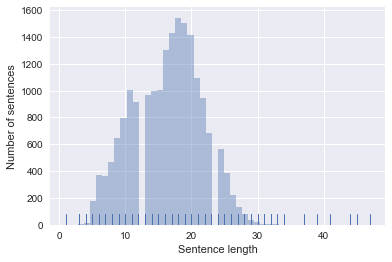

In [46]:
# a simple plot to look into the sentences 

import seaborn as sns
import matplotlib.pyplot as plt

sns.set(color_codes=True)
plt.xlabel('Sentence length')
plt.ylabel('Number of sentences')
sns.distplot(sentence_lengths, kde=False, rug=True)

From here, we know that the length of the tweets are centered around 15 - 20 words. 

## 4 Model Training

### Enbeddings

Next step, we need to encode texts in order to feed them into algorithms. 

Embedding is a representation of the document. It is known as a process of "learning a distributed representation for words". There are different practices, and I'll start from the simplest and the traditional one of BoW, and try other more advanced methods out later.


### 4.1 Bag of Words (BoW)

Bag of words is a model that simply count the number of each word in each sentence, and represent a sentence with the word count. With this model, we will get a very sparse matrix that each row indicate a sentence and columns indicate the whole vocabulary of our dataset. 

In [7]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

def emb(data):
    count_vectorizer = CountVectorizer()
    embedding = count_vectorizer.fit_transform(data)
    return embedding, count_vectorizer


In [8]:
# encode the class lable into 1 and 0 
# Not related or irrelevant = 0 

data['label_binary'] = [0 if x == 'not_related_or_irrelevant' else 1 for x in data.label]
data.head()

,tweet_id,tweet_text,label,event,tokens,label_binary
0,'591902695562170368',rt usrId govt asks media houses to exercise re...,other_useful_information,2015_nepal_eq,"[rt, usrId, govt, asks, media, houses, to, exe...",1
1,'591902695822331904',money news top b urls quake hits nepal cau...,infrastructure_and_utilities_damage,2015_nepal_eq,"[money, news, top, b, urls, quake, hits, nepal...",1
2,'591902695943843840',rt usrId nepalearthquake update the indian a...,injured_or_dead_people,2015_nepal_eq,"[rt, usrId, nepalearthquake, update, the, indi...",1
3,'591902696371724288',rt usrId cnn obtains powerful images of baby r...,missing_trapped_or_found_people,2015_nepal_eq,"[rt, usrId, cnn, obtains, powerful, images, of...",1
4,'591902696375877632',my thoughts and prayers to everyone in urls urls,sympathy_and_emotional_support,2015_nepal_eq,"[my, thoughts, and, prayers, to, everyone, in,...",1


,label_binary,% of Count
1,16767,87.730222
0,2345,12.269778


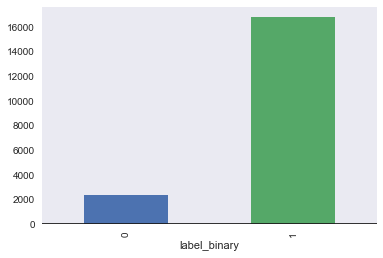

In [49]:
count_table(data, 'label_binary')

As we already seen earlier, this dataset is highly embalanced. I might need to deal with this later.

In [23]:
# seperate train and test

x = data['tweet_text'].tolist()
y = data['label_binary'].tolist()

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=30)

print("length of X_train: %d, X_text: %d, y_train: %d, y_test: %d" % (len(X_train), len(X_test), len(y_train), len(y_test)))


length of X_train: 13378, X_text: 5734, y_train: 13378, y_test: 5734


In [53]:
# apply BoW

X_train_counts, count_vectorizer = emb(X_train)
X_test_counts = count_vectorizer.transform(X_test)

We'd like to visualy inspect this dataset by reducing the dimensionality. Here we apply latent semantic analysis [(LSA)](http://mccormickml.com/2016/03/25/lsa-for-text-classification-tutorial/) which perform linear dimensionality reduction on the text data. 

In [54]:
from sklearn.decomposition import PCA, TruncatedSVD

# reduce the dimensionality 
svd = TruncatedSVD(n_components=2)
svd.fit(X_train_counts)
lsa_bow = svd.transform(X_train_counts)
               
lsa_bow

array([[ 2.50628978, -0.13843315],
       [ 1.74614533, -0.97972996],
       [ 2.62695293,  0.24880873],
       ...,
       [ 2.23457028,  0.59697207],
       [ 1.00646428, -0.46785144],
       [ 2.56440791,  0.24251635]])

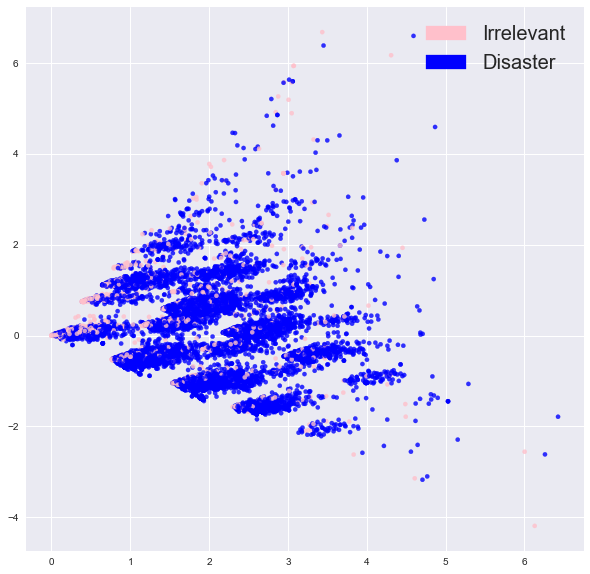

In [56]:
# visualize the word vectors

import matplotlib
import matplotlib.pyplot as plt 
import matplotlib.patches as mpatches

def plot_LSA(y_train, lsa_scores):
        color_mapper = {label:idx for idx, label in enumerate(set(y_train))}
        color_column = [color_mapper[label] for label in y_train]
        colors = ['pink','blue']

        plt.scatter(lsa_scores[:,0], lsa_scores[:,1], s=18, alpha=.8, c=y_train, cmap=matplotlib.colors.ListedColormap(colors))
        red_patch = mpatches.Patch(color='pink', label='Irrelevant')
        green_patch = mpatches.Patch(color='blue', label='Disaster')
        plt.legend(handles=[red_patch, green_patch], prop={'size': 20})

fig = plt.figure(figsize=(10, 10))      
plot_LSA(y_train, lsa_bow)
plt.show()

The enbeddings doesn't look seperable. 

I'd like to take a quick look into how well bag of words perform for this dataset by fitting a simple logistic regression on it. 

In [57]:
# try it out on logistic regression 

from sklearn.linear_model import LogisticRegression

clf = LogisticRegression(C=30.0, class_weight='balanced', solver='newton-cg', multi_class='multinomial', n_jobs=-1, random_state=40)
clf.fit(X_train_counts, y_train)
y_predicted_counts = clf.predict(X_test_counts)


In [30]:
from sklearn import metrics

def metrics_df(y_test, y_predicted):
    
    test_accuracy = metrics.accuracy_score(y_test, y_predicted)
    test_recall = metrics.recall_score(y_test, y_predicted)
    test_precision = metrics.precision_score(y_test, y_predicted)
    test_f1 = metrics.f1_score(y_test, y_predicted)
    
#     train_accuracy_score_list = metrics.accuracy_score(train_Y,train_predictions)
#     train_recall_score_list = []
#     train_precision_score_list = []
#     train_f1_score_list = []
    
    cm = metrics.confusion_matrix(y_test,  y_predicted)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    class_0_accuracy = cm.diagonal()[0]
    class_1_accuracy = cm.diagonal()[1]
    
    results_df = pd.DataFrame(index=['accuracy','recall','precision','f1'])
    results_df['test'] = [test_accuracy, test_recall,
                           test_precision, test_f1]
    results_df['class_0_test'] = [class_0_accuracy,'-','-','-']
    results_df['class_1_test'] = [class_1_accuracy,'-','-','-']
    
    return results_df
    

In [59]:
metrics = metrics_df(y_test, y_predicted_counts)
metrics

,test,class_0_test,class_1_test
accuracy,0.908790,0.659794,0.942235
recall,0.942235,-,-
precision,0.953744,-,-
f1,0.947955,-,-


As we can see, the result is not balanced. I'd like to look furthur into the confusion matrix. 

In [31]:
import numpy as np
import itertools
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.winter):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=30)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, fontsize=20)
    plt.yticks(tick_marks, classes, fontsize=20)
    
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.

    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", 
                 color="white" if cm[i, j] < thresh else "black", fontsize=30)
    
    plt.tight_layout()
    plt.ylabel('True label', fontsize=20)
    plt.xlabel('Predicted label', fontsize=20)

    return plt

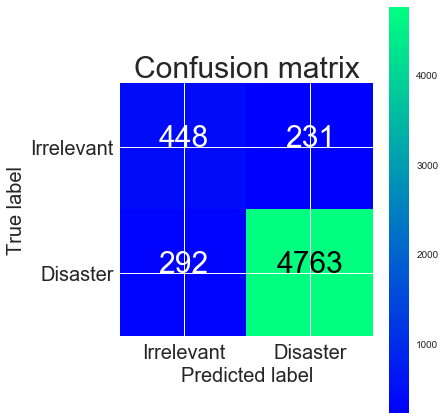

In [61]:
cm = confusion_matrix(y_test, y_predicted_counts)

fig = plt.figure(figsize=(6, 6))
plot = plot_confusion_matrix(cm, classes=['Irrelevant','Disaster'], normalize=False, title='Confusion matrix')
plt.show()

In [62]:
cm_df = pd.DataFrame(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis])
cm_df

,0,1
0,0.659794,0.340206
1,0.057765,0.942235


From the confusion matrix, we can the classifier is doing well in predicting true disaster (94% true positive). 

It's easy to see that about 34% percent of irrelevant events are misclassified into disasters (false positive), and about 5% disasters are misclassified into irrelevant events (false negative). 

Different events here have significant different costs. For example, in the case of an earthquake, misclassifying disaster into irrelevant event could potentially lead to the delay for the government to take actions. I'd really like to see if I could furthur reduce the false negative and false positive. 

### Feature Importance

In [63]:
def get_most_important_features(vectorizer, model, n):
    index_to_word = {v:k for k,v in vectorizer.vocabulary_.items()}
    
    # loop for each class
    classes ={}
    for class_index in range(model.coef_.shape[0]):
        word_importances = [(el, index_to_word[i]) for i,el in enumerate(model.coef_[class_index])]
        sorted_coeff = sorted(word_importances, key = lambda x : x[0], reverse=True)
        tops = sorted(sorted_coeff[:n], key = lambda x : x[0])
        bottom = sorted_coeff[-n:]
        classes[class_index] = {
            'tops':tops,
            'bottom':bottom
        }
    return classes

importance = get_most_important_features(count_vectorizer, clf, 10)
importance

{0: {'bottom': [(-3.5215146310418213, 'came'),
   (-3.542104893489556, 'typhoonhagupitruby'),
   (-3.5461072623797985, 'holy'),
   (-3.588965712385986, 'violence'),
   (-3.9330234827428785, 'newsinsight'),
   (-4.057608265093294, 'applause'),
   (-4.07390855247977, 'xfactornz'),
   (-4.078069475736963, 'wines'),
   (-4.224509986073966, 'pundits'),
   (-4.641712543737067, 'symbls')],
  'tops': [(2.8581353650625636, 'earthquakenepal'),
   (2.899712085671524, 'safe'),
   (2.9383732273876637, 'idea'),
   (3.0522941580823346, 'actforchile'),
   (3.1072045221991433, 'prayforgaza'),
   (3.17300680794238, 'floods'),
   (3.198600192826966, 'affect'),
   (3.313096270810301, 'prayers'),
   (3.4083424319309237, 'woken'),
   (3.5589819017282047, 'magnitude')]}}

In [64]:
top_scores = [a[0] for a in importance[0]['tops']]
top_words = [a[1] for a in importance[0]['tops']]

bottom_scores = [a[0] for a in importance[0]['bottom']]
bottom_words = [a[1] for a in importance[0]['bottom']]

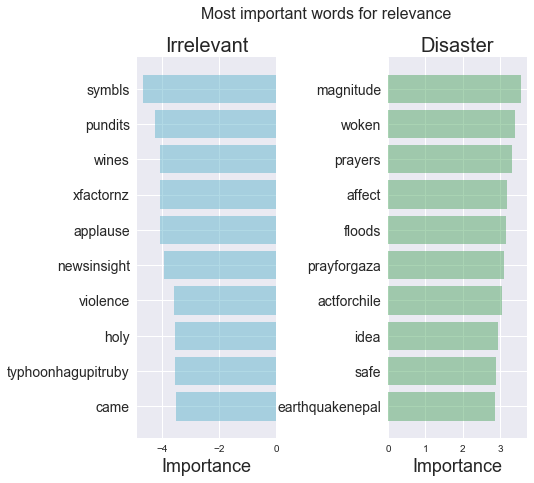

In [65]:
# plot out the importance 

def plot_important_words(top_scores, top_words, bottom_scores, bottom_words, name):
    y_pos = np.arange(len(top_words))
    top_pairs = [(a,b) for a,b in zip(top_words, top_scores)]
    top_pairs = sorted(top_pairs, key=lambda x: x[1])
    
    bottom_pairs = [(a,b) for a,b in zip(bottom_words, bottom_scores)]
    bottom_pairs = sorted(bottom_pairs, key=lambda x: x[1], reverse=True)
    
    top_words = [a[0] for a in top_pairs]
    top_scores = [a[1] for a in top_pairs]
    
    bottom_words = [a[0] for a in bottom_pairs]
    bottom_scores = [a[1] for a in bottom_pairs]
    
    fig = plt.figure(figsize=(7, 7))  

    plt.subplot(121)
    plt.barh(y_pos,bottom_scores, align='center', alpha=0.5, color = 'c')
    plt.title('Irrelevant', fontsize=20)
    plt.yticks(y_pos, bottom_words, fontsize=14)
    plt.suptitle('Key words', fontsize=16)
    plt.xlabel('Importance', fontsize=18)
    
    plt.subplot(122)
    plt.barh(y_pos,top_scores, align='center', alpha=0.5, color = 'g')
    plt.title('Disaster', fontsize=20)
    plt.yticks(y_pos, top_words, fontsize=14)
    plt.suptitle(name, fontsize=16)
    plt.xlabel('Importance', fontsize=18)
    
    plt.subplots_adjust(wspace=0.8)
    plt.show()


plot_important_words(top_scores, top_words, bottom_scores, bottom_words, "Most important words for relevance")

### 4.2 TF-IDF

TFIDF (Term Frequency, Inverse Document Frequency) is a commonly used practice for building word vector based their frequency. Each of the word will be normalized by its frequency in the whole corpus, more frequent words will have less weights since they are being considered addding noise. 

In [66]:
def tfidf(data):
    tfidf_vectorizer = TfidfVectorizer()
    train = tfidf_vectorizer.fit_transform(data)
    return train, tfidf_vectorizer

X_train_tfidf, tfidf_vectorizer = tfidf(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

In [67]:
from sklearn.decomposition import PCA, TruncatedSVD

# reduce the dimensionality 
svd = TruncatedSVD(n_components=2)
svd.fit(X_train_tfidf)
lsa_tfidf = svd.transform(X_train_tfidf)
               
lsa_tfidf

array([[ 0.26180895, -0.00654964],
       [ 0.11814258, -0.01240667],
       [ 0.19638877, -0.03783945],
       ...,
       [ 0.24941679, -0.08558005],
       [ 0.10987018, -0.00948668],
       [ 0.13127314, -0.00737316]])

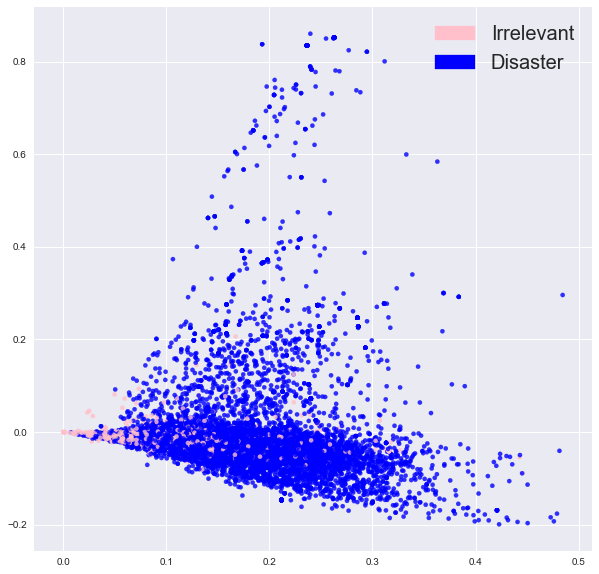

In [69]:
fig = plt.figure(figsize=(10, 10))         
plot_LSA(y_train, lsa_tfidf)
plt.show()

From this graph, we can see that the embedding of tfidf is still not very separable. 

In [70]:
# try it out on logistic regression 

from sklearn.linear_model import LogisticRegression

clf_tfidf = LogisticRegression(C=30.0, class_weight='balanced', solver='newton-cg', multi_class='multinomial', n_jobs=-1, random_state=40)
clf_tfidf.fit(X_train_tfidf, y_train)
y_predicted_tfidf = clf_tfidf.predict(X_test_tfidf)


In [71]:
from sklearn import metrics

def metrics_df(y_test, y_predicted):
    
    test_accuracy = metrics.accuracy_score(y_test, y_predicted)
    test_recall = metrics.recall_score(y_test, y_predicted)
    test_precision = metrics.precision_score(y_test, y_predicted)
    test_f1 = metrics.f1_score(y_test, y_predicted)
    
#     train_accuracy_score_list = metrics.accuracy_score(train_Y,train_predictions)
#     train_recall_score_list = []
#     train_precision_score_list = []
#     train_f1_score_list = []
    
    cm = metrics.confusion_matrix(y_test,  y_predicted)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    class_0_accuracy = cm.diagonal()[0]
    class_1_accuracy = cm.diagonal()[1]
    
    results_df = pd.DataFrame(index=['accuracy','recall','precision','f1'])
    results_df['test'] = [test_accuracy, test_recall,
                           test_precision, test_f1]
    results_df['class_0_test'] = [class_0_accuracy,'-','-','-']
    results_df['class_1_test'] = [class_1_accuracy,'-','-','-']
    
    return results_df
    
metrics_df(y_test, y_predicted_tfidf)

,test,class_0_test,class_1_test
accuracy,0.910882,0.643594,0.946785
recall,0.946785,-,-
precision,0.951870,-,-
f1,0.949321,-,-


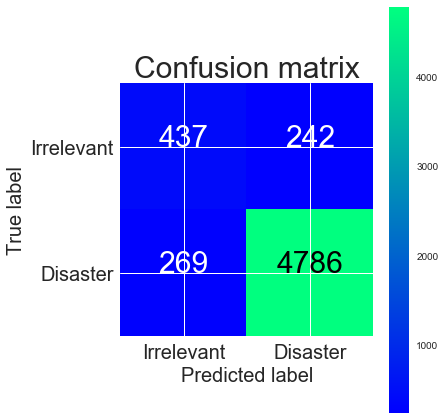

TFIDF confusion matrix
[[ 437  242]
 [ 269 4786]]
BoW confusion matrix
[[ 448  231]
 [ 292 4763]]


In [72]:
cm_tfidf = confusion_matrix(y_test, y_predicted_tfidf)

fig = plt.figure(figsize=(6, 6))
plot = plot_confusion_matrix(cm_tfidf, classes=['Irrelevant','Disaster'], normalize=False, title='Confusion matrix')
plt.show()
print("TFIDF confusion matrix")
print(cm_tfidf)

print("BoW confusion matrix")
print(cm)

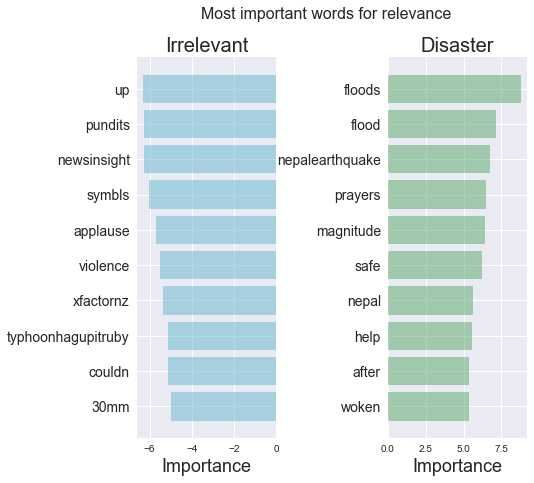

In [73]:
importance_tfidf = get_most_important_features(tfidf_vectorizer, clf_tfidf, 10)

top_scores = [a[0] for a in importance_tfidf[0]['tops']]
top_words = [a[1] for a in importance_tfidf[0]['tops']]
bottom_scores = [a[0] for a in importance_tfidf[0]['bottom']]
bottom_words = [a[1] for a in importance_tfidf[0]['bottom']]

plot_important_words(top_scores, top_words, bottom_scores, bottom_words, "Most important words for relevance")

From confusion metric and feature importance, I don't see much improvement with TFIDF than BoW. In addition, the model could be a bit overfitting since there are more noise in this graph.

### 4.3 Word2vec

BoW and TFIDF are based on word frequency, and both don't take consideration of semantic meaning of the words. Another embedding model that captures semantic is [Word2vec](https://code.google.com/archive/p/word2vec/) released by Google. It is a pre-trained model that measure semantic by comparing the distance between words, and contains 300 dimensional vectors for 3 million words and phrases. 

Note: since this is a very large model, it is recommend to train it with 64-bit Python.


In [74]:
# load the pre-trained model 
import gensim

# Load Google's pre-trained Word2Vec model.
word2vec_path = "word2vec/GoogleNews-vectors-negative300.bin"
word2vec = gensim.models.KeyedVectors.load_word2vec_format(word2vec_path, binary=True)  

In [20]:
# get sentence embeddings by averaging average word2vec score
import numpy as np

def get_average_word2vec(tokens_list, vector, generate_missing=False, k=300):
    if len(tokens_list)<1:
        return np.zeros(k)
    if generate_missing:
        vectorized = [vector[word] if word in vector else np.random.rand(k) for word in tokens_list]
    else:
        vectorized = [vector[word] if word in vector else np.zeros(k) for word in tokens_list]
        
    length = len(vectorized)
    summed = np.sum(vectorized, axis=0)
    averaged = np.divide(summed, length)
    return averaged


In [21]:
def get_word2vec_embeddings(vectors, data, generate_missing=False):
    embeddings = data['tokens'].apply(lambda x: get_average_word2vec(x, vectors, generate_missing=generate_missing))
    return list(embeddings)

In [76]:
embeddings = get_word2vec_embeddings(word2vec, data)
embeddings = np.array(embeddings)
X_train_word2vec, X_test_word2vec, y_train_word2vec, y_test_word2vec = train_test_split(embeddings, y, test_size=0.3, random_state=40)

print("length of X_train: %d, X_text: %d, y_train: %d, y_test: %d" % (len(X_train_word2vec), len(X_test_word2vec), len(y_train_word2vec), len(y_test_word2vec)))

length of X_train: 13378, X_text: 5734, y_train: 13378, y_test: 5734


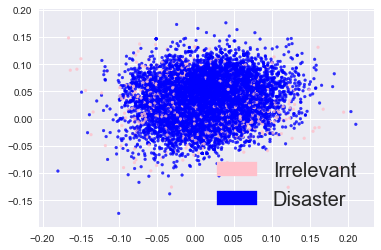

In [77]:
color_mapper = {label:idx for idx, label in enumerate(set(y))}
color_column = [color_mapper[label] for label in y]
colors = ['pink','blue']

plt.scatter(embeddings[:,0], embeddings[:,1], s=8, alpha=.8, c=y, cmap=matplotlib.colors.ListedColormap(colors))
red_patch = mpatches.Patch(color='pink', label='Irrelevant')
green_patch = mpatches.Patch(color='blue', label='Disaster')
plt.legend(handles=[red_patch, green_patch], prop={'size': 20})


fig = plt.figure(figsize=(15, 15))      
plt.show()

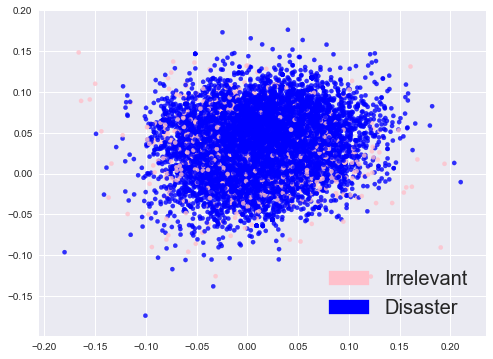

In [78]:
fig = plt.figure(figsize=(8, 6))         
plot_LSA(y, embeddings)
plt.show()

In [79]:
clf_w2v = LogisticRegression(C=30.0, class_weight='balanced', solver='newton-cg', 
                         multi_class='multinomial', random_state=40)
clf_w2v.fit(X_train_word2vec, y_train_word2vec)
y_predicted_word2vec = clf_w2v.predict(X_test_word2vec)

In [81]:
metrics_df(y_test_word2vec, y_predicted_word2vec)

,test,class_0_test,class_1_test
accuracy,0.841821,0.821879,0.844652
recall,0.844652,-,-
precision,0.970925,-,-
f1,0.903398,-,-


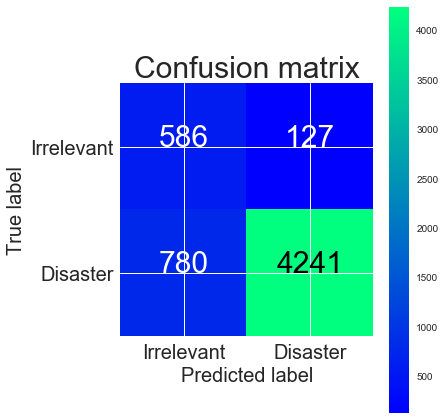

In [82]:
cm_w2v = confusion_matrix(y_test_word2vec, y_predicted_word2vec)

fig = plt.figure(figsize=(6, 6))
plot = plot_confusion_matrix(cm_w2v, classes=['Irrelevant','Disaster'], normalize=False, title='Confusion matrix')
plt.show()

In [83]:
print("Word2Vec confusion matrix")
print(cm_w2v)
print("TFIDF confusion matrix")
print(cm_tfidf)
print("BoW confusion matrix")
print(cm)

Word2Vec confusion matrix
[[ 586  127]
 [ 780 4241]]
TFIDF confusion matrix
[[ 437  242]
 [ 269 4786]]
BoW confusion matrix
[[ 448  231]
 [ 292 4763]]


### LIME to interpret word2vec

In [84]:
from lime import lime_text
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer

X_train_data, X_test_data, y_train_data, y_test_data = train_test_split(x, y, test_size=0.2, 
                                                                                random_state=40)
vector_store = word2vec

In [85]:
def word2vec_pipeline(examples):
    global vector_store
    tokenizer = RegexpTokenizer(r'\w+')
    tokenized_list = []
    for example in examples:
        example_tokens = tokenizer.tokenize(example)
        vectorized_example = get_average_word2vec(example_tokens, vector_store, generate_missing=False, k=300)
        tokenized_list.append(vectorized_example)
    return clf_w2v.predict_proba(tokenized_list)

c = make_pipeline(count_vectorizer, clf)

In [86]:
def explain_one_instance(instance, class_names):
    explainer = LimeTextExplainer(class_names=class_names)
    exp = explainer.explain_instance(instance, word2vec_pipeline, num_features=6)
    return exp

def visualize_one_exp(features, labels, index, class_names = ["irrelevant","relevant", "unknown"]):
    exp = explain_one_instance(features[index], class_names = class_names)
    print('Index: %d' % index)
    print('True class: %s' % class_names[labels[index]])
    exp.show_in_notebook(text=True)

In [87]:
visualize_one_exp(X_test_data, y_test_data, 65)

/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Index: 65
True class: relevant


In [88]:
visualize_one_exp(X_test_data, y_test_data, 60)

/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Index: 60
True class: relevant


In [89]:
import random
from collections import defaultdict

random.seed(40)

def get_statistical_explanation(test_set, sample_size, word2vec_pipeline, label_dict):
    sample_sentences = random.sample(test_set, sample_size)
    explainer = LimeTextExplainer()
    
    labels_to_sentences = defaultdict(list)
    contributors = defaultdict(dict)
    
    # First, find contributing words to each class
    for sentence in sample_sentences:
        probabilities = word2vec_pipeline([sentence])
        curr_label = probabilities[0].argmax()
        labels_to_sentences[curr_label].append(sentence)
        exp = explainer.explain_instance(sentence, word2vec_pipeline, num_features=6, labels=[curr_label])
        listed_explanation = exp.as_list(label=curr_label)
        
        for word,contributing_weight in listed_explanation:
            if word in contributors[curr_label]:
                contributors[curr_label][word].append(contributing_weight)
            else:
                contributors[curr_label][word] = [contributing_weight]    
    
    # average each word's contribution to a class, and sort them by impact
    average_contributions = {}
    sorted_contributions = {}
    for label,lexica in contributors.items():
        curr_label = label
        curr_lexica = lexica
        average_contributions[curr_label] = pd.Series(index=curr_lexica.keys())
        for word,scores in curr_lexica.items():
            average_contributions[curr_label].loc[word] = np.sum(np.array(scores))/sample_size
        detractors = average_contributions[curr_label].sort_values()
        supporters = average_contributions[curr_label].sort_values(ascending=False)
        sorted_contributions[label_dict[curr_label]] = {
            'detractors':detractors,
             'supporters': supporters
        }
    return sorted_contributions



In [90]:
label_to_text = {
    0: 'Irrelevant',
    1: 'Relevant'
}
sorted_contributions = get_statistical_explanation(X_test_data, 100, word2vec_pipeline, label_to_text)

/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pa

/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
/anaconda3/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pa

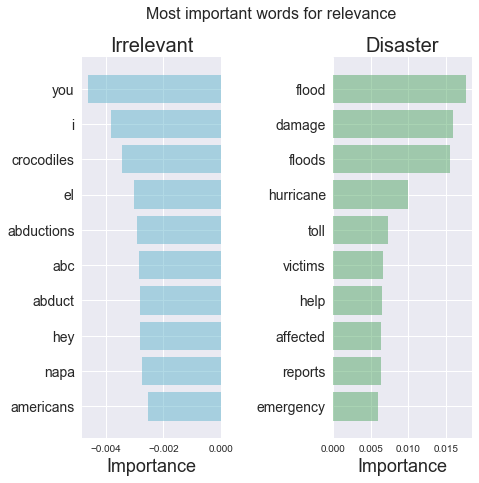

In [91]:
# First index is the class (Disaster)
# Second index is 0 for detractors, 1 for supporters
# Third is how many words we sample
top_words = sorted_contributions['Relevant']['supporters'][:10].index.tolist()
top_scores = sorted_contributions['Relevant']['supporters'][:10].tolist()
bottom_words = sorted_contributions['Relevant']['detractors'][:10].index.tolist()
bottom_scores = sorted_contributions['Relevant']['detractors'][:10].tolist()

plot_important_words(top_scores, top_words, bottom_scores, bottom_words, "Most important words for relevance")

Another word2vec model I'd like to try is the CrisisNLP Word2vec Model (V1.2). It's trained specially on crisis tweets and consists of a vocabulary with size 7976291 (~7 million) and 300 dimensional vector (large too). 

In [12]:
# load the pre-trained model 
import gensim

crisis_path = 'word2vec/crisisNLP_word2vec_model/crisisNLP_word_vector.bin'
crisis = gensim.models.KeyedVectors.load_word2vec_format(crisis_path, binary=True)
words=crisis.most_similar(positive=['shelter'], negative=[], topn=10)


/anaconda3/lib/python3.6/site-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


In [24]:
embeddings = get_word2vec_embeddings(crisis, data)
embeddings = np.array(embeddings)
X_train_word2vecc, X_test_word2vecc, y_train_word2vecc, y_test_word2vecc = train_test_split(embeddings, y, test_size=0.3, random_state=40)

print("length of X_train: %d, X_text: %d, y_train: %d, y_test: %d" % (len(X_train_word2vecc), len(X_test_word2vecc), len(y_train_word2vecc), len(y_test_word2vecc)))

length of X_train: 13378, X_text: 5734, y_train: 13378, y_test: 5734


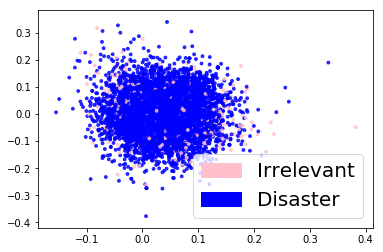

In [27]:
import matplotlib
import matplotlib.pyplot as plt 
import matplotlib.patches as mpatches

color_mapper = {label:idx for idx, label in enumerate(set(y))}
color_column = [color_mapper[label] for label in y]
colors = ['pink','blue']

plt.scatter(embeddings[:,0], embeddings[:,1], s=8, alpha=.8, c=y, cmap=matplotlib.colors.ListedColormap(colors))
red_patch = mpatches.Patch(color='pink', label='Irrelevant')
green_patch = mpatches.Patch(color='blue', label='Disaster')
plt.legend(handles=[red_patch, green_patch], prop={'size': 20})


fig = plt.figure(figsize=(15, 15))      
plt.show()

In [28]:
# try it out on logistic regression 

from sklearn.linear_model import LogisticRegression

clf_crisis = LogisticRegression(C=30.0, class_weight='balanced', solver='newton-cg', multi_class='multinomial', n_jobs=-1, random_state=40)
clf_crisis.fit(X_train_word2vecc, y_train_word2vecc)
y_predicted_w2cc = clf_crisis.predict(X_test_word2vecc)


In [32]:
metrics_df(y_test_word2vecc, y_predicted_w2cc)

,test,class_0_test,class_1_test
accuracy,0.843565,0.834502,0.844852
recall,0.844852,-,-
precision,0.972936,-,-
f1,0.904381,-,-


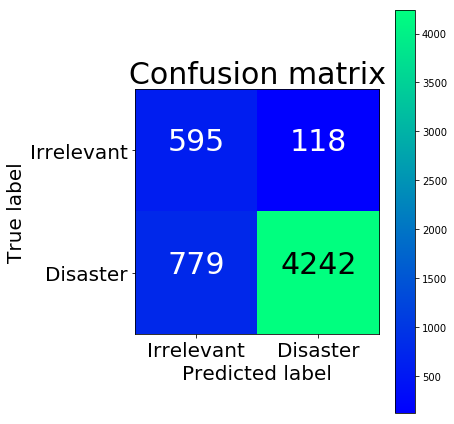

In [33]:
cm = confusion_matrix(y_test_word2vecc, y_predicted_w2cc)

fig = plt.figure(figsize=(6, 6))
plot = plot_confusion_matrix(cm, classes=['Irrelevant','Disaster'], normalize=False, title='Confusion matrix')
plt.show()

## 5 Neural Nets Models

### 5.1 CNNs 

I'd like to try some deep learning models to capture sentence structures. Here, I used a simple CNN framework

In [10]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical

EMBEDDING_DIM = 300
MAX_SEQUENCE_LENGTH = 35
VOCAB_SIZE = len(vocab)

VALIDATION_SPLIT=.2
tokenizer = Tokenizer(num_words=VOCAB_SIZE)
tokenizer.fit_on_texts(data['tweet_text'].tolist())
sequences = tokenizer.texts_to_sequences(data["tweet_text"].tolist())

word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))


Found 20236 unique tokens.


In [14]:
cnn_data = pad_sequences(sequences, maxlen=MAX_SEQUENCE_LENGTH)
labels = to_categorical(np.asarray(data['label_binary']))

indices = np.arange(cnn_data.shape[0])
np.random.shuffle(indices)
cnn_data = cnn_data[indices]
labels = labels[indices]
num_validation_samples = int(VALIDATION_SPLIT * cnn_data.shape[0])

embedding_weights = np.zeros((len(word_index)+1, EMBEDDING_DIM))
for word,index in word_index.items():
    embedding_weights[index,:] = crisis[word] if word in crisis else np.random.rand(EMBEDDING_DIM)

print(embedding_weights.shape)

(20237, 300)


In [15]:
from keras.layers import Dense, Input, Flatten, Dropout, Concatenate
from keras.layers import Conv1D, MaxPooling1D, Embedding
from keras.layers import LSTM, Bidirectional
from keras.models import Model

def ConvNet(embeddings, max_sequence_length, num_words, embedding_dim, labels_index, trainable=False, extra_conv=True):
    
    embedding_layer = Embedding(num_words,
                            embedding_dim,
                            weights=[embeddings],
                            input_length=max_sequence_length,
                            trainable=trainable)

    sequence_input = Input(shape=(max_sequence_length,), dtype='int32')
    embedded_sequences = embedding_layer(sequence_input)

    # Yoon Kim model (https://arxiv.org/abs/1408.5882)
    convs = []
    filter_sizes = [3,4,5]

    for filter_size in filter_sizes:
        l_conv = Conv1D(filters=128, kernel_size=filter_size, activation='relu')(embedded_sequences)
        l_pool = MaxPooling1D(pool_size=3)(l_conv)
        convs.append(l_pool)

    l_merge = Concatenate(axis=1)(convs)

    # add a 1D convnet with global maxpooling, instead of Yoon Kim model
    conv = Conv1D(filters=128, kernel_size=3, activation='relu')(embedded_sequences)
    pool = MaxPooling1D(pool_size=3)(conv)

    if extra_conv==True:
        x = Dropout(0.5)(l_merge)  
    else:
        # Original Yoon Kim model
        x = Dropout(0.5)(pool)
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    #x = Dropout(0.5)(x)

    preds = Dense(labels_index, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer='adam',
                  metrics=['acc'])

    return model

In [16]:
x_train = cnn_data[:-num_validation_samples]
y_train = labels[:-num_validation_samples]
x_val = cnn_data[-num_validation_samples:]
y_val = labels[-num_validation_samples:]

model = ConvNet(embedding_weights, MAX_SEQUENCE_LENGTH, len(word_index)+1, EMBEDDING_DIM, 
                len(list(data['label_binary'].unique())), False)

In [18]:
model.fit(x_train, y_train, validation_data=(x_val, y_val), epochs=3, batch_size=128)

Train on 15290 samples, validate on 3822 samples
Epoch 1/3
15290/15290 [==============================] - 34s 2ms/step - loss: 0.2888 - acc: 0.8878 - val_loss: 0.2185 - val_acc: 0.9270
Epoch 2/3
15290/15290 [==============================] - 33s 2ms/step - loss: 0.2133 - acc: 0.9235 - val_loss: 0.1889 - val_acc: 0.9377
Epoch 3/3
15290/15290 [==============================] - 34s 2ms/step - loss: 0.1892 - acc: 0.9311 - val_loss: 0.1934 - val_acc: 0.9304


## Reference:

1. [Crisis NLP](http://crisisnlp.qcri.org/lrec2016/lrec2016.html)
2. [Natural Language Processing with Python](http://www.nltk.org/book)
4. [tweetNLP](http://www.ark.cs.cmu.edu/TweetNLP)
5. [3 silver bullets of word embeddings in NLP](https://towardsdatascience.com/3-silver-bullets-of-word-embedding-in-nlp-10fa8f50cc5a)
6. [Word2vec](https://code.google.com/archive/p/word2vec/)
7. [Google's trained Word2Vec model in Python](http://mccormickml.com/2016/04/12/googles-pretrained-word2vec-model-in-python/)
8. [An NLP workshop by Emmanuel Ameisen](https://github.com/hundredblocks/concrete_NLP_tutorial/blob/master/NLP_notebook.ipynb)